In [1]:
import matplotlib.pyplot as plt
from tensorflow import keras
import tensorflow as tf
import yfinance as yf
import pandas as pd
import numpy as np

assets = ["NFLX"]
start_date = "2010-01-01"
end_date = "2023-11-30"

data = yf.download(assets, start=start_date, end=end_date)

[*********************100%%**********************]  1 of 1 completed


# Preprocessing

In [2]:
data = data.ffill()
data_normalized = (data - data.min()) / (data.max() - data.min())
train_data = data_normalized

In [3]:
train_data.shape

(3501, 6)

In [4]:
train_data.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-01-04,0.001417,0.001128,0.000934,0.000908,0.000908,0.051195
2010-01-05,0.001011,0.000690,0.000482,0.000497,0.000497,0.071912
2010-01-06,0.000586,0.000712,0.000391,0.000874,0.000874,0.070441
2010-01-07,0.001126,0.000834,0.000782,0.000682,0.000682,0.028026
2010-01-08,0.000786,0.000813,0.000787,0.000870,0.000870,0.022382


In [9]:
def create_model(
    latent_dims=16, loss="mean_squared_error", optimizer="adam", input_dim=6
):
    input = keras.layers.Input(shape=(input_dim,))
    # encoder
    x = keras.layers.Dense(128, activation="relu")(input)
    x = keras.layers.Dense(64, activation="relu")(x)
    x = keras.layers.Dense(32, activation="relu")(x)
    # latent space
    latent = keras.layers.Dense(latent_dims, activation="relu")(x)
    # decoder
    x = keras.layers.Dense(32, activation="relu")(latent)
    x = keras.layers.Dense(64, activation="relu")(x)
    x = keras.layers.Dense(128, activation="relu")(x)
    output = keras.layers.Dense(input_dim, activation="tanh")(x)

    model = keras.Model(input, output)
    keras.backend.clear_session()

    model.compile(optimizer=optimizer, loss=loss)
    return model

In [32]:
def evaluate(model, train_data):
    reconstructed_data = model.predict(train_data)
    reconstruction_errors = np.mean(np.square(reconstructed_data - train_data), axis=1)

    threshold = np.mean(reconstruction_errors) + 2 * np.std(reconstruction_errors)

    fig, ax = plt.subplots(figsize=(5, 3))

    plt.plot(reconstruction_errors)
    ax.axhline(y=threshold, color="red", linestyle="--", label="Threshold")
    plt.xlabel("Time")
    plt.ylabel("Reconstruction Error")
    plt.title("Anomaly Detection with Threshold")
    plt.legend()


def plot_examples(train_data, reconstructed_data):

    stock_decoded = reconstructed_data[:, 3]
    stock_input = train_data.values[:, 3]

    stock_windows = []
    decoded_windows = []
    for _ in range(10):
        start = np.random.randint(0, len(stock_input) - 200)
        window = stock_input[start : start + 200]
        stock_windows.append(window)
        window = stock_decoded[start : start + 200]
        decoded_windows.append(window)

    # plot the stock data and stock decoded data
    # create subplots

    plt.figure(figsize=(10, 30))

    for i in range(10):
        plt.subplot(10, 2, i + 1)
        plt.plot(stock_windows[i], label="Stock Data")
        plt.plot(decoded_windows[i], label="Decoded Data")
        plt.title("Example " + str(i + 1))
        plt.legend()

In [38]:
epochs = [100, 200, 300]
latent_dims = [1, 2, 4, 8, 16]
optimizers = [
            [keras.optimizers.legacy.Adam(),"Adam"],
            [keras.optimizers.legacy.SGD(learning_rate=0.01, momentum=0.9, nesterov=True),"SGD, lr=0.01, momentum=0.9, nesterov=True"],
            [keras.optimizers.legacy.RMSprop(learning_rate=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False),"RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False"],
            [keras.optimizers.legacy.Adadelta(learning_rate=0.01, rho=0.95, epsilon=1e-06),"Adadelta, lr=0.01, rho=0.95, epsilon=1e-06"],
            [keras.optimizers.legacy.Adagrad(learning_rate=0.01, initial_accumulator_value=0.1, epsilon=1e-07),"Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07"],
        ]

Epochs: 100 Latent Dim: 1 Optimizer: Adam
Epoch 1/100
110/110 [==============================] - 1s 1ms/step - loss: 0.0700
Epoch 2/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 3/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 4/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 5/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0581
Epoch 6/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 7/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 8/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 9/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 10/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 12/100
110/110 [==============================] 

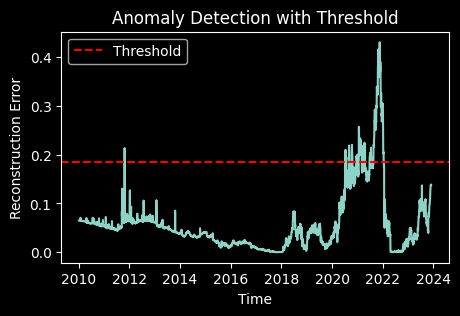

110/110 [==============================] - 0s 976us/step


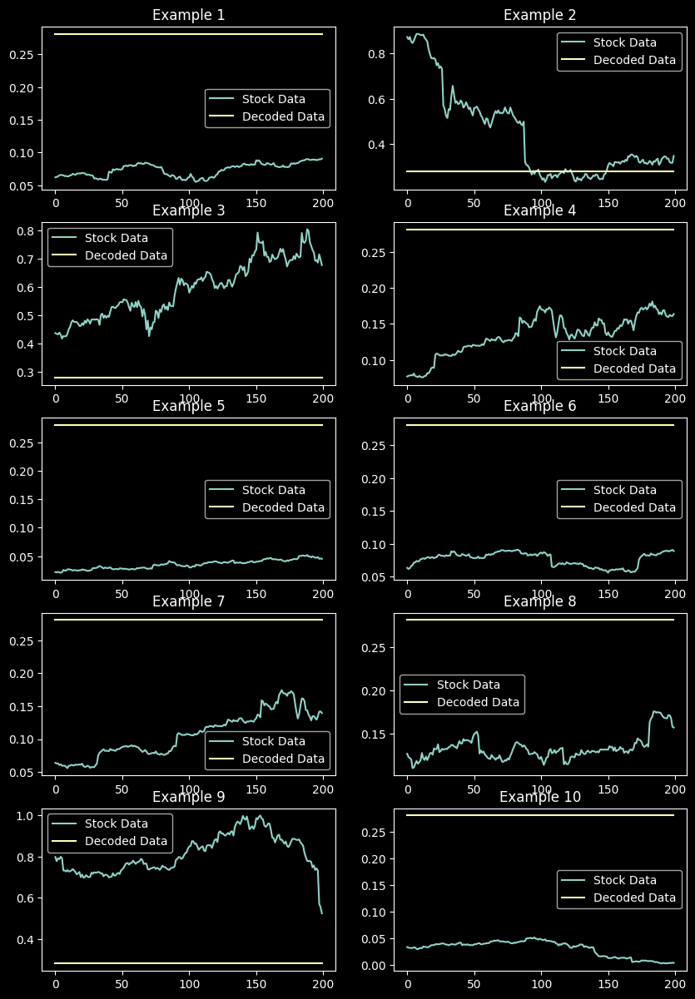

Epochs: 200 Latent Dim: 1 Optimizer: Adam
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0058
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 5.9004e-04
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 3.9199e-04
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 2.5583e-04
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 2.1653e-04
Epoch 6/200
110/110 [==============================] - 0s 2ms/step - loss: 1.9069e-04
Epoch 7/200
110/110 [==============================] - 0s 2ms/step - loss: 1.8388e-04
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 1.6929e-04
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 1.6534e-04
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 1.5872e-04
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - loss: 1.5198e-04
Epoch 12/200
1

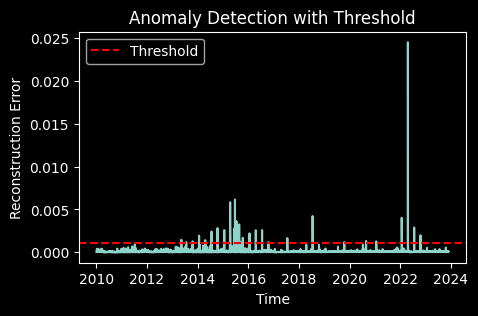

110/110 [==============================] - 0s 873us/step


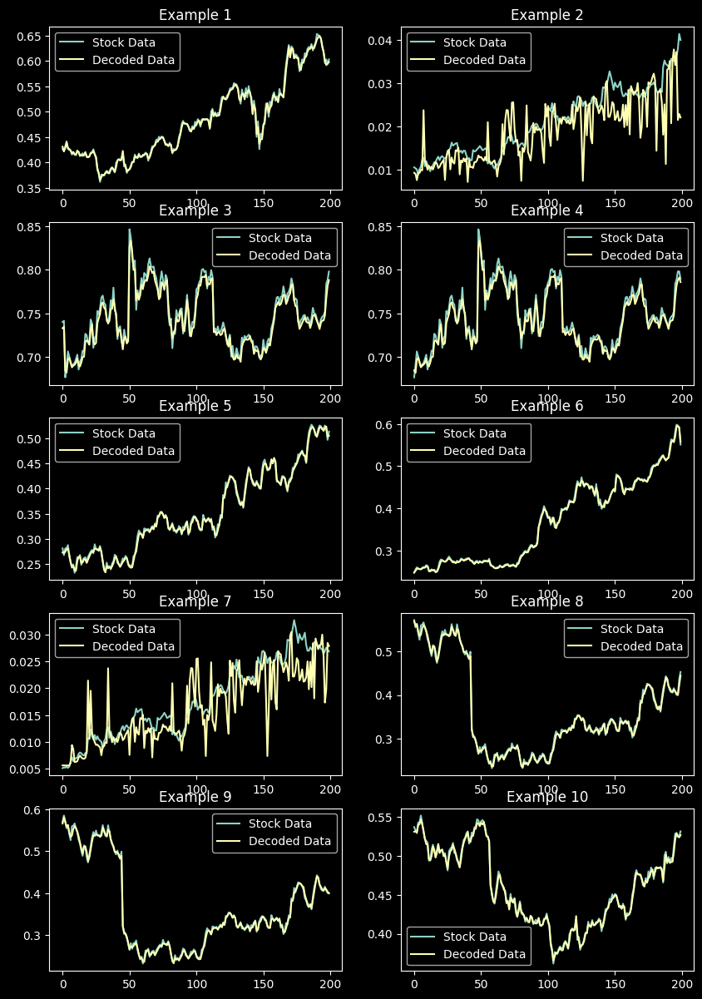

Epochs: 300 Latent Dim: 1 Optimizer: Adam
Epoch 1/300
110/110 [==============================] - 1s 1ms/step - loss: 0.0699
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 4/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0581
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 7/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0581
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 9/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 12/300
110/110 [==============================] 

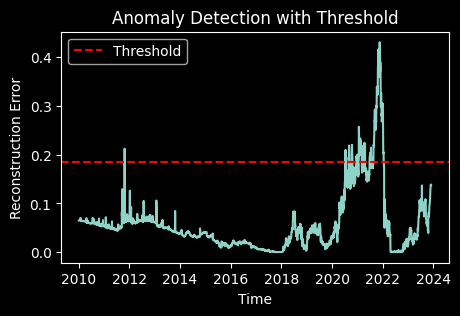

110/110 [==============================] - 0s 1ms/step


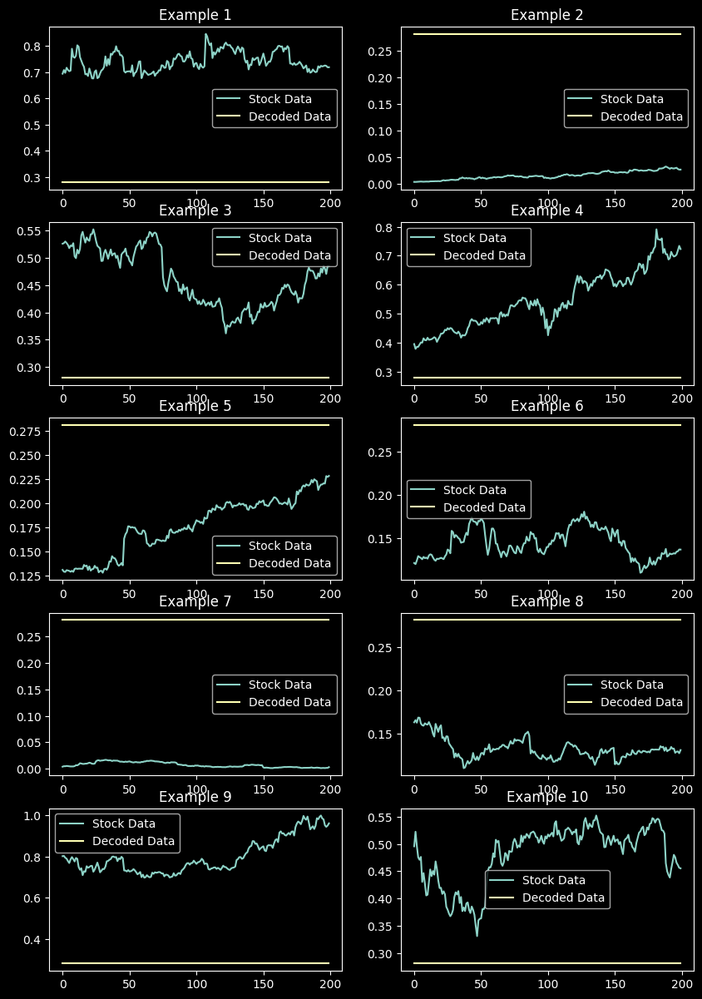

Epochs: 100 Latent Dim: 2 Optimizer: Adam
Epoch 1/100
110/110 [==============================] - 1s 2ms/step - loss: 0.0622
Epoch 2/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0584
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0584
Epoch 4/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0584
Epoch 5/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0584
Epoch 6/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0583
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0583
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0583
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 11/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 12/100
110/110 [==============================] 

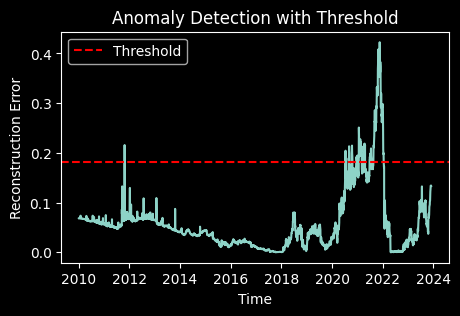

110/110 [==============================] - 0s 1ms/step


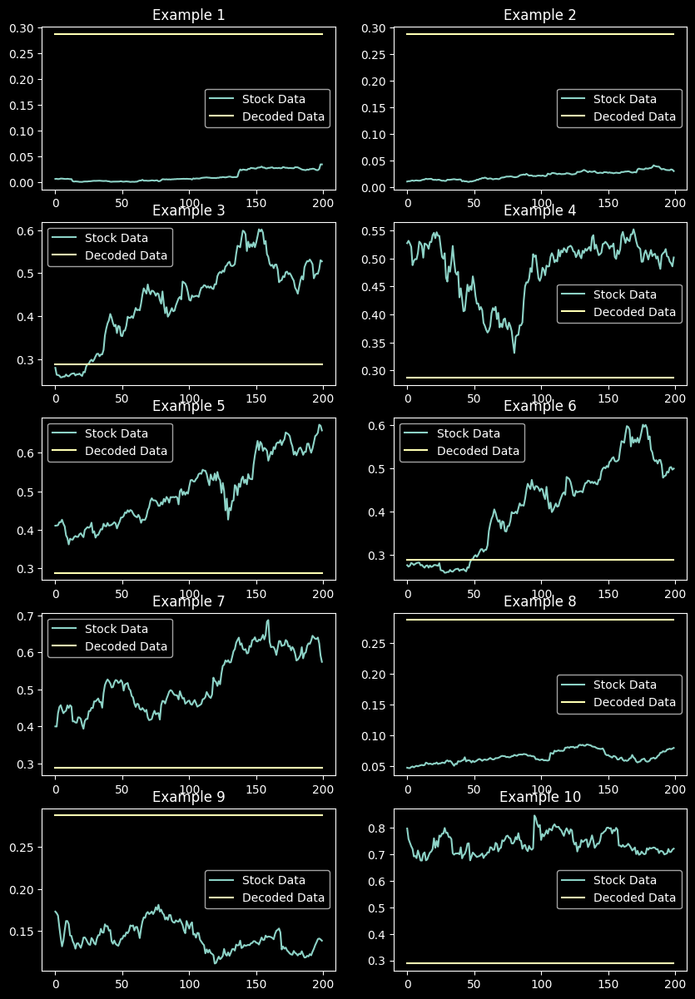

Epochs: 200 Latent Dim: 2 Optimizer: Adam
Epoch 1/200
110/110 [==============================] - 1s 2ms/step - loss: 0.0620
Epoch 2/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0585
Epoch 3/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0583
Epoch 4/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0581
Epoch 5/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 6/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0584
Epoch 7/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 8/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 9/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 10/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 11/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 12/200
110/110 [==============================] 

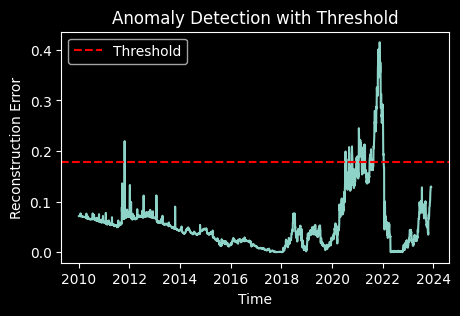

110/110 [==============================] - 0s 919us/step


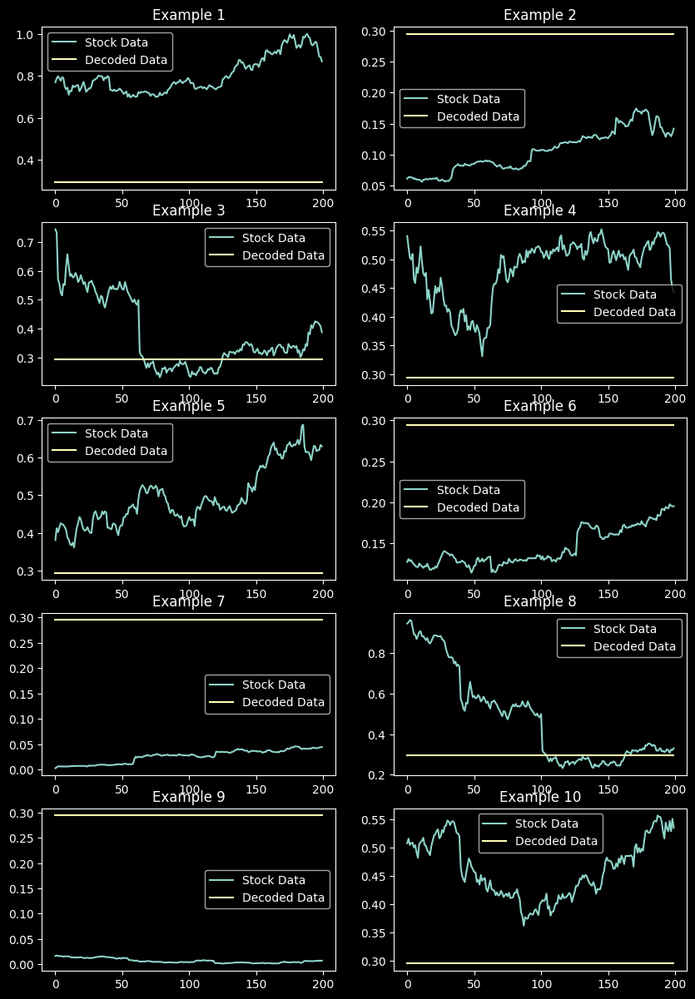

Epochs: 300 Latent Dim: 2 Optimizer: Adam
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.0066
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 4.6320e-04
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 2.4077e-04
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 1.1499e-04
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 7.7929e-05
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 6.0208e-05
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 4.5562e-05
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 4.2639e-05
Epoch 9/300
110/110 [==============================] - 0s 1ms/step - loss: 3.8410e-05
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 3.4042e-05
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - loss: 2.9684e-05
Epoch 12/300
1

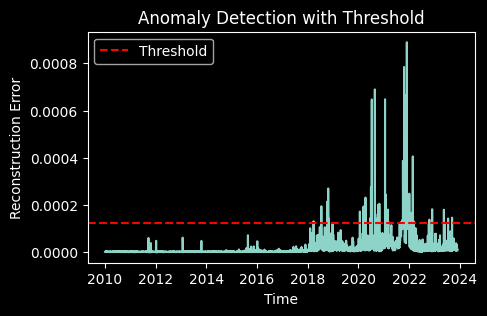

110/110 [==============================] - 0s 889us/step


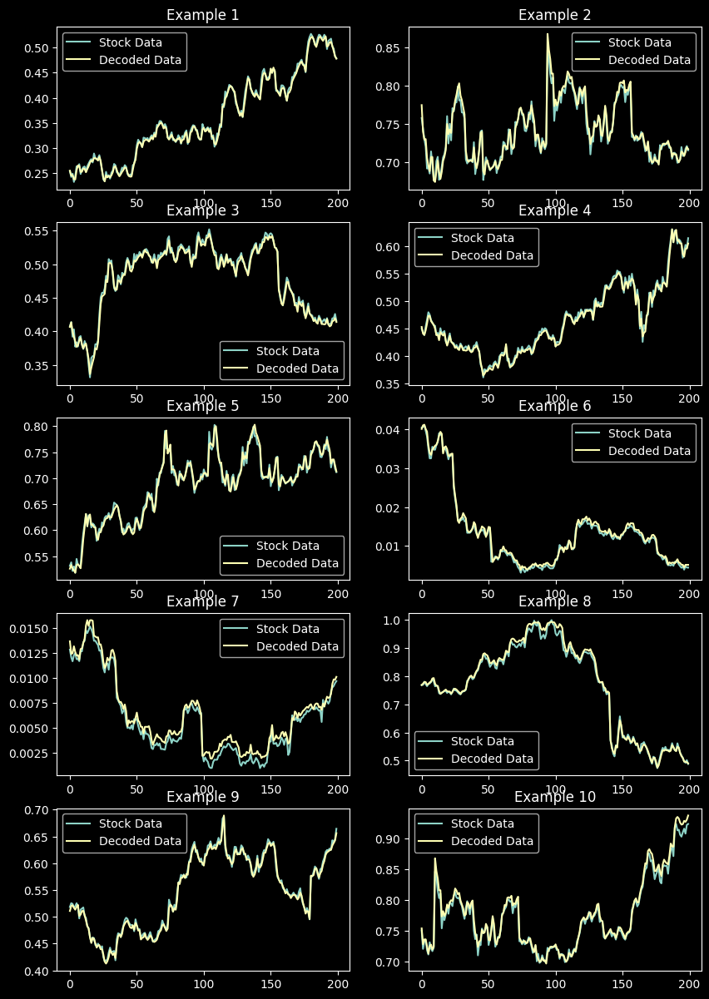

Epochs: 100 Latent Dim: 4 Optimizer: Adam
Epoch 1/100
110/110 [==============================] - 1s 1ms/step - loss: 0.0075
Epoch 2/100
110/110 [==============================] - 0s 1ms/step - loss: 3.8603e-04
Epoch 3/100
110/110 [==============================] - 0s 1ms/step - loss: 2.6440e-04
Epoch 4/100
110/110 [==============================] - 0s 2ms/step - loss: 2.2940e-04
Epoch 5/100
110/110 [==============================] - 0s 2ms/step - loss: 2.0885e-04
Epoch 6/100
110/110 [==============================] - 0s 2ms/step - loss: 1.8864e-04
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 1.6971e-04
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 1.4552e-04
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 1.0787e-04
Epoch 10/100
110/110 [==============================] - 0s 1ms/step - loss: 7.4204e-05
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - loss: 5.6673e-05
Epoch 12/100
1

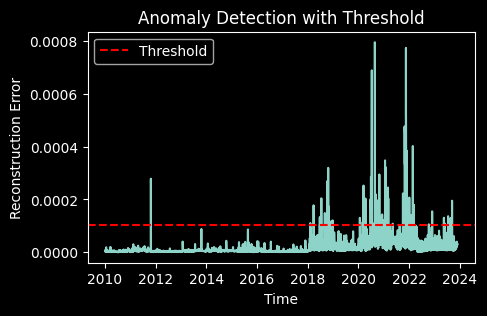

110/110 [==============================] - 0s 908us/step


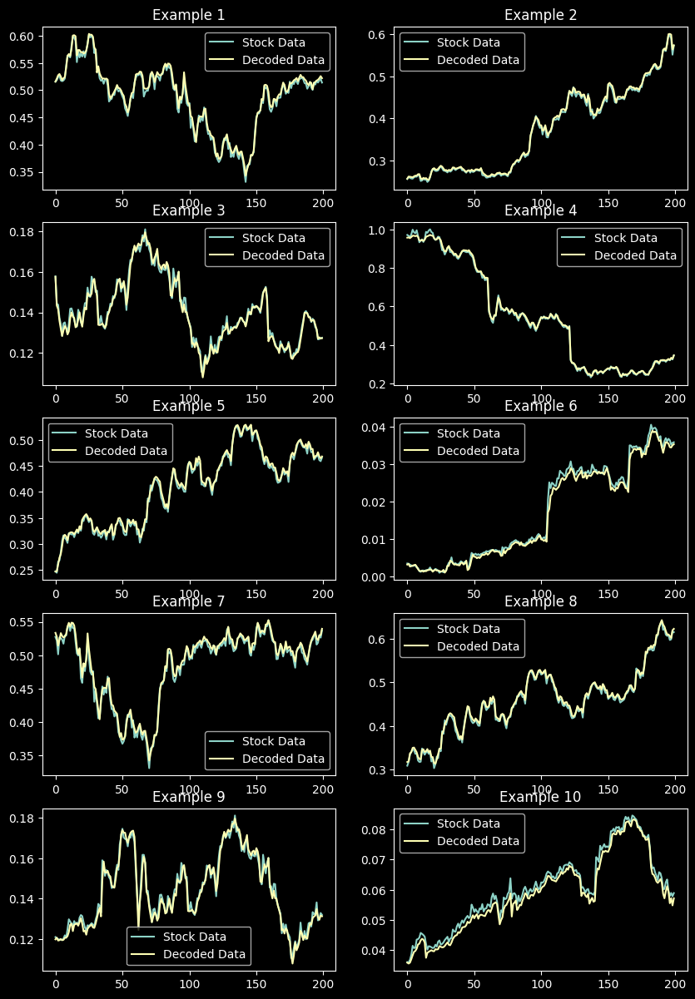

Epochs: 200 Latent Dim: 4 Optimizer: Adam
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0063
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 4.0638e-04
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 2.7948e-04
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 2.3666e-04
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 2.1053e-04
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 1.8626e-04
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 1.7302e-04
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 1.6919e-04
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 1.6657e-04
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 1.7304e-04
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - loss: 1.4239e-04
Epoch 12/200
1

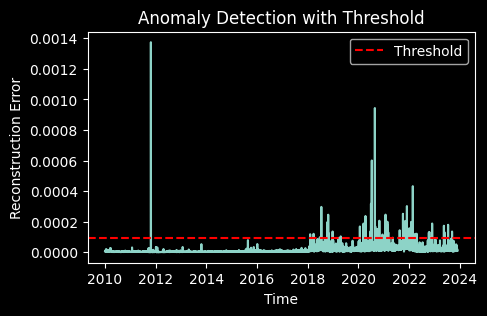

110/110 [==============================] - 0s 1ms/step


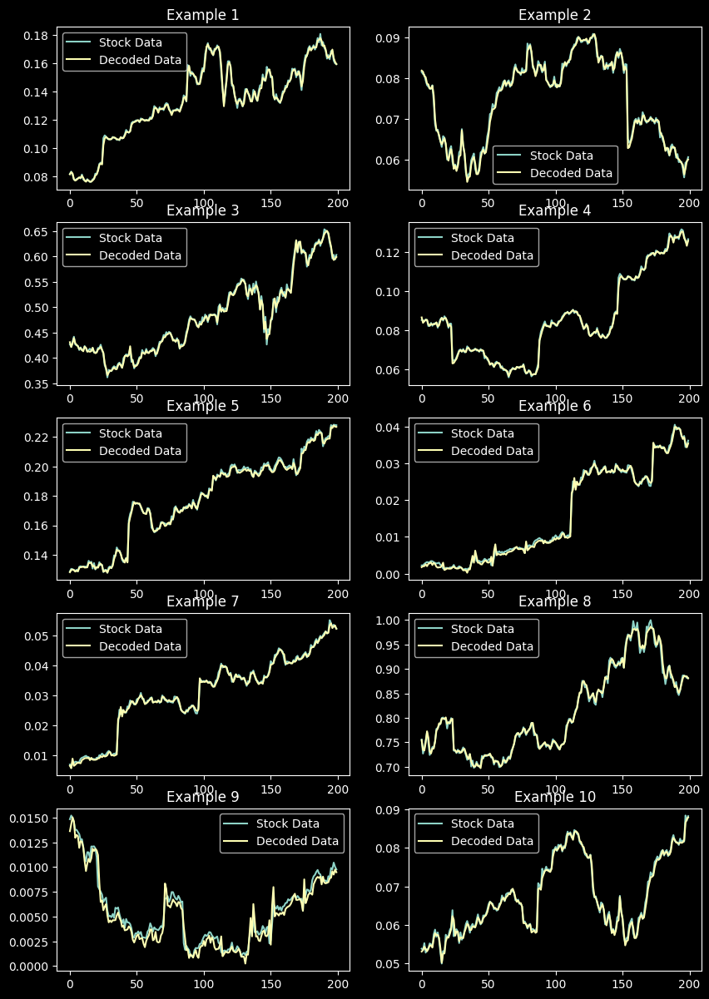

Epochs: 300 Latent Dim: 4 Optimizer: Adam
Epoch 1/300
110/110 [==============================] - 1s 1ms/step - loss: 0.0056
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 4.0608e-04
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 2.8170e-04
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 2.4503e-04
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 2.2359e-04
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 2.0291e-04
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 1.8813e-04
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 1.7868e-04
Epoch 9/300
110/110 [==============================] - 0s 1ms/step - loss: 1.7149e-04
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 1.7385e-04
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - loss: 1.5757e-04
Epoch 12/300
1

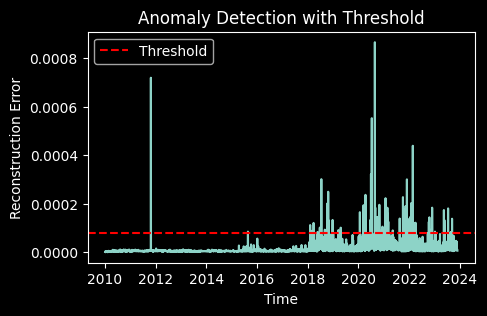

110/110 [==============================] - 0s 1ms/step


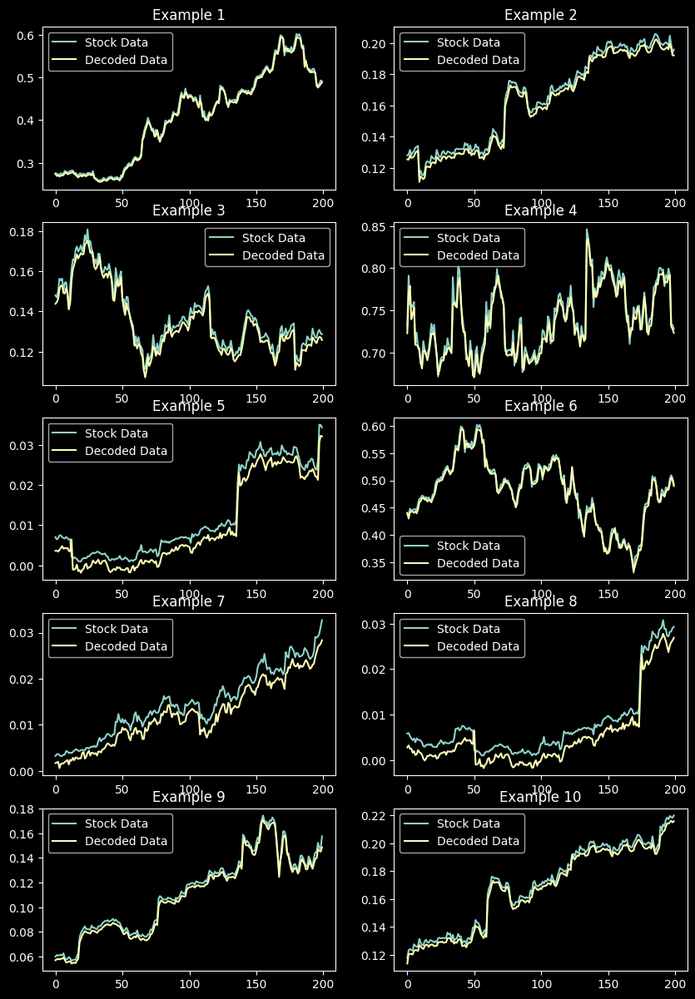

Epochs: 100 Latent Dim: 8 Optimizer: Adam
Epoch 1/100
110/110 [==============================] - 1s 1ms/step - loss: 0.0066
Epoch 2/100
110/110 [==============================] - 0s 1ms/step - loss: 4.9781e-04
Epoch 3/100
110/110 [==============================] - 0s 1ms/step - loss: 3.0457e-04
Epoch 4/100
110/110 [==============================] - 0s 1ms/step - loss: 2.5050e-04
Epoch 5/100
110/110 [==============================] - 0s 1ms/step - loss: 2.2381e-04
Epoch 6/100
110/110 [==============================] - 0s 1ms/step - loss: 2.0690e-04
Epoch 7/100
110/110 [==============================] - 0s 1ms/step - loss: 2.0337e-04
Epoch 8/100
110/110 [==============================] - 0s 1ms/step - loss: 1.8774e-04
Epoch 9/100
110/110 [==============================] - 0s 1ms/step - loss: 1.7577e-04
Epoch 10/100
110/110 [==============================] - 0s 1ms/step - loss: 1.6496e-04
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - loss: 1.6057e-04
Epoch 12/100
1

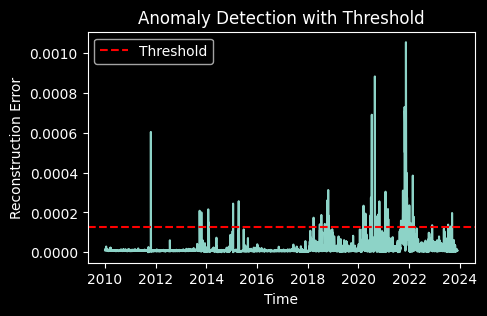

110/110 [==============================] - 0s 998us/step


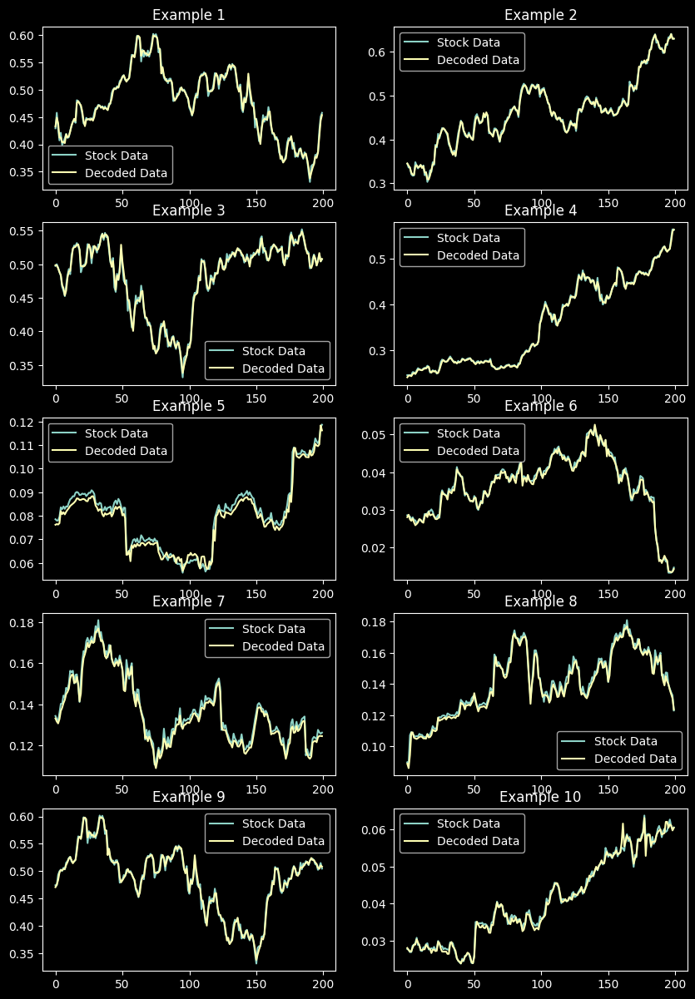

Epochs: 200 Latent Dim: 8 Optimizer: Adam
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0063
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 3.7015e-04
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 2.6337e-04
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 2.2107e-04
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 1.9757e-04
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 1.8324e-04
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 1.7856e-04
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 1.6199e-04
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 1.5899e-04
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 1.6006e-04
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - loss: 1.4379e-04
Epoch 12/200
1

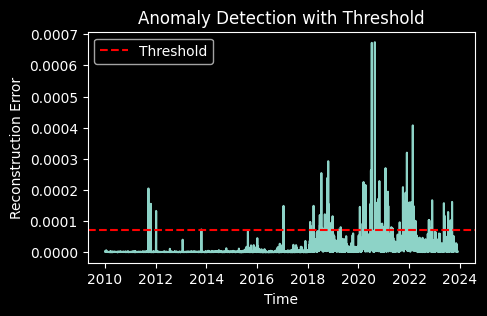

110/110 [==============================] - 0s 1ms/step


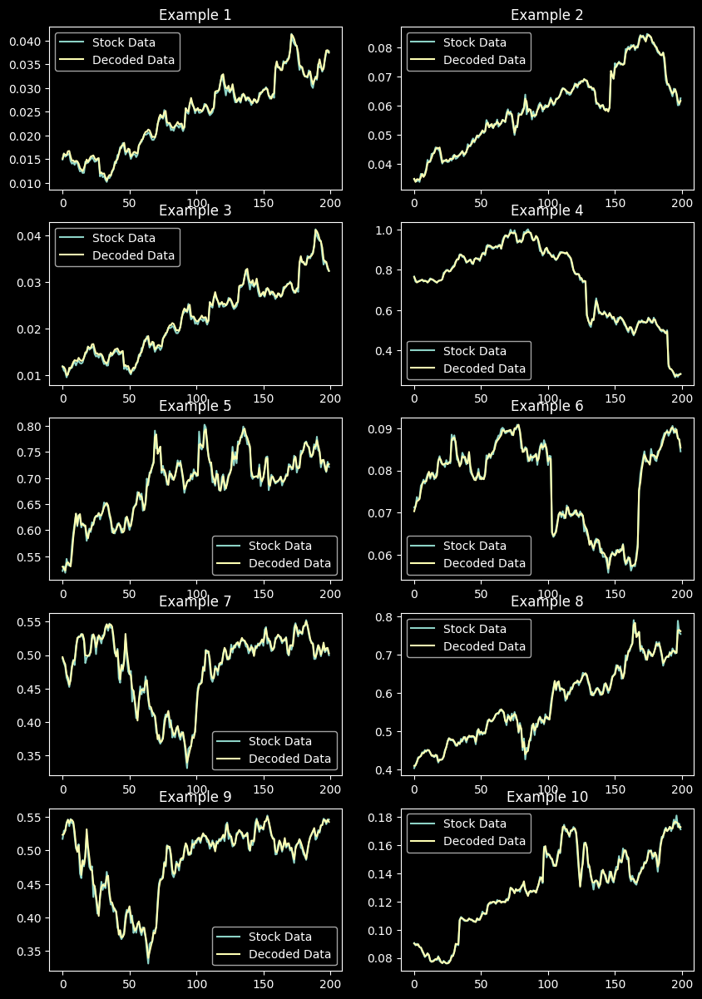

Epochs: 300 Latent Dim: 8 Optimizer: Adam
Epoch 1/300
110/110 [==============================] - 1s 1ms/step - loss: 0.0062
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 4.3636e-04
Epoch 3/300
110/110 [==============================] - 0s 2ms/step - loss: 2.8337e-04
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 2.3932e-04
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 2.1455e-04
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 1.9630e-04
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 1.8665e-04
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 1.7597e-04
Epoch 9/300
110/110 [==============================] - 0s 1ms/step - loss: 1.6739e-04
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 1.5893e-04
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - loss: 1.5052e-04
Epoch 12/300
1

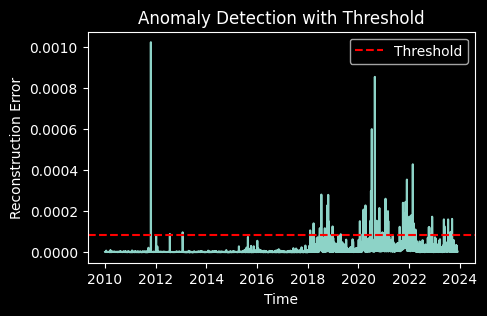

110/110 [==============================] - 0s 1ms/step


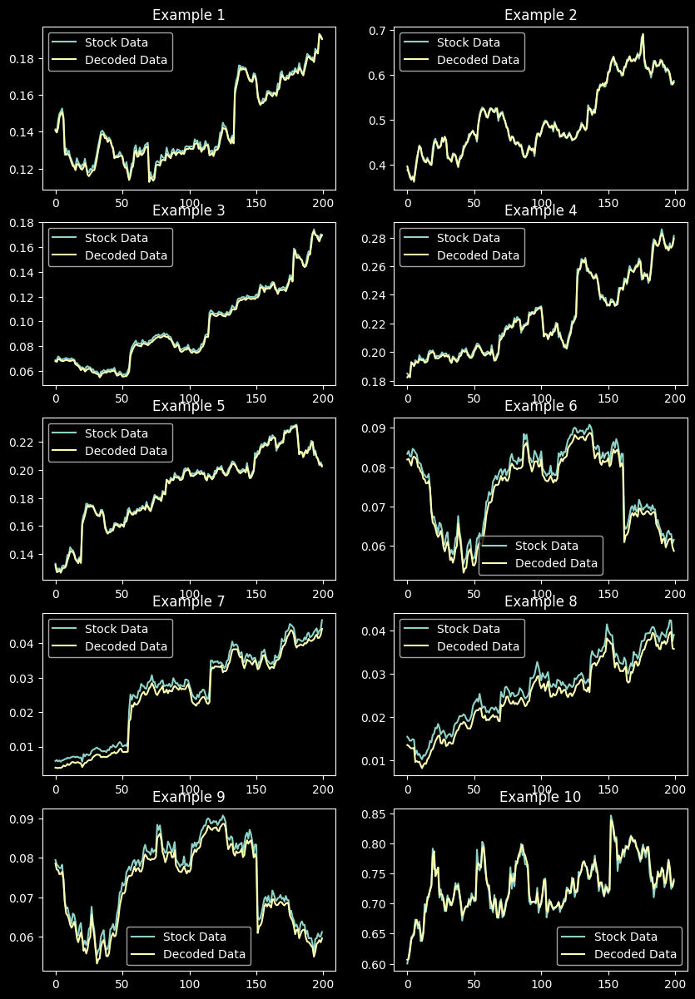

Epochs: 100 Latent Dim: 16 Optimizer: Adam
Epoch 1/100
110/110 [==============================] - 1s 1ms/step - loss: 0.0065
Epoch 2/100
110/110 [==============================] - 0s 1ms/step - loss: 3.3551e-04
Epoch 3/100
110/110 [==============================] - 0s 1ms/step - loss: 2.2246e-04
Epoch 4/100
110/110 [==============================] - 0s 1ms/step - loss: 1.7674e-04
Epoch 5/100
110/110 [==============================] - 0s 1ms/step - loss: 1.1732e-04
Epoch 6/100
110/110 [==============================] - 0s 1ms/step - loss: 8.0616e-05
Epoch 7/100
110/110 [==============================] - 0s 1ms/step - loss: 6.8726e-05
Epoch 8/100
110/110 [==============================] - 0s 1ms/step - loss: 5.8399e-05
Epoch 9/100
110/110 [==============================] - 0s 1ms/step - loss: 4.7091e-05
Epoch 10/100
110/110 [==============================] - 0s 1ms/step - loss: 4.1612e-05
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - loss: 3.7927e-05
Epoch 12/100


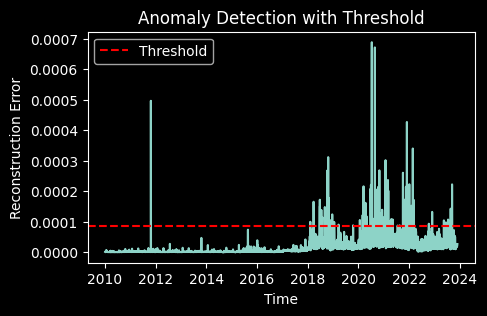

110/110 [==============================] - 0s 1ms/step


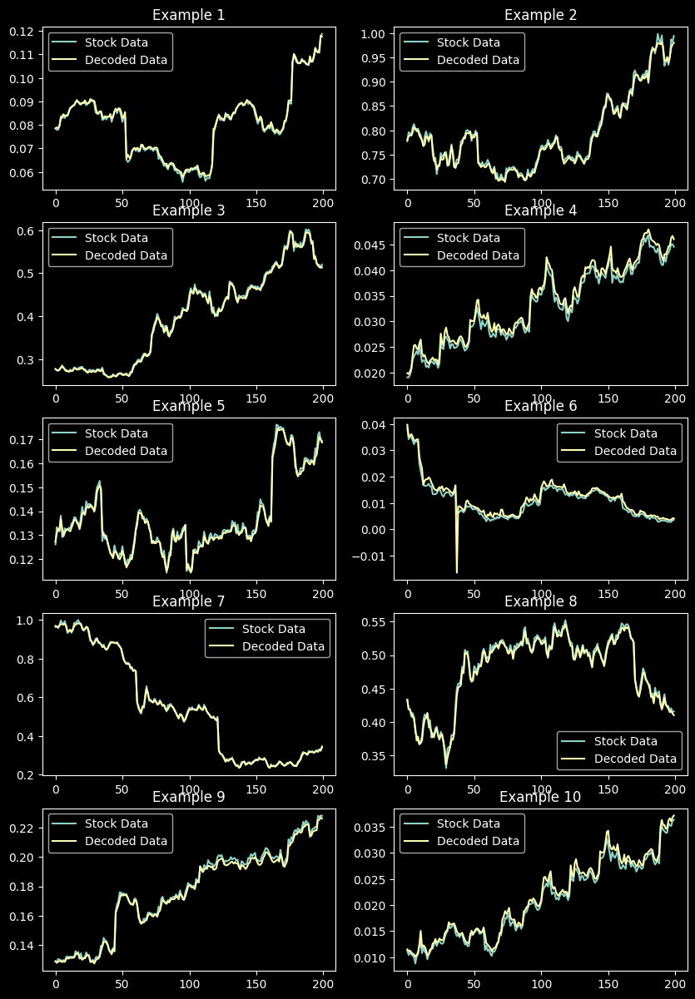

Epochs: 200 Latent Dim: 16 Optimizer: Adam
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0056
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 2.5824e-04
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 1.4951e-04
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 8.8079e-05
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 6.1962e-05
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 4.5017e-05
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 3.6488e-05
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 3.2226e-05
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 2.8741e-05
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 3.0983e-05
Epoch 11/200
110/110 [==============================] - 0s 2ms/step - loss: 2.3055e-05
Epoch 12/200


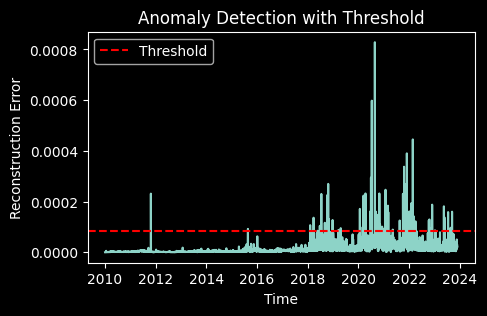

110/110 [==============================] - 0s 866us/step


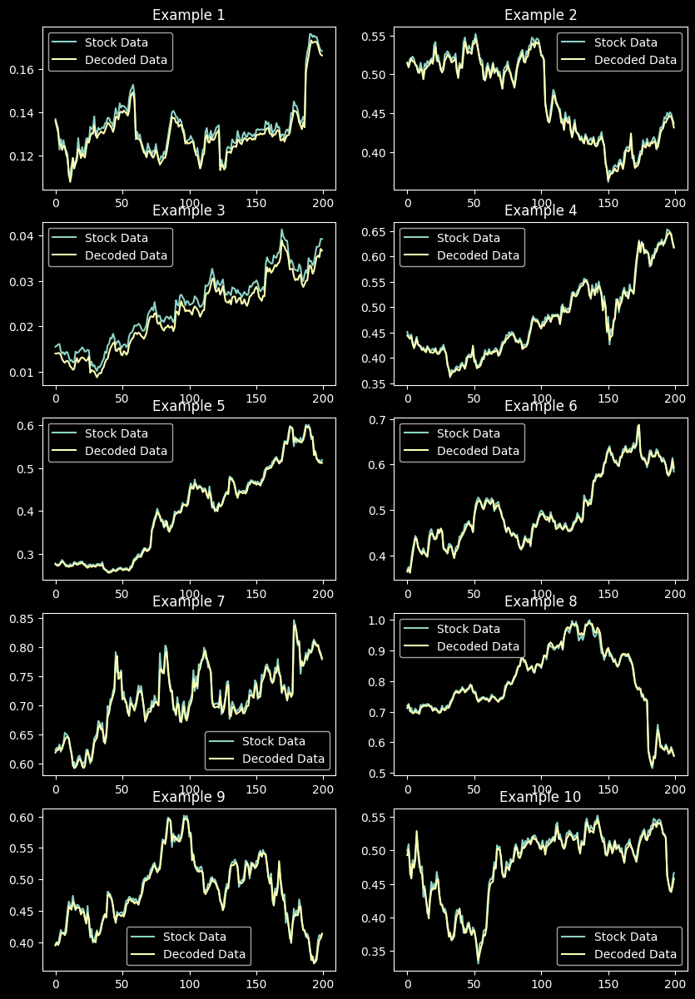

Epochs: 300 Latent Dim: 16 Optimizer: Adam
Epoch 1/300
110/110 [==============================] - 1s 1ms/step - loss: 0.0056
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 2.4348e-04
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 1.5160e-04
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 1.0532e-04
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 6.9237e-05
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 5.0295e-05
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 4.5342e-05
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 4.0315e-05
Epoch 9/300
110/110 [==============================] - 0s 1ms/step - loss: 3.4699e-05
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 3.3114e-05
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - loss: 3.1900e-05
Epoch 12/300


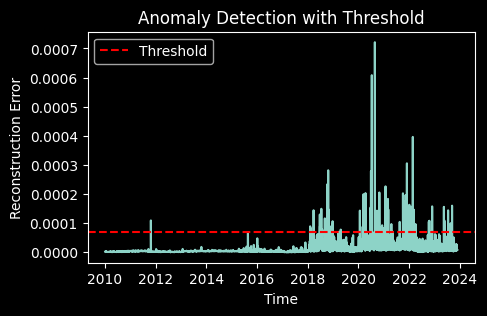

110/110 [==============================] - 0s 1ms/step


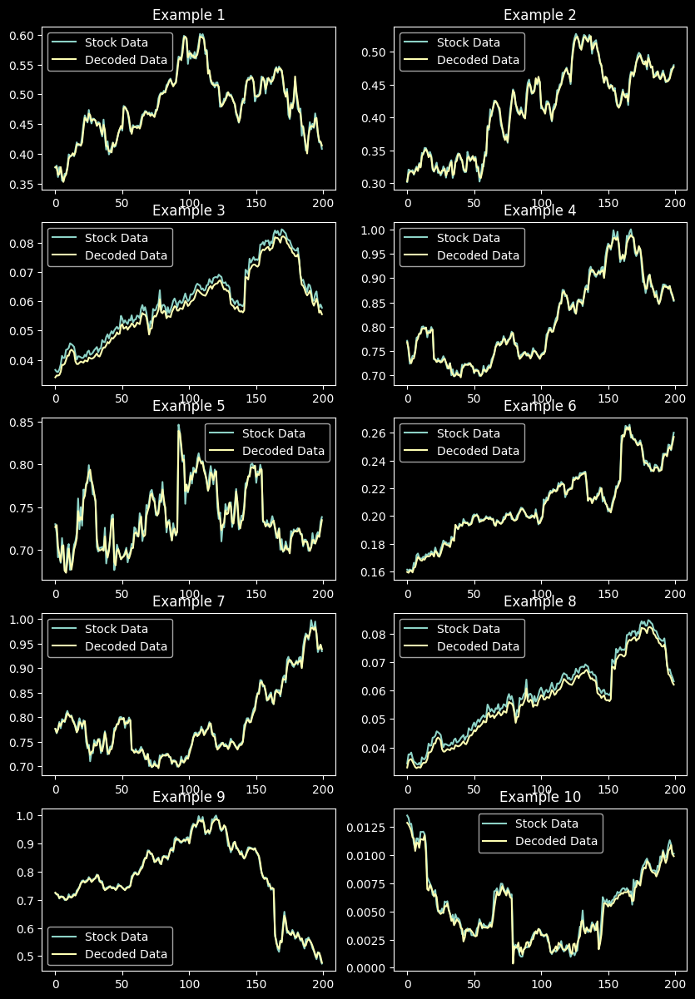

Epochs: 100 Latent Dim: 1 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0610
Epoch 2/100
110/110 [==============================] - 0s 998us/step - loss: 0.0217
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0020
Epoch 4/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0014
Epoch 5/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0013
Epoch 6/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 7/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 8/100
110/110 [==============================] - 0s 1ms/step - loss: 9.8921e-04
Epoch 9/100
110/110 [==============================] - 0s 1ms/step - loss: 9.2622e-04
Epoch 10/100
110/110 [==============================] - 0s 1ms/step - loss: 8.7268e-04
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - loss: 8.2864e-04

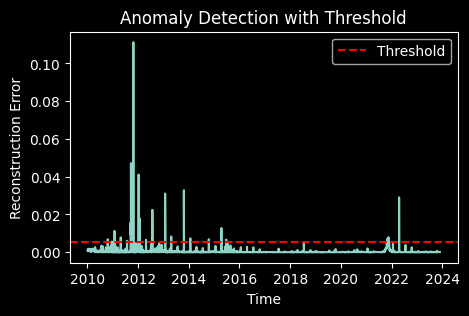

110/110 [==============================] - 0s 955us/step


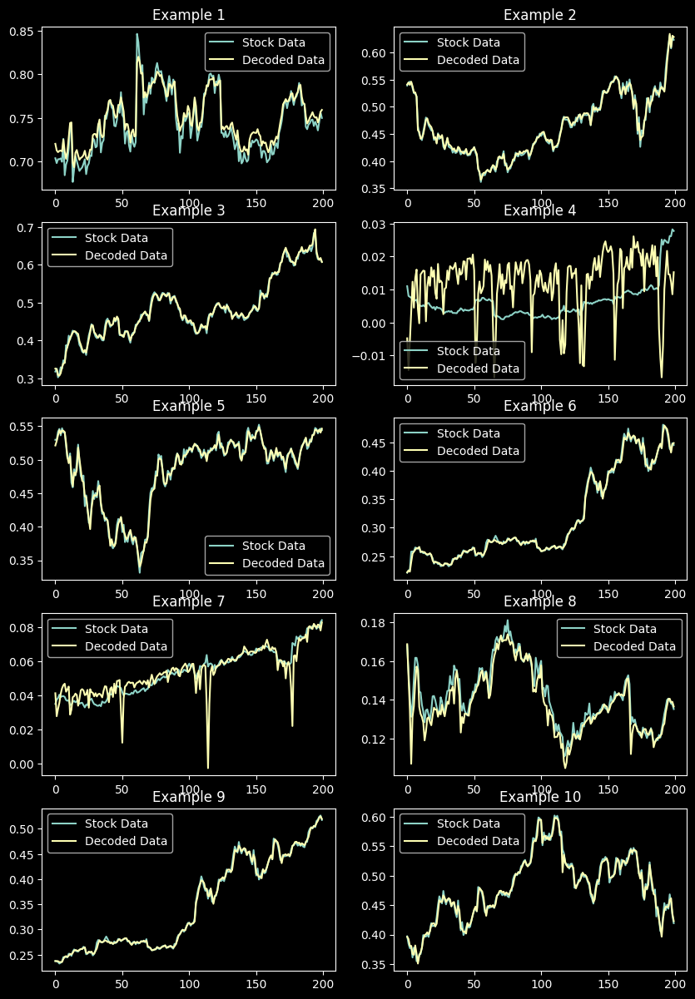

Epochs: 200 Latent Dim: 1 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0702
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0581
Epoch 12/200
110/

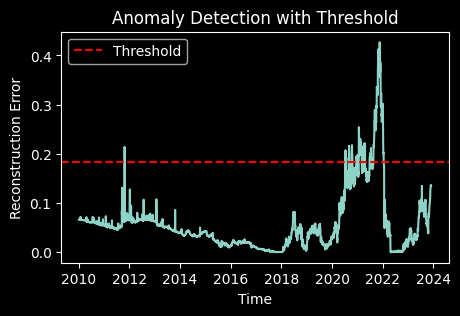

110/110 [==============================] - 0s 1ms/step


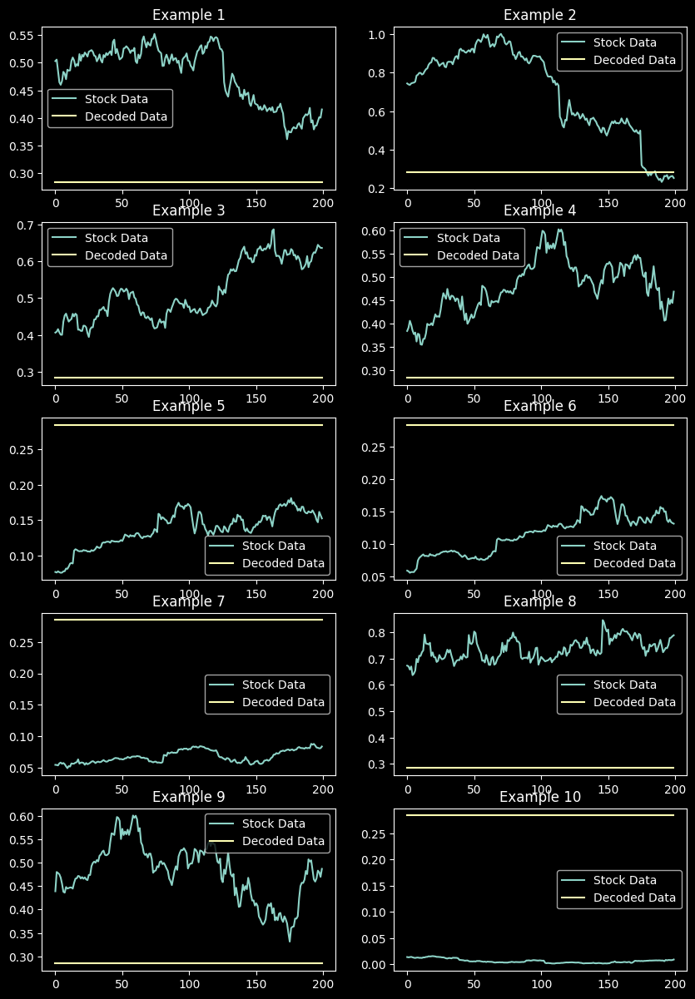

Epochs: 300 Latent Dim: 1 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.0479
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0045
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0015
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0013
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0013
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0012
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0011
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0010
Epoch 11/300
110/110 [==============================] - 0s 2ms/step - loss: 9.9498e-04
Epoch 12/300


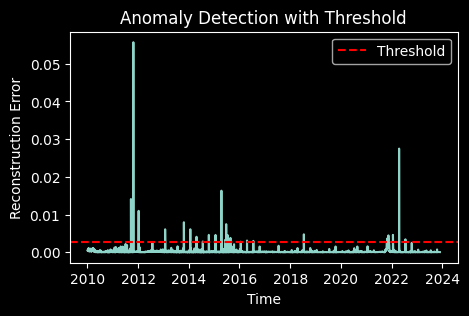

110/110 [==============================] - 0s 1ms/step


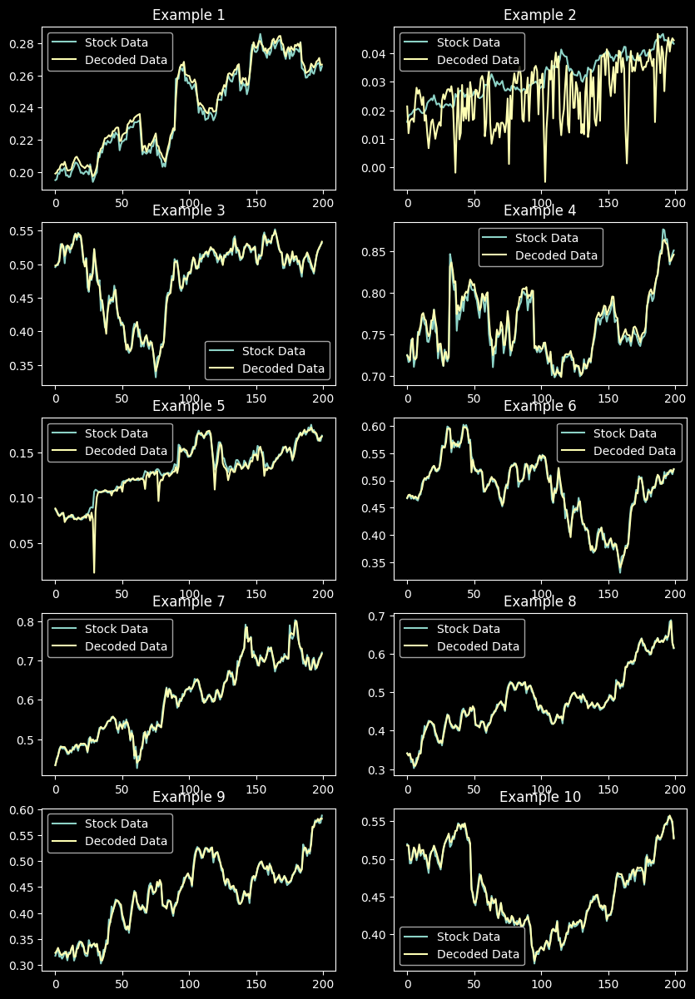

Epochs: 100 Latent Dim: 2 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/100
110/110 [==============================] - 2s 1ms/step - loss: 0.0556
Epoch 2/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0100
Epoch 3/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0014
Epoch 4/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0012
Epoch 5/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 6/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0010
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 9.6465e-04
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 9.2695e-04
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 8.9038e-04
Epoch 11/100
110/110 [==============================] - 0s 2ms/step - loss: 8.5834e-04
E

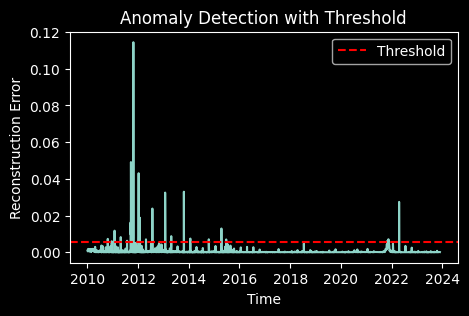

110/110 [==============================] - 0s 1ms/step


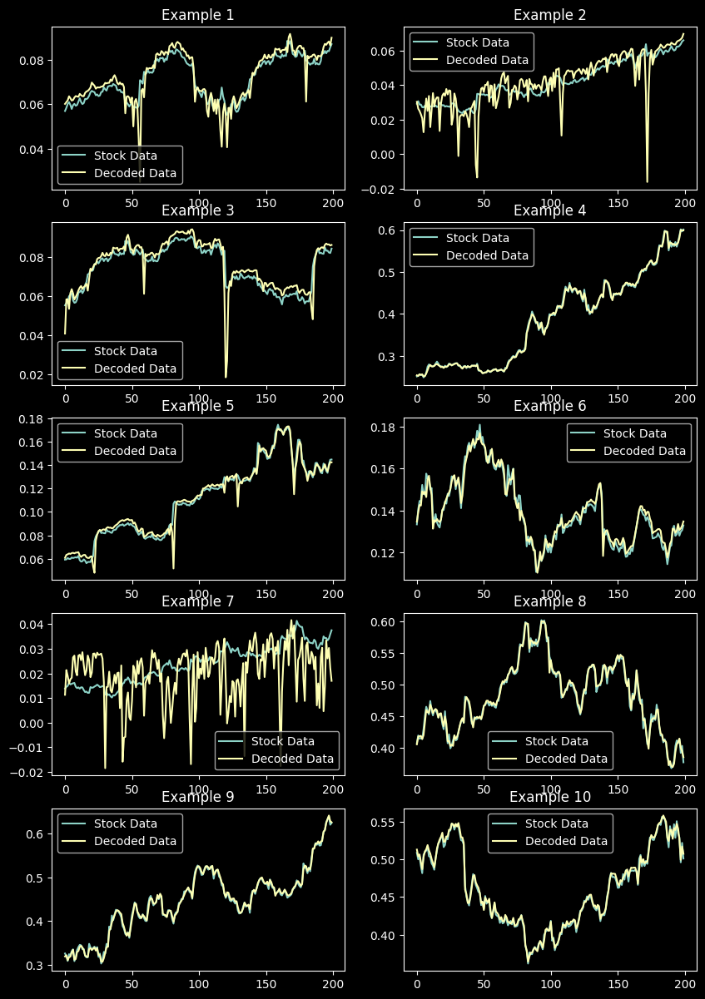

Epochs: 200 Latent Dim: 2 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0498
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0051
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0014
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0012
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0012
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0010
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 9.9023e-04
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 9.3536e-04
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 8.9383e-04
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - loss: 8.3811e-04
E

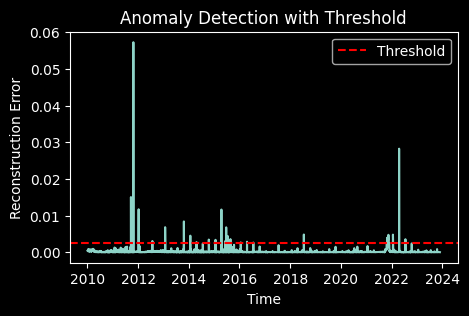

110/110 [==============================] - 0s 1ms/step


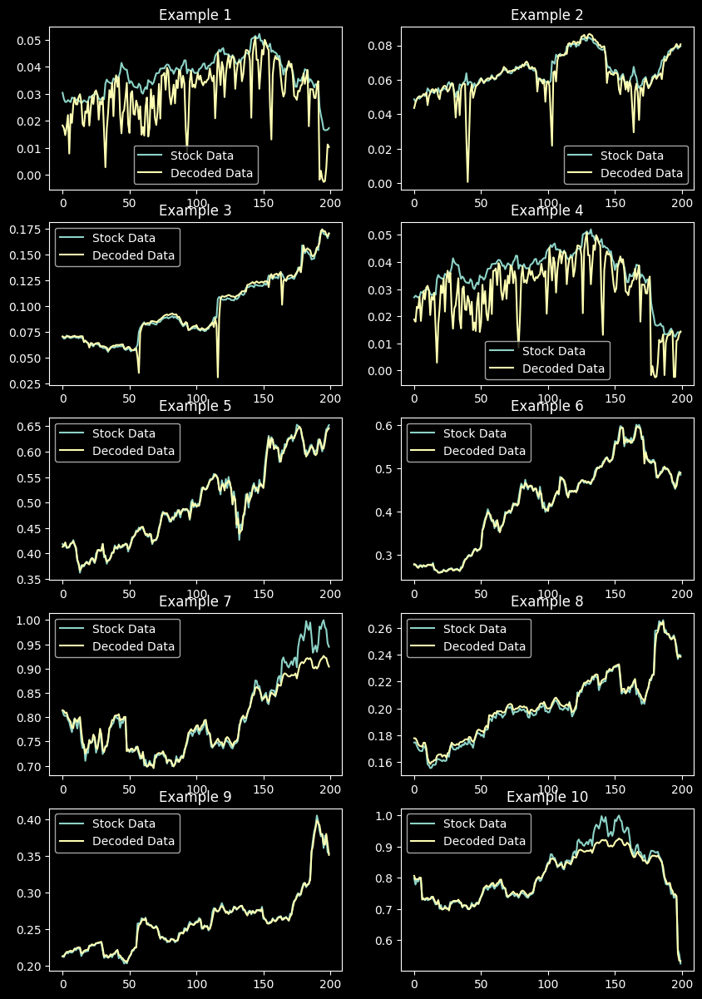

Epochs: 300 Latent Dim: 2 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.0486
Epoch 2/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0044
Epoch 3/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0013
Epoch 4/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0011
Epoch 5/300
110/110 [==============================] - 0s 2ms/step - loss: 9.9532e-04
Epoch 6/300
110/110 [==============================] - 0s 2ms/step - loss: 9.2500e-04
Epoch 7/300
110/110 [==============================] - 0s 2ms/step - loss: 8.7605e-04
Epoch 8/300
110/110 [==============================] - 0s 2ms/step - loss: 8.3405e-04
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 7.9431e-04
Epoch 10/300
110/110 [==============================] - 0s 2ms/step - loss: 7.6227e-04
Epoch 11/300
110/110 [==============================] - 0s 2ms/step - loss: 

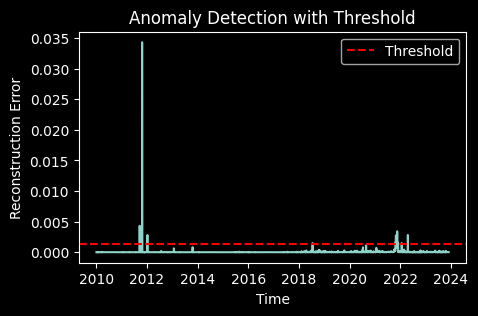

110/110 [==============================] - 0s 911us/step


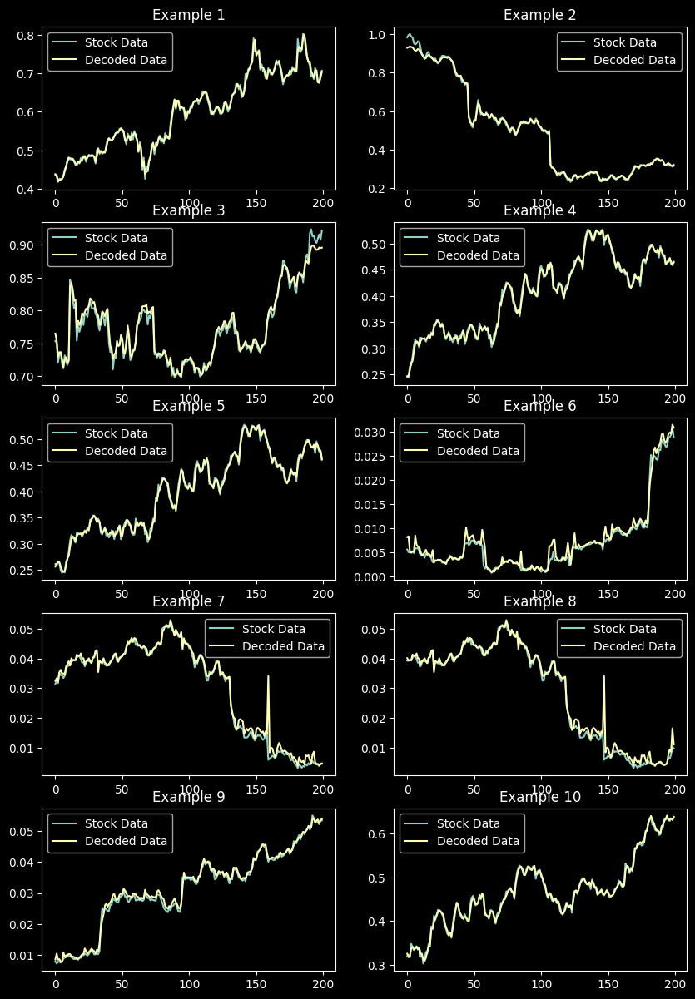

Epochs: 100 Latent Dim: 4 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/100
110/110 [==============================] - 1s 1ms/step - loss: 0.0623
Epoch 2/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0219
Epoch 3/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0024
Epoch 4/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0015
Epoch 5/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 6/100
110/110 [==============================] - 0s 1ms/step - loss: 9.6235e-04
Epoch 7/100
110/110 [==============================] - 0s 1ms/step - loss: 8.5740e-04
Epoch 8/100
110/110 [==============================] - 0s 1ms/step - loss: 7.8695e-04
Epoch 9/100
110/110 [==============================] - 0s 1ms/step - loss: 7.3618e-04
Epoch 10/100
110/110 [==============================] - 0s 1ms/step - loss: 6.9847e-04
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - loss: 6.70

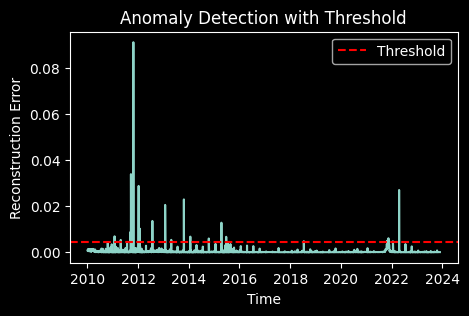

110/110 [==============================] - 0s 1ms/step


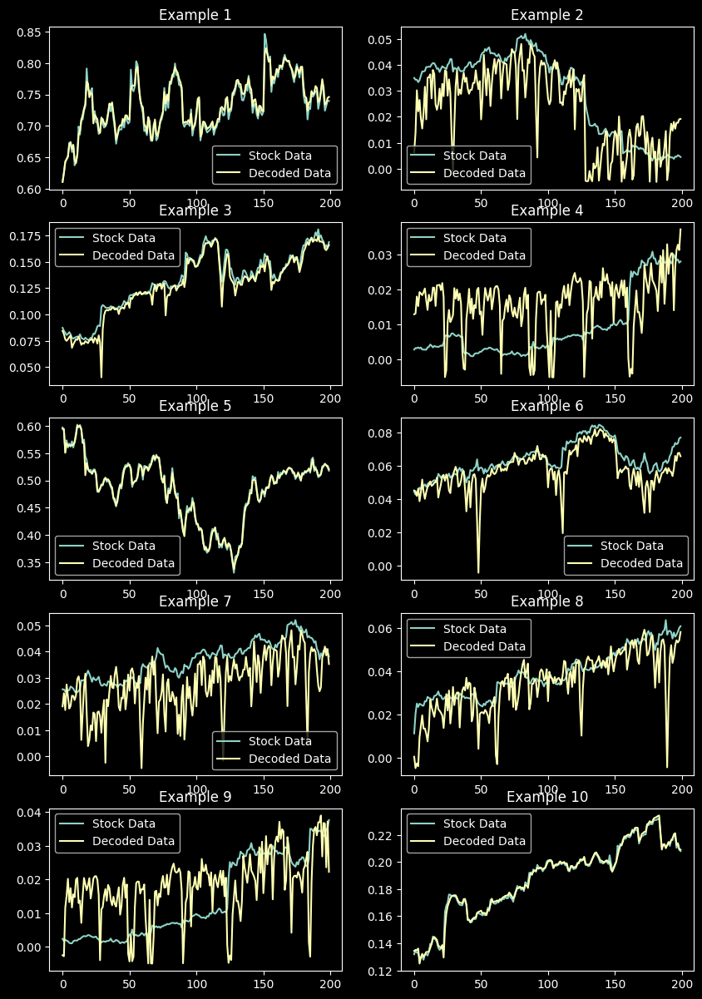

Epochs: 200 Latent Dim: 4 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0517
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0071
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0013
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0010
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 9.7714e-04
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 9.5081e-04
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 9.2680e-04
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 9.0748e-04
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - loss: 8.8721e-

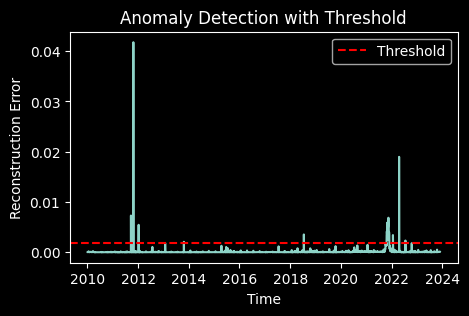

110/110 [==============================] - 0s 1ms/step


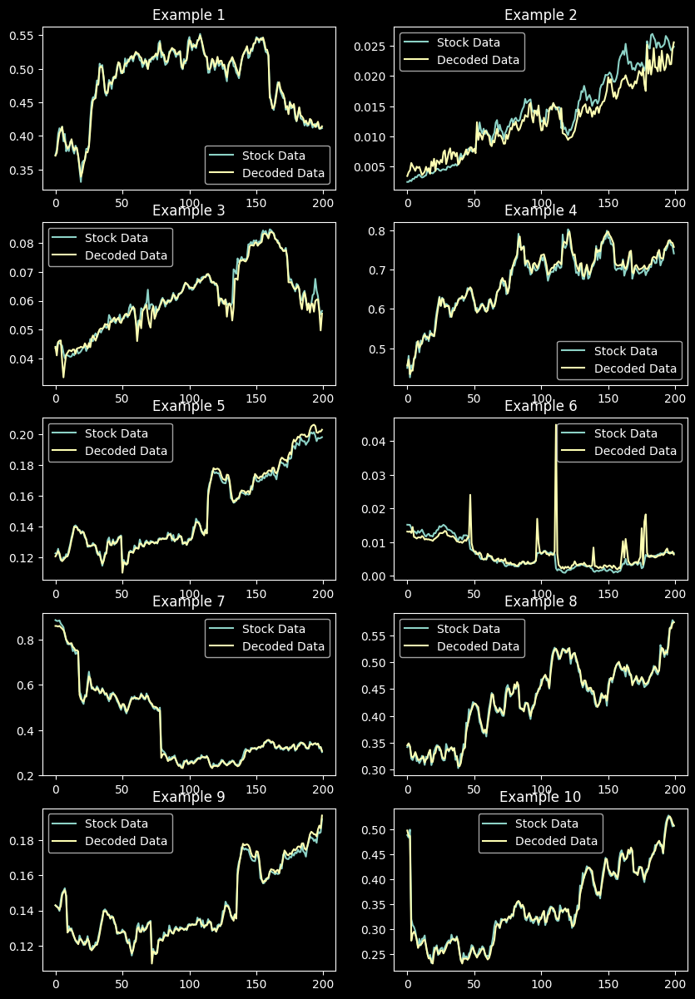

Epochs: 300 Latent Dim: 4 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0623
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0270
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0039
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0019
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0014
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0012
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0010
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 9.2284e-04
Epoch 9/300
110/110 [==============================] - 0s 1ms/step - loss: 8.4903e-04
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 7.9027e-04
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - loss: 7.4525e-04
E

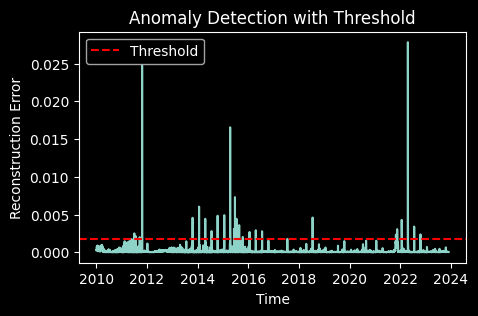

110/110 [==============================] - 0s 1ms/step


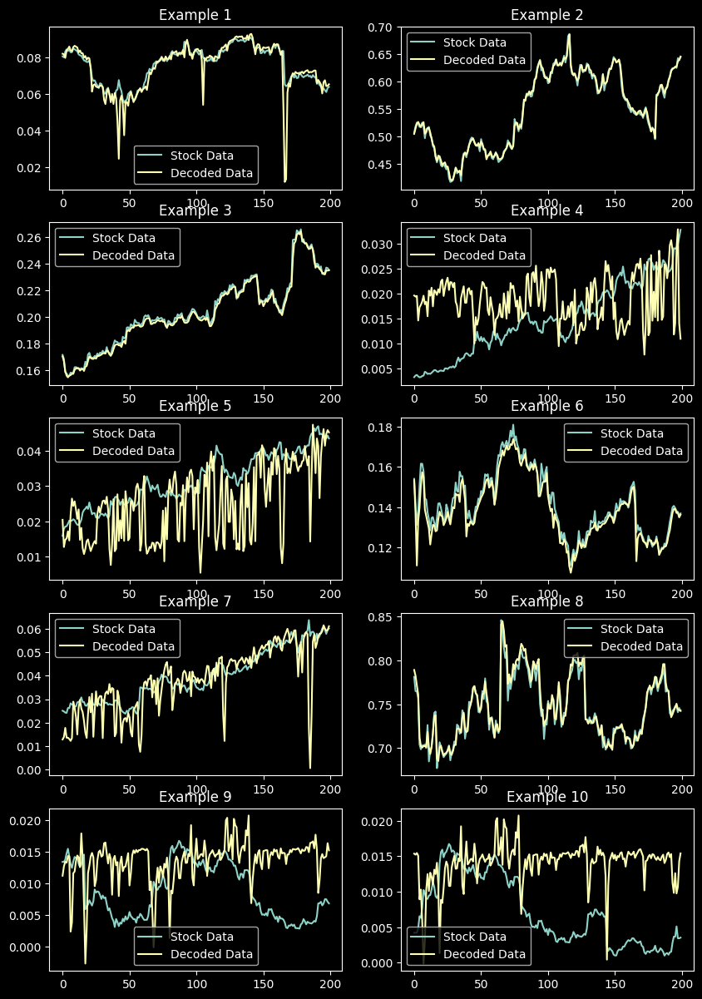

Epochs: 100 Latent Dim: 8 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0657
Epoch 2/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0462
Epoch 3/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0138
Epoch 4/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0018
Epoch 5/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0014
Epoch 6/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0012
Epoch 7/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 8/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0010
Epoch 9/100
110/110 [==============================] - 0s 1ms/step - loss: 9.4954e-04
Epoch 10/100
110/110 [==============================] - 0s 1ms/step - loss: 9.0242e-04
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - loss: 8.5927e-04
Epoch

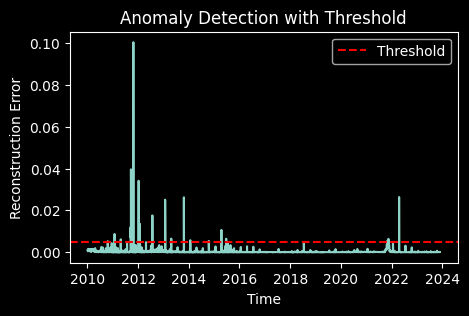

110/110 [==============================] - 0s 1ms/step


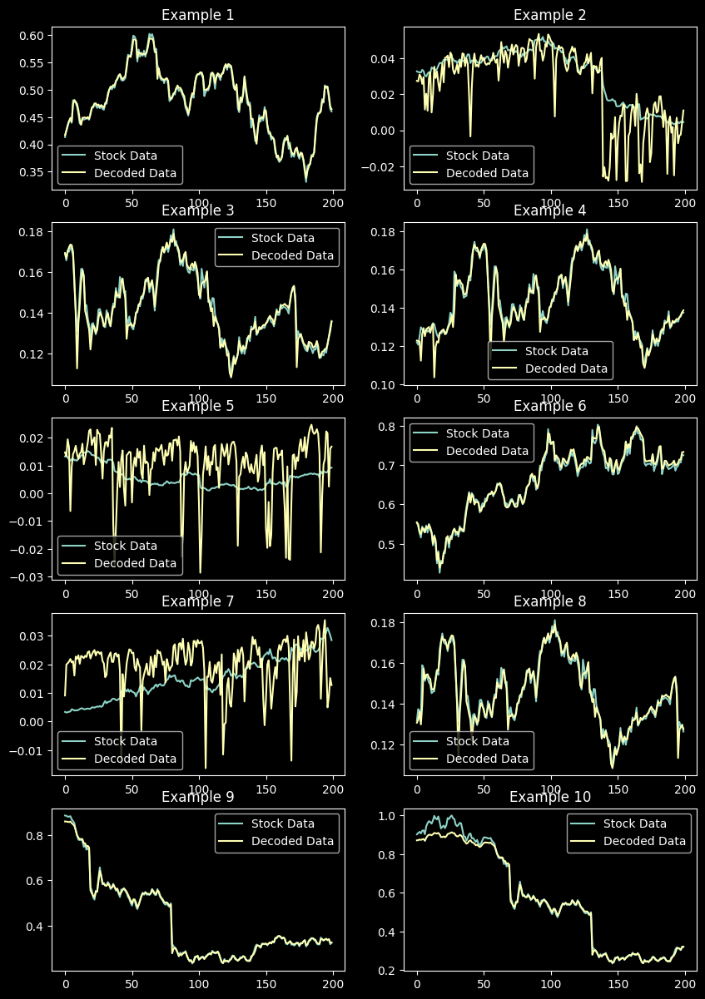

Epochs: 200 Latent Dim: 8 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0394
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0020
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0012
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 9.7629e-04
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 9.1032e-04
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 8.5910e-04
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 8.1705e-04
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 7.8216e-04
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 7.5372e-04
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - loss: 

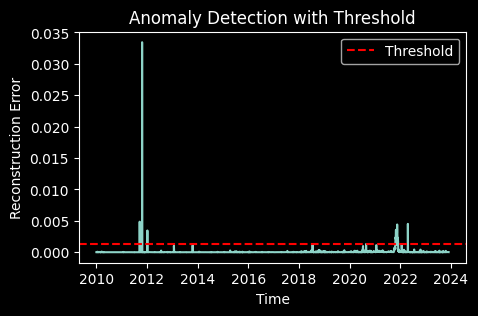

110/110 [==============================] - 0s 1ms/step


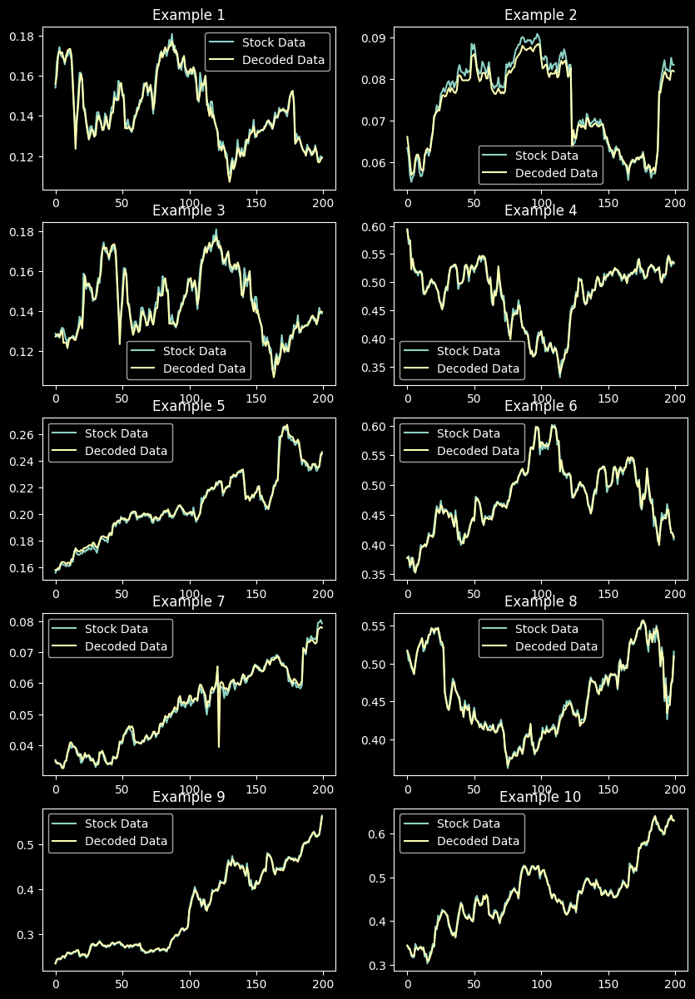

Epochs: 300 Latent Dim: 8 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/300
110/110 [==============================] - 1s 1ms/step - loss: 0.0439
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0024
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0012
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0010
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 9.1997e-04
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 8.4236e-04
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 7.8121e-04
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 7.2948e-04
Epoch 9/300
110/110 [==============================] - 0s 1ms/step - loss: 6.8611e-04
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 6.5265e-04
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - loss: 

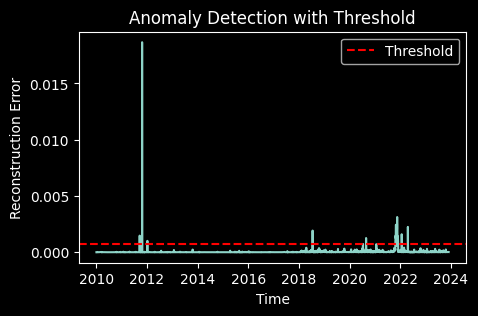

110/110 [==============================] - 0s 1ms/step


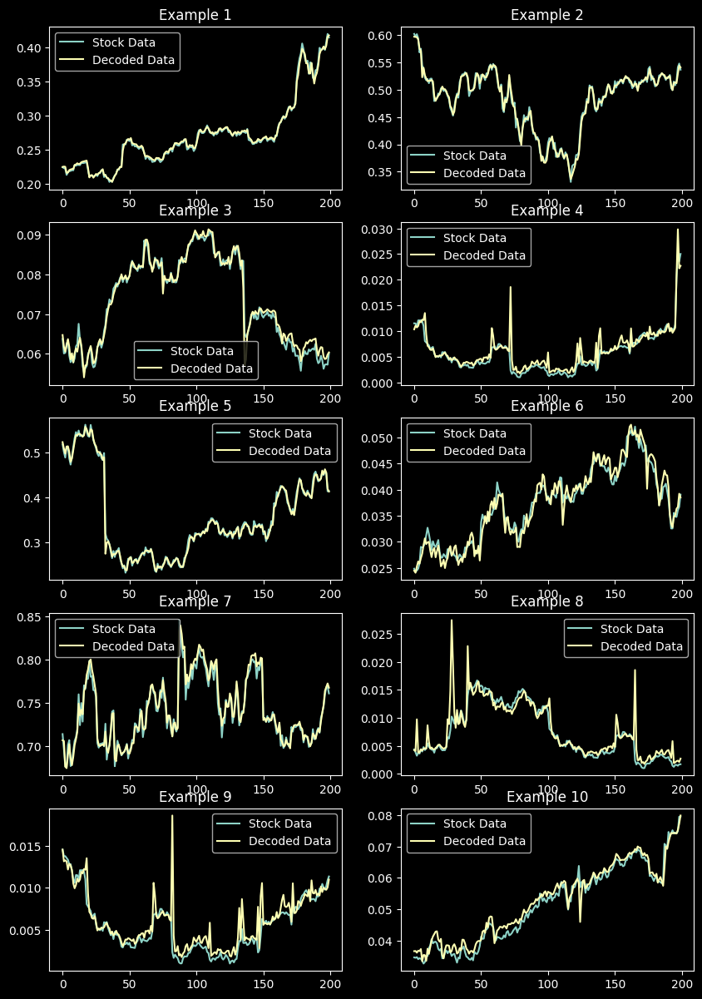

Epochs: 100 Latent Dim: 16 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/100
110/110 [==============================] - 1s 1ms/step - loss: 0.0581
Epoch 2/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0147
Epoch 3/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0021
Epoch 4/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0013
Epoch 5/100
110/110 [==============================] - 0s 1ms/step - loss: 9.9580e-04
Epoch 6/100
110/110 [==============================] - 0s 1ms/step - loss: 8.6065e-04
Epoch 7/100
110/110 [==============================] - 0s 1ms/step - loss: 7.7308e-04
Epoch 8/100
110/110 [==============================] - 0s 1ms/step - loss: 7.1126e-04
Epoch 9/100
110/110 [==============================] - 0s 1ms/step - loss: 6.6266e-04
Epoch 10/100
110/110 [==============================] - 0s 1ms/step - loss: 6.2632e-04
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - loss:

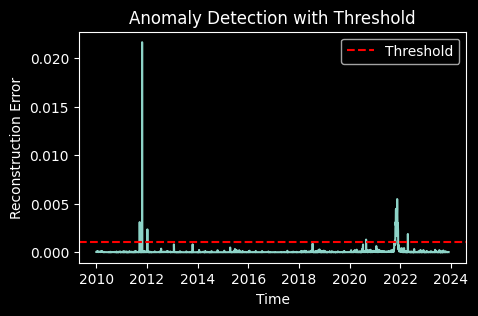

110/110 [==============================] - 0s 1ms/step


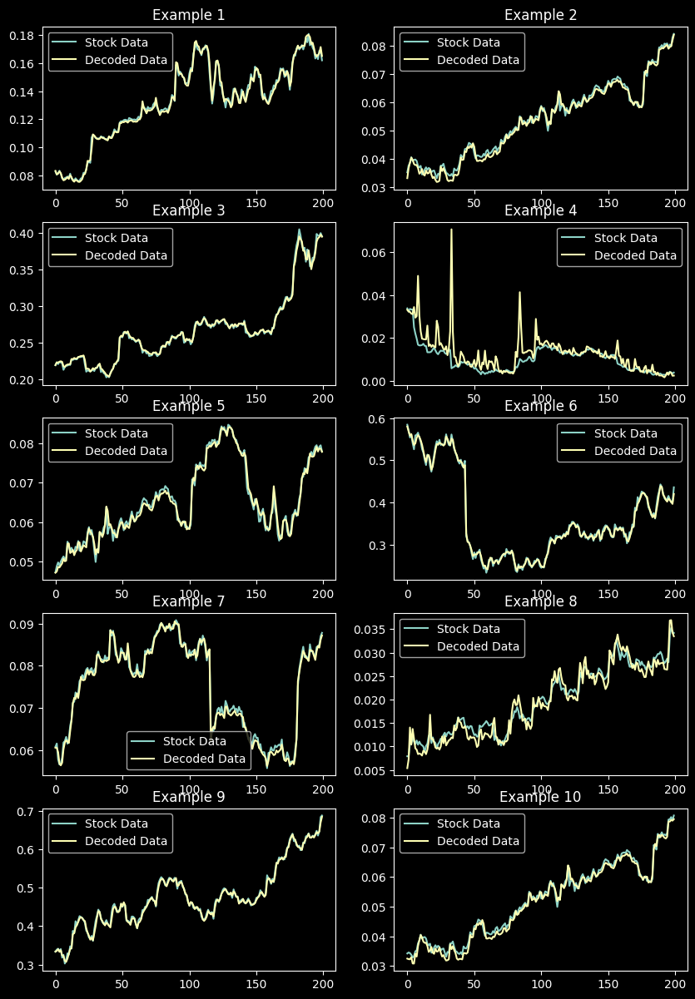

Epochs: 200 Latent Dim: 16 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0583
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0139
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0017
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0012
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0010
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 9.3145e-04
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 8.4337e-04
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 7.7752e-04
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 7.2937e-04
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 6.9176e-04
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - loss: 6.6

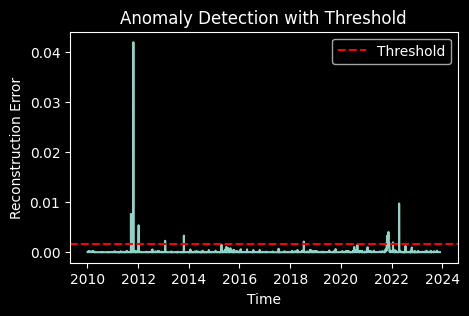

110/110 [==============================] - 0s 1ms/step


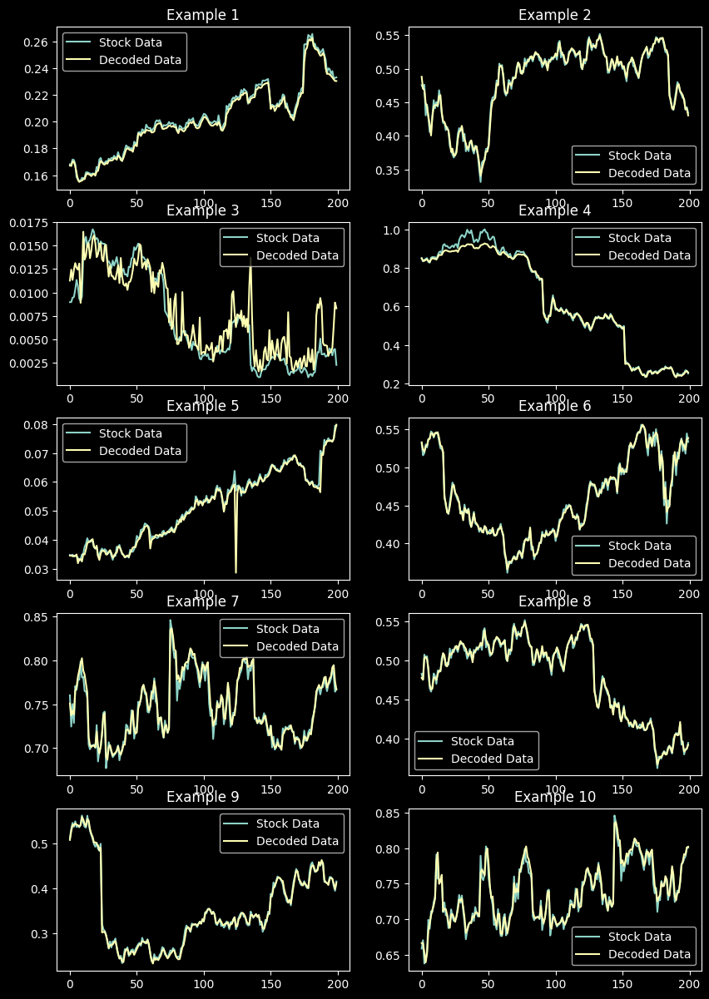

Epochs: 300 Latent Dim: 16 Optimizer: SGD, lr=0.01, momentum=0.9, nesterov=True
Epoch 1/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0421
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0021
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0011
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0010
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 9.1588e-04
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 8.4963e-04
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 7.9857e-04
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 7.5710e-04
Epoch 9/300
110/110 [==============================] - 0s 1ms/step - loss: 7.2368e-04
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 6.9592e-04
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - loss:

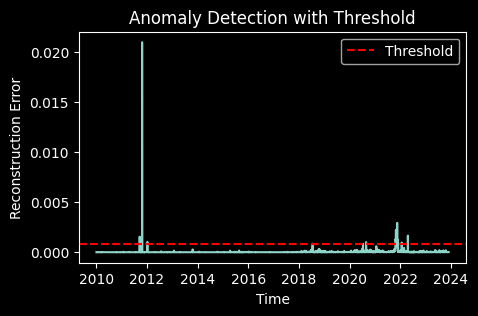

110/110 [==============================] - 0s 1ms/step


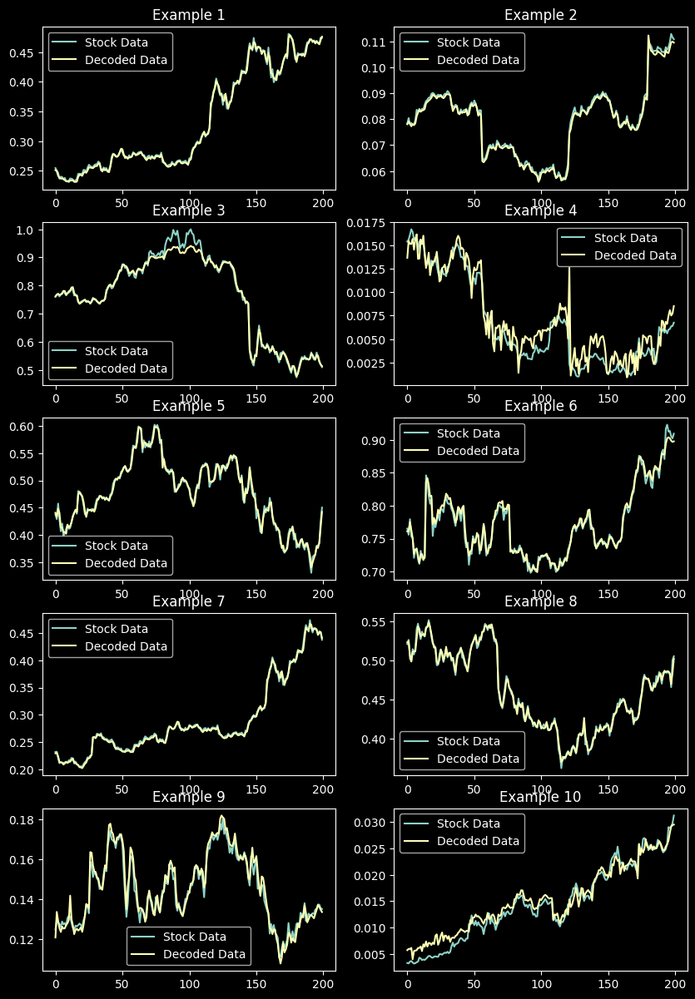

Epochs: 100 Latent Dim: 1 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/100
110/110 [==============================] - 1s 2ms/step - loss: 0.0624
Epoch 2/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0583
Epoch 4/100
110/110 [==============================] - 0s 3ms/step - loss: 0.0583
Epoch 5/100
110/110 [==============================] - 0s 3ms/step - loss: 0.0583
Epoch 6/100
110/110 [==============================] - 0s 3ms/step - loss: 0.0582
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0583
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0583
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0583
Epoch 11/100
110/110 [==============================] - 0s 2ms/step - l

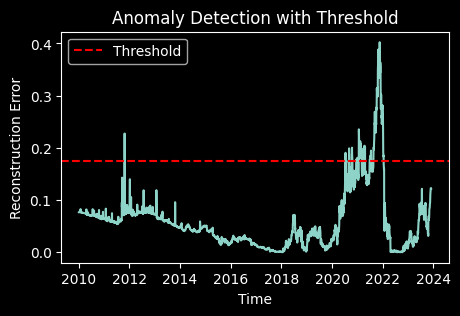

110/110 [==============================] - 0s 1ms/step


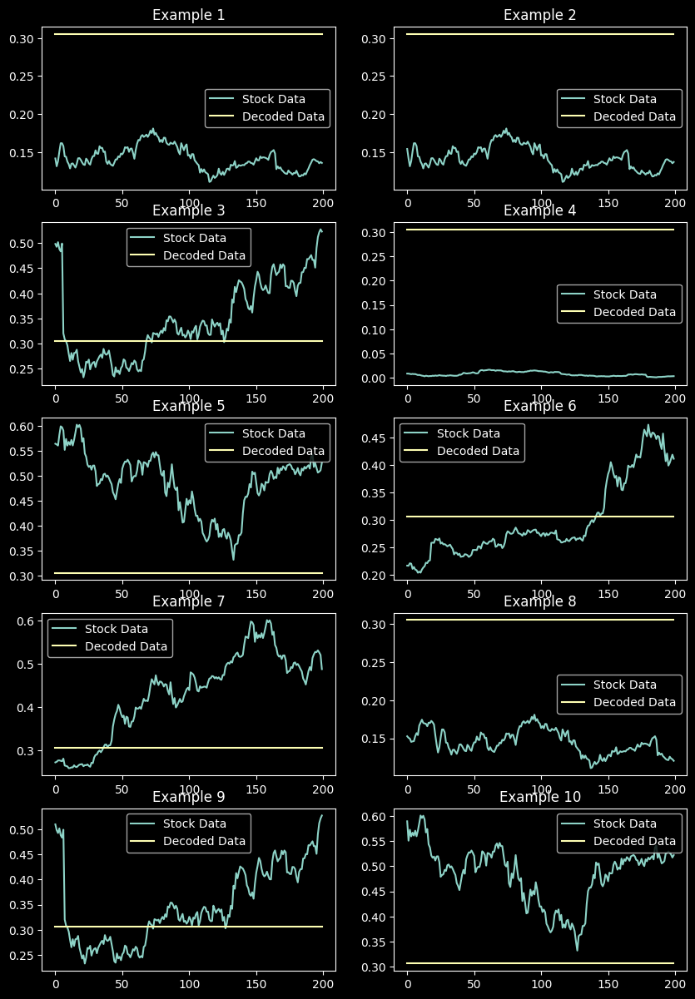

Epochs: 200 Latent Dim: 1 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0613
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0591
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0586
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0587
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0585
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0585
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0584
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0582
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - l

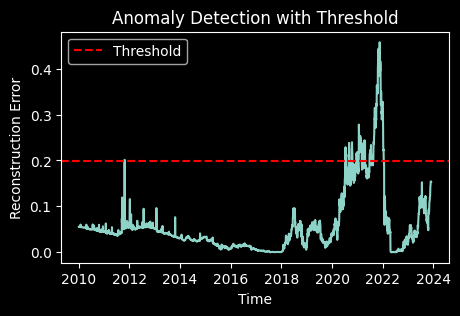

110/110 [==============================] - 0s 1ms/step


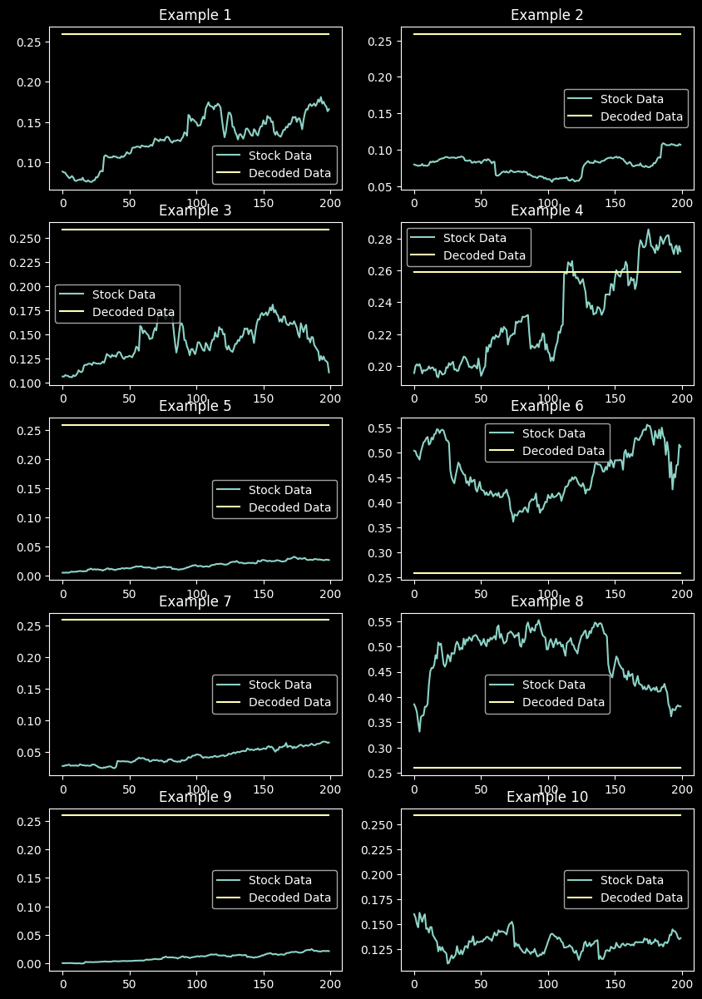

Epochs: 300 Latent Dim: 1 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/300
110/110 [==============================] - 1s 1ms/step - loss: 0.0616
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0594
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0587
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0587
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0585
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0585
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0585
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0584
Epoch 9/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - l

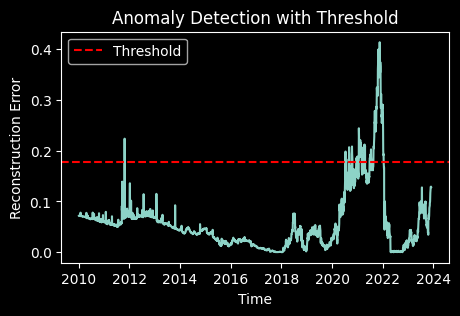

110/110 [==============================] - 0s 1ms/step


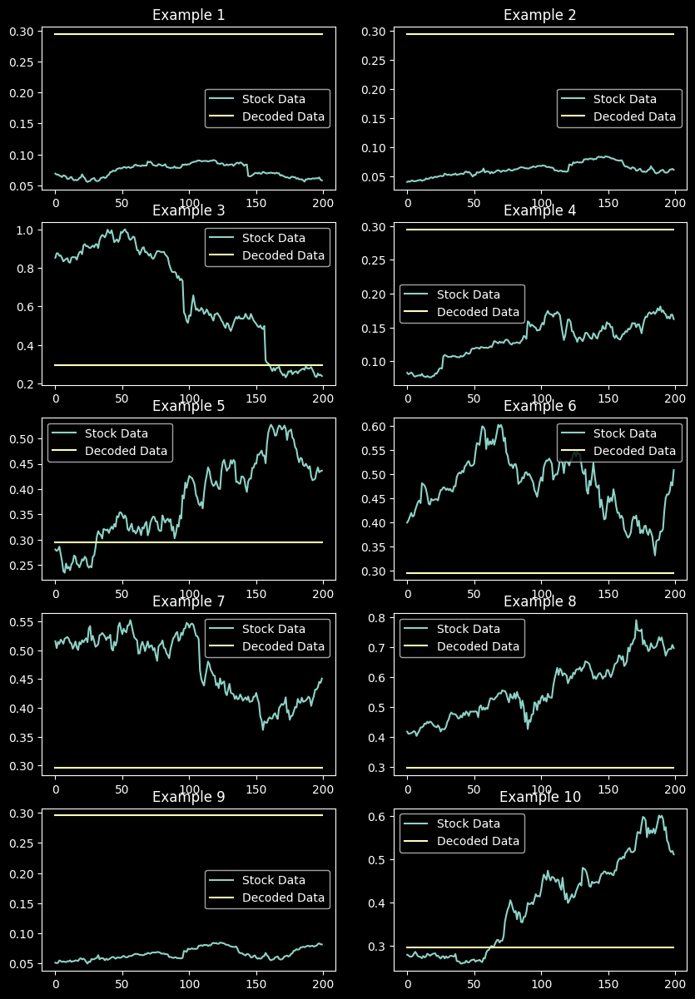

Epochs: 100 Latent Dim: 2 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/100
110/110 [==============================] - 1s 1ms/step - loss: 0.0613
Epoch 2/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0594
Epoch 3/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0584
Epoch 4/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0588
Epoch 5/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0585
Epoch 6/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0585
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0583
Epoch 8/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 9/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 10/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - l

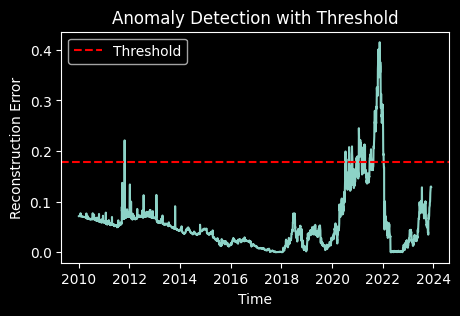

110/110 [==============================] - 0s 1ms/step


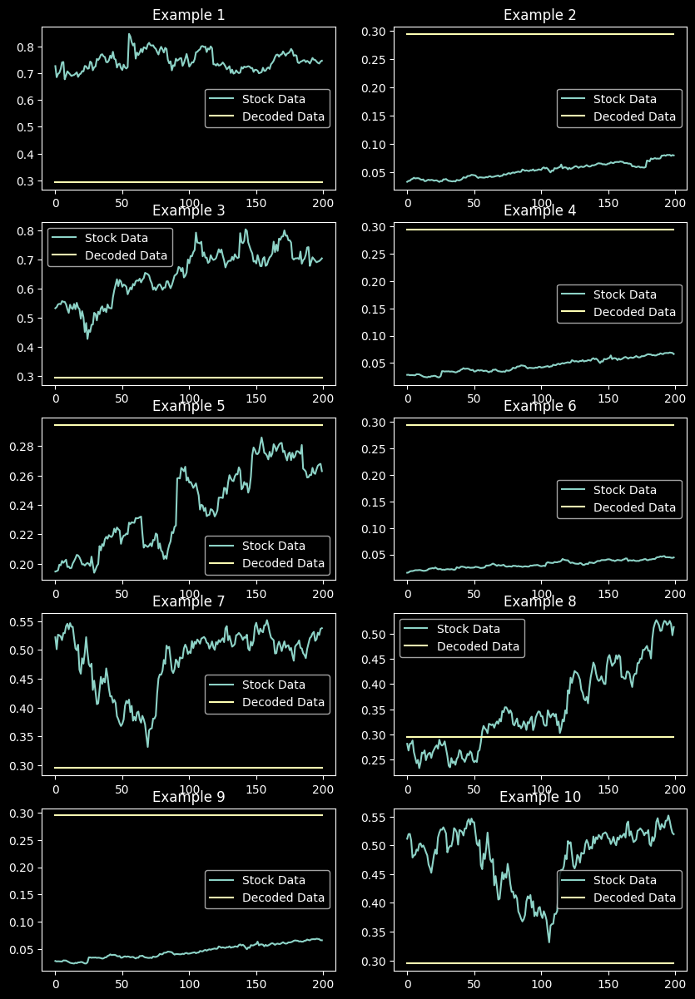

Epochs: 200 Latent Dim: 2 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0184
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0062
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0046
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0032
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0030
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0023
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0023
Epoch 8/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0020
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0019
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0018
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - l

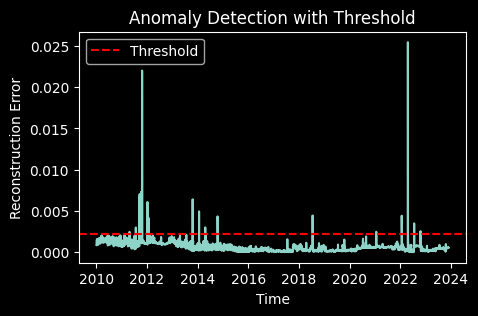

110/110 [==============================] - 0s 1ms/step


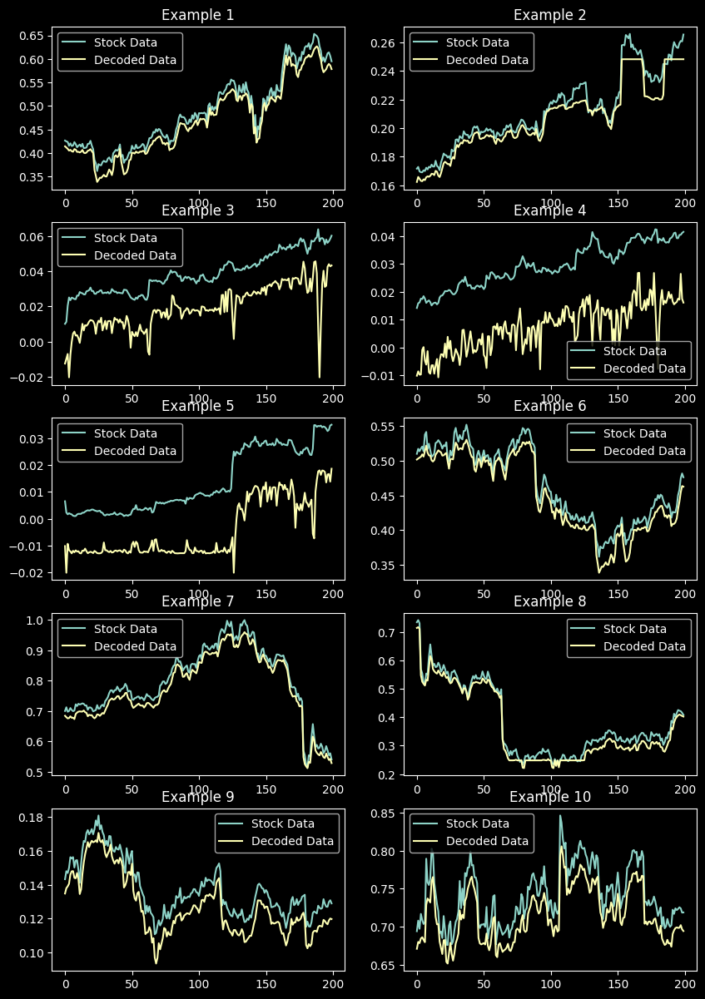

Epochs: 300 Latent Dim: 2 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/300
110/110 [==============================] - 1s 1ms/step - loss: 0.0627
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 5/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0582
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 9/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - l

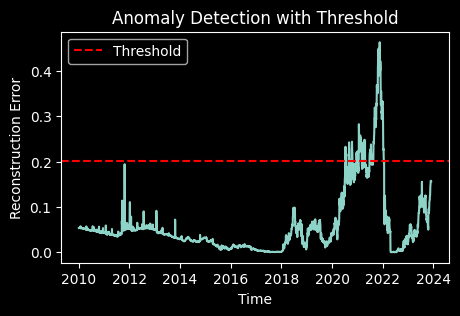

110/110 [==============================] - 0s 2ms/step


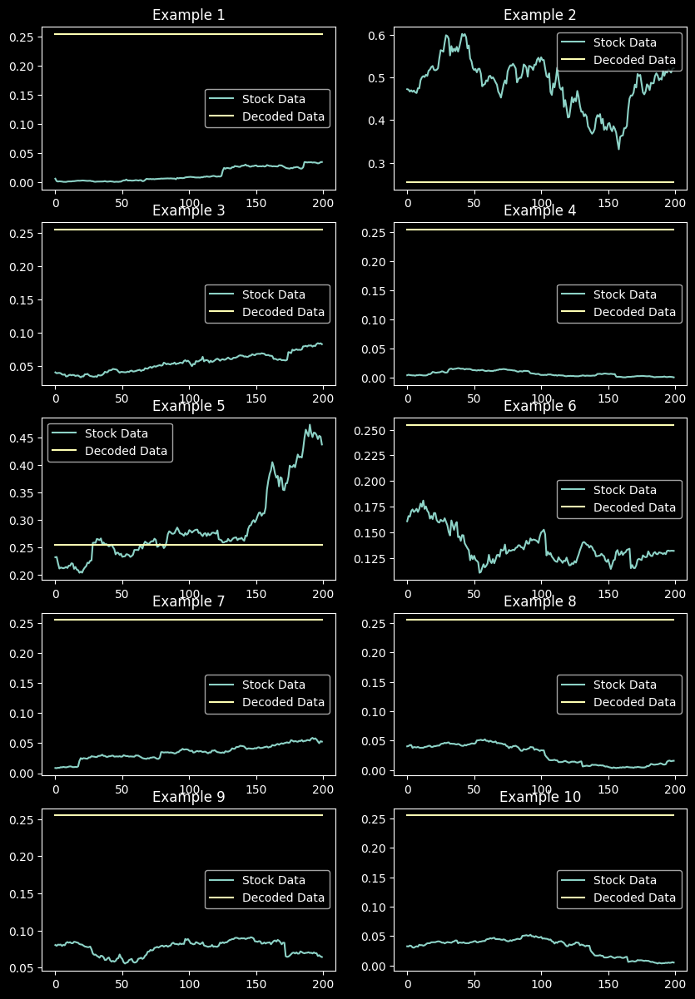

Epochs: 100 Latent Dim: 4 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/100
110/110 [==============================] - 1s 1ms/step - loss: 0.0639
Epoch 2/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0591
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0589
Epoch 4/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0586
Epoch 5/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0585
Epoch 6/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0582
Epoch 7/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0585
Epoch 8/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0584
Epoch 9/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0584
Epoch 10/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0582
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - l

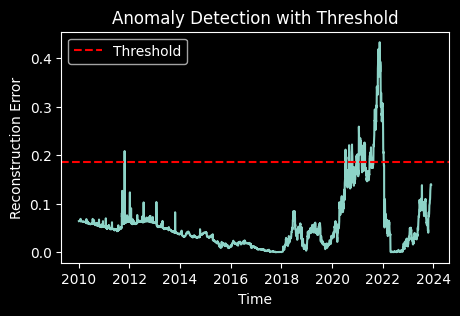

110/110 [==============================] - 0s 1ms/step


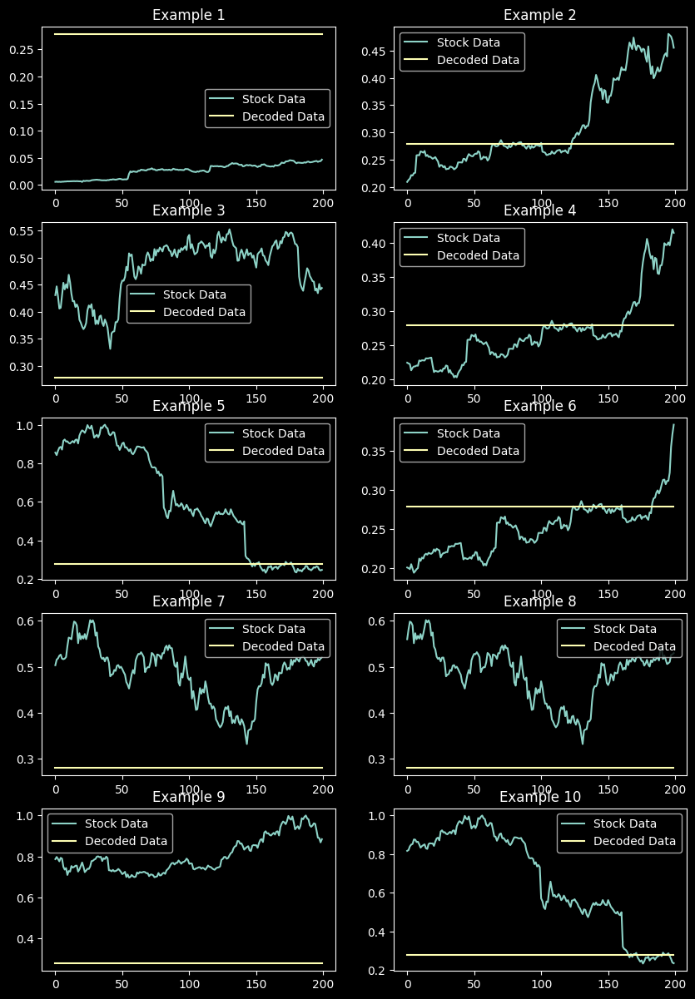

Epochs: 200 Latent Dim: 4 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0639
Epoch 2/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0591
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0589
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0584
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0585
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0584
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0583
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - l

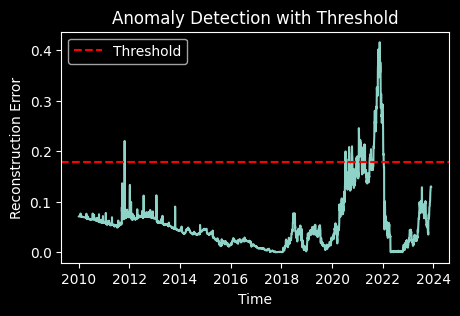

110/110 [==============================] - 0s 1ms/step


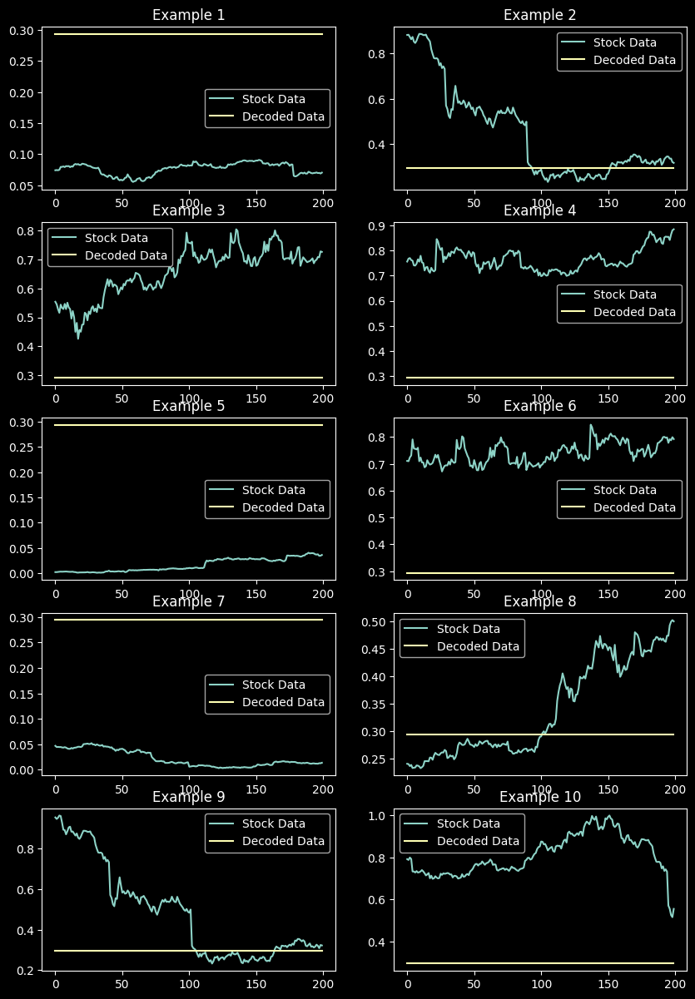

Epochs: 300 Latent Dim: 4 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.0175
Epoch 2/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0051
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0035
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0026
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0024
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0021
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0018
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0017
Epoch 9/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0015
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0014
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - l

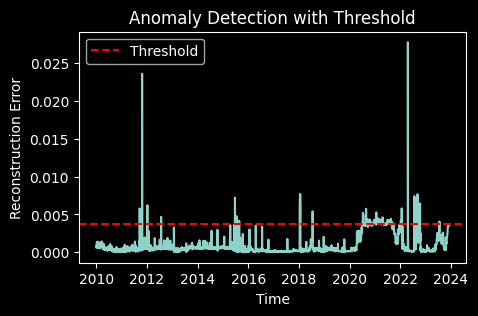

110/110 [==============================] - 0s 1ms/step


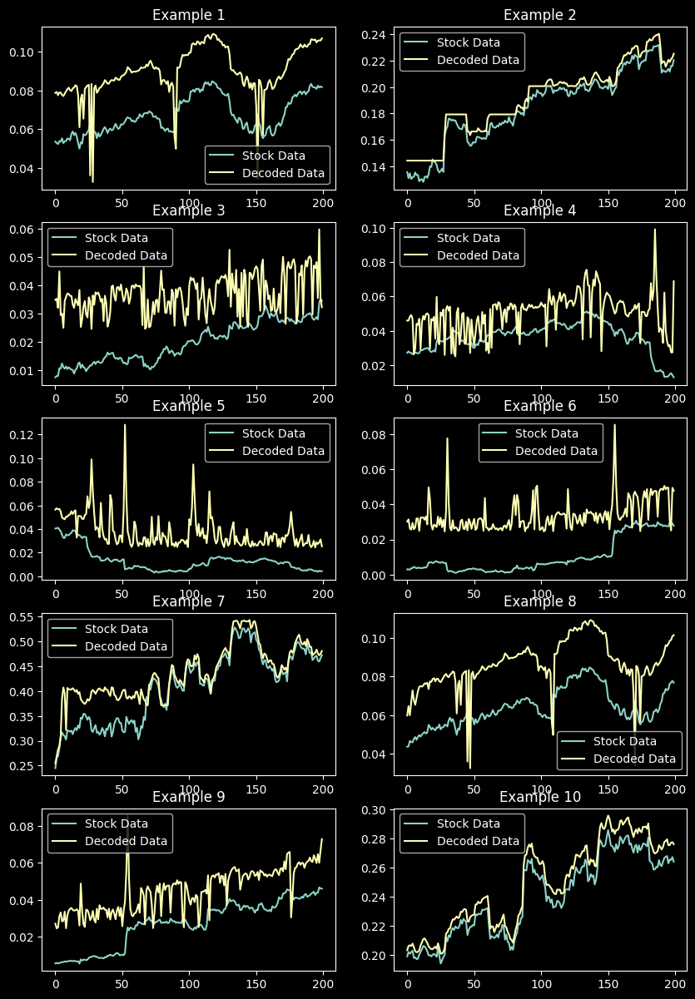

Epochs: 100 Latent Dim: 8 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/100
110/110 [==============================] - 2s 1ms/step - loss: 0.0203
Epoch 2/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0053
Epoch 3/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0032
Epoch 4/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0028
Epoch 5/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0020
Epoch 6/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0018
Epoch 7/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0018
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0015
Epoch 9/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0014
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0014
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - l

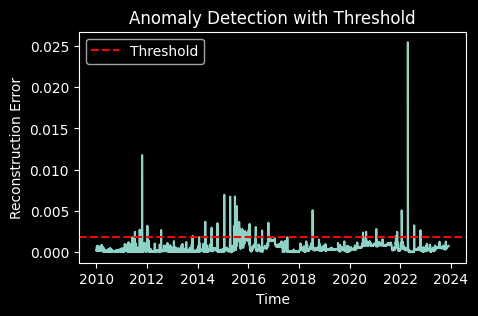

110/110 [==============================] - 0s 1ms/step


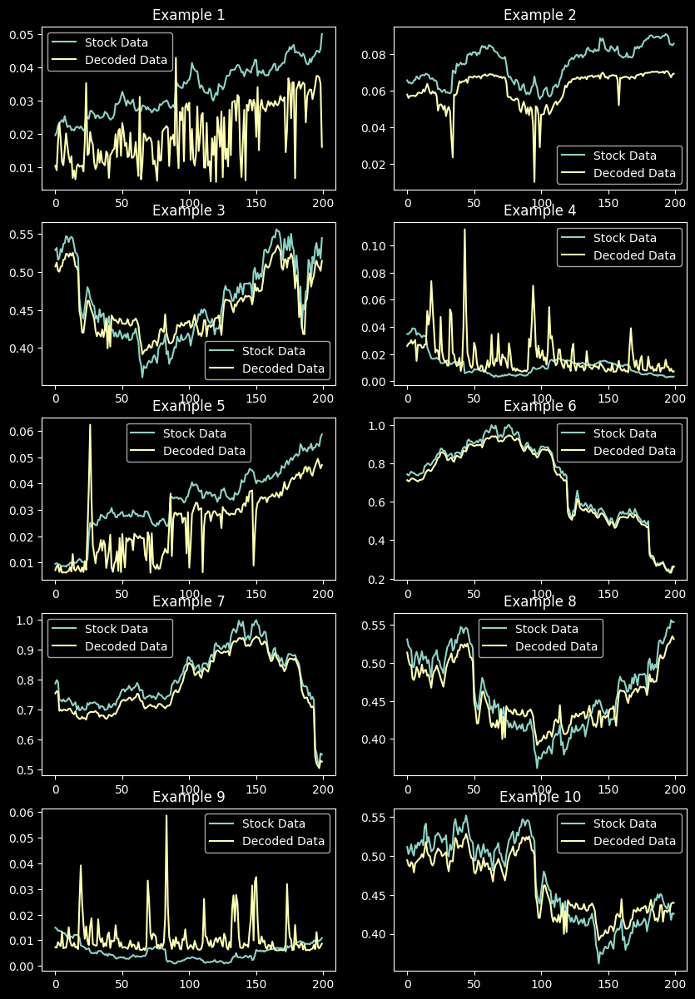

Epochs: 200 Latent Dim: 8 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0200
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0055
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0034
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0025
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0023
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0019
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0018
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0017
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0015
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0015
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - l

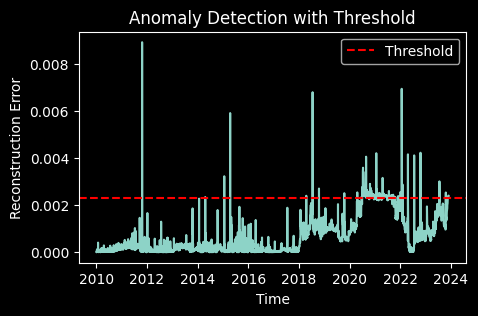

110/110 [==============================] - 0s 1ms/step


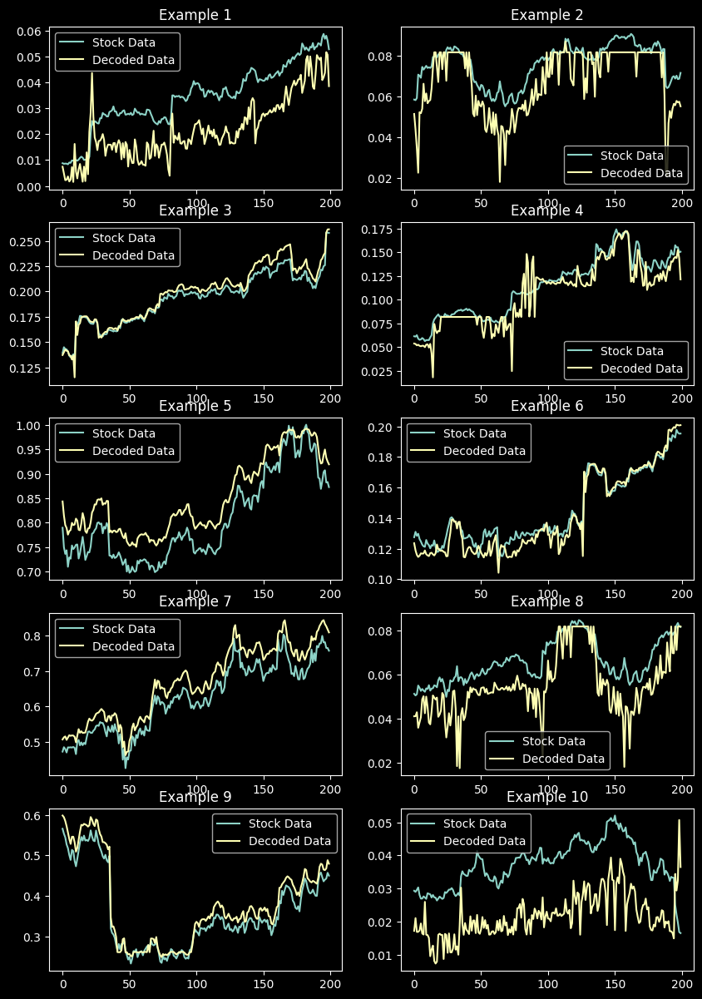

Epochs: 300 Latent Dim: 8 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/300
110/110 [==============================] - 1s 1ms/step - loss: 0.0147
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0046
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0035
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0026
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0024
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0021
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0019
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0019
Epoch 9/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0017
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0015
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - l

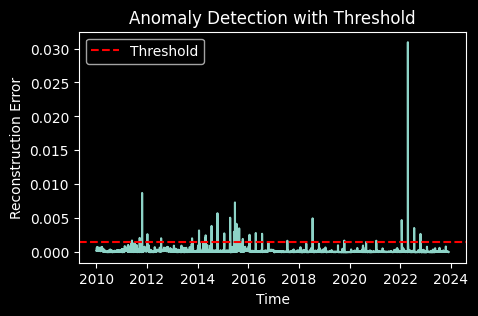

110/110 [==============================] - 0s 1ms/step


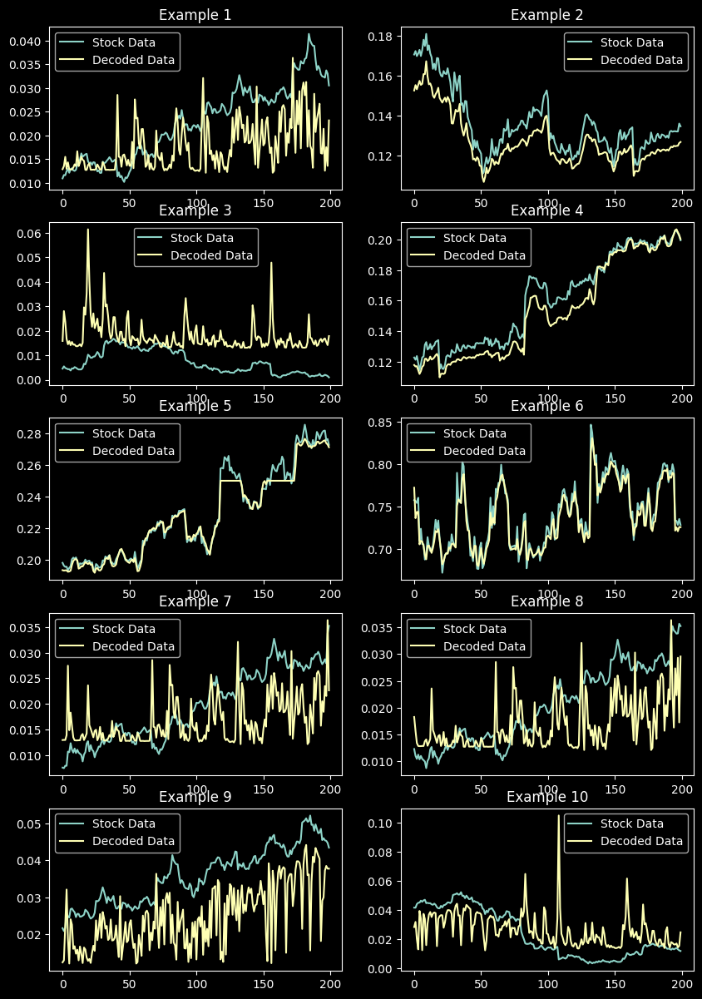

Epochs: 100 Latent Dim: 16 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/100
110/110 [==============================] - 1s 1ms/step - loss: 0.0157
Epoch 2/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0057
Epoch 3/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0035
Epoch 4/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0028
Epoch 5/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0022
Epoch 6/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0019
Epoch 7/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0018
Epoch 8/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0016
Epoch 9/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0014
Epoch 10/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0014
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - 

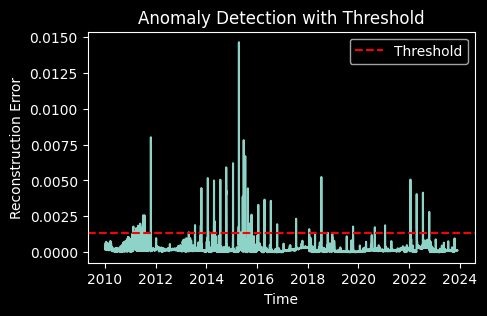

110/110 [==============================] - 0s 1ms/step


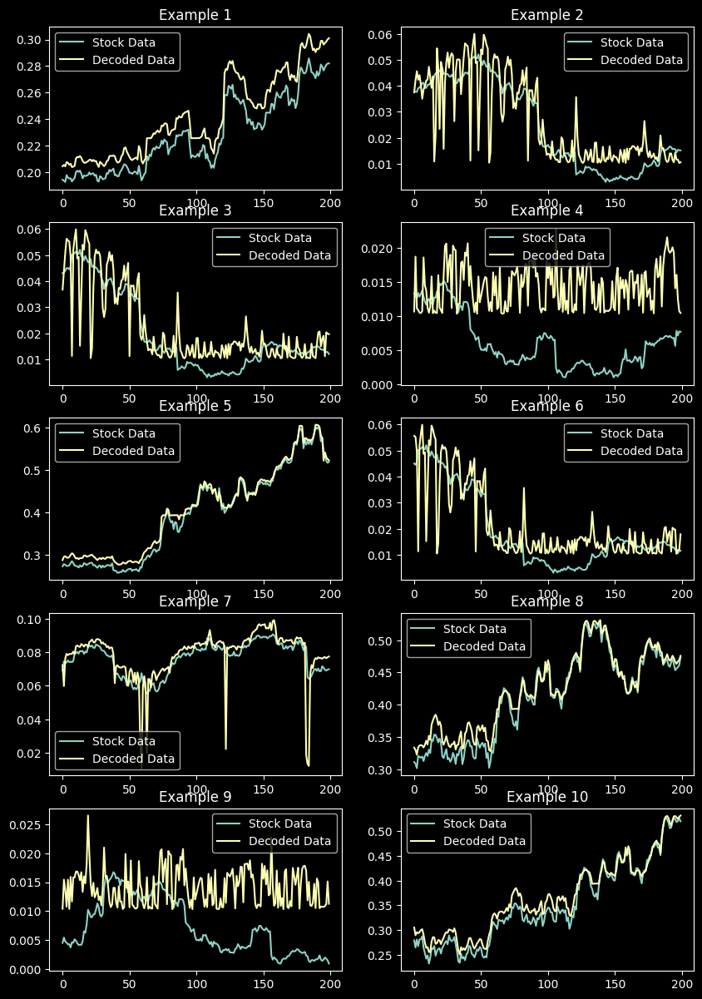

Epochs: 200 Latent Dim: 16 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/200
110/110 [==============================] - 1s 1ms/step - loss: 0.0176
Epoch 2/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0049
Epoch 3/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0035
Epoch 4/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0025
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0024
Epoch 6/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0020
Epoch 7/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0016
Epoch 8/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0017
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0015
Epoch 10/200
110/110 [==============================] - 0s 1ms/step - loss: 0.0015
Epoch 11/200
110/110 [==============================] - 0s 1ms/step - 

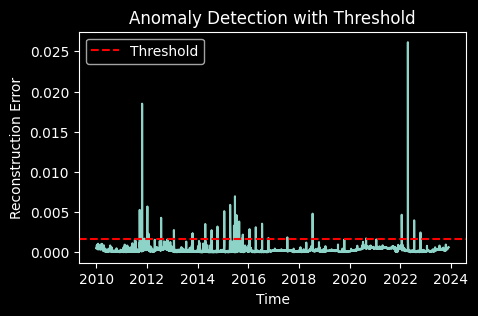

110/110 [==============================] - 0s 1ms/step


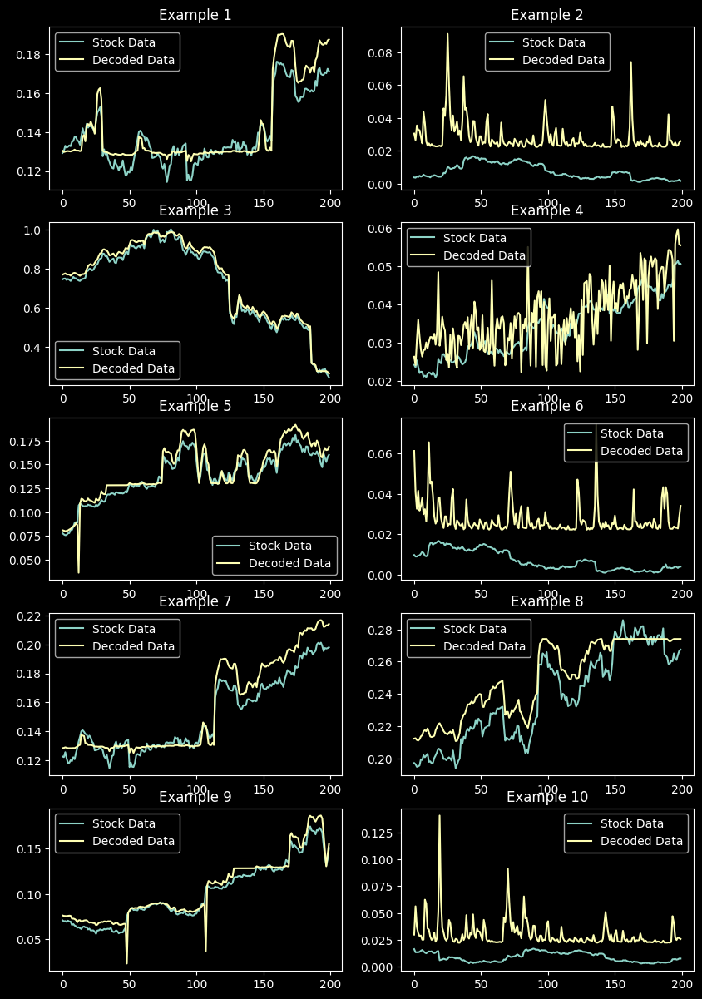

Epochs: 300 Latent Dim: 16 Optimizer: RMSprop, lr=0.01, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False
Epoch 1/300
110/110 [==============================] - 1s 1ms/step - loss: 0.0160
Epoch 2/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0050
Epoch 3/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0035
Epoch 4/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0027
Epoch 5/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0022
Epoch 6/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0021
Epoch 7/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0017
Epoch 8/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0017
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0014
Epoch 10/300
110/110 [==============================] - 0s 1ms/step - loss: 0.0014
Epoch 11/300
110/110 [==============================] - 0s 1ms/step - 

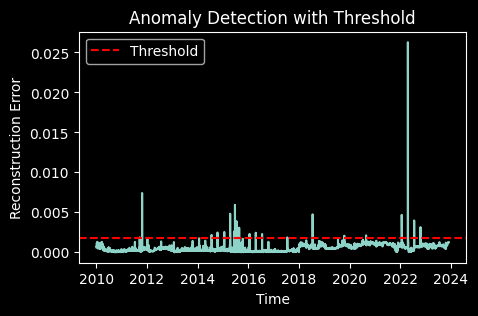

110/110 [==============================] - 0s 1ms/step


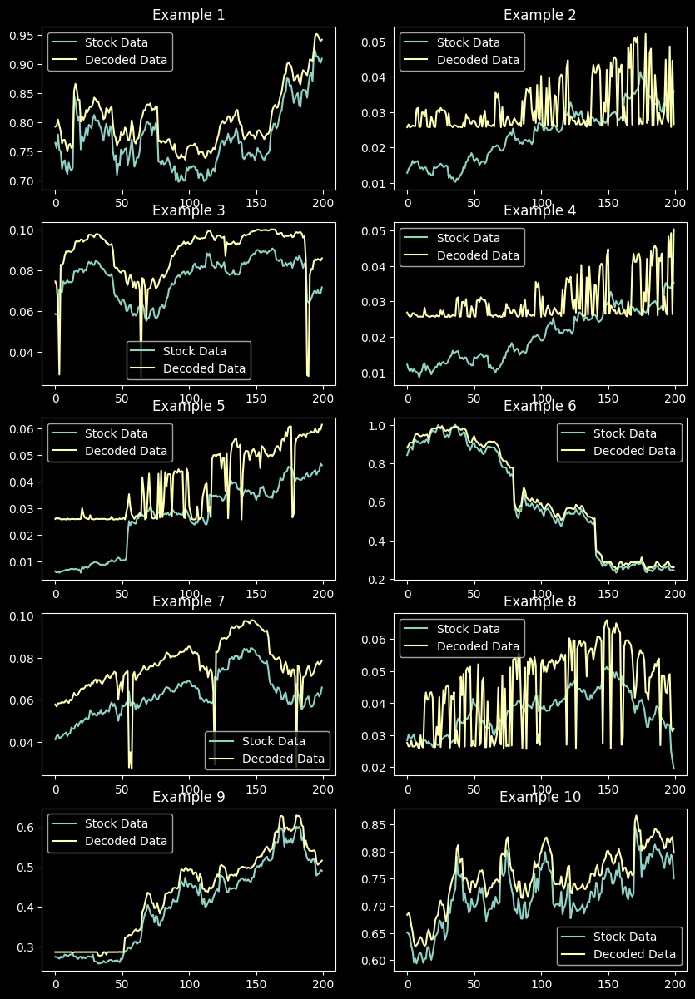

Epochs: 100 Latent Dim: 1 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/100
110/110 [==============================] - 1s 2ms/step - loss: 0.1205
Epoch 2/100
110/110 [==============================] - 0s 2ms/step - loss: 0.1090
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0961
Epoch 4/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0836
Epoch 5/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0731
Epoch 6/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0649
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0588
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0544
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0509
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0478
Epoch 11/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0448
Epoch 12/100
110

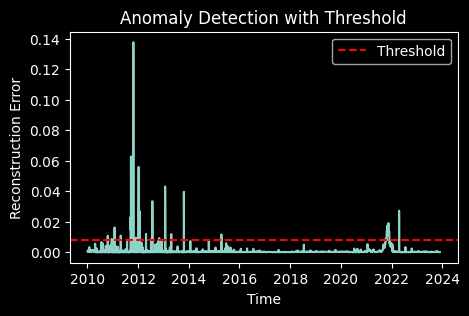

110/110 [==============================] - 0s 2ms/step


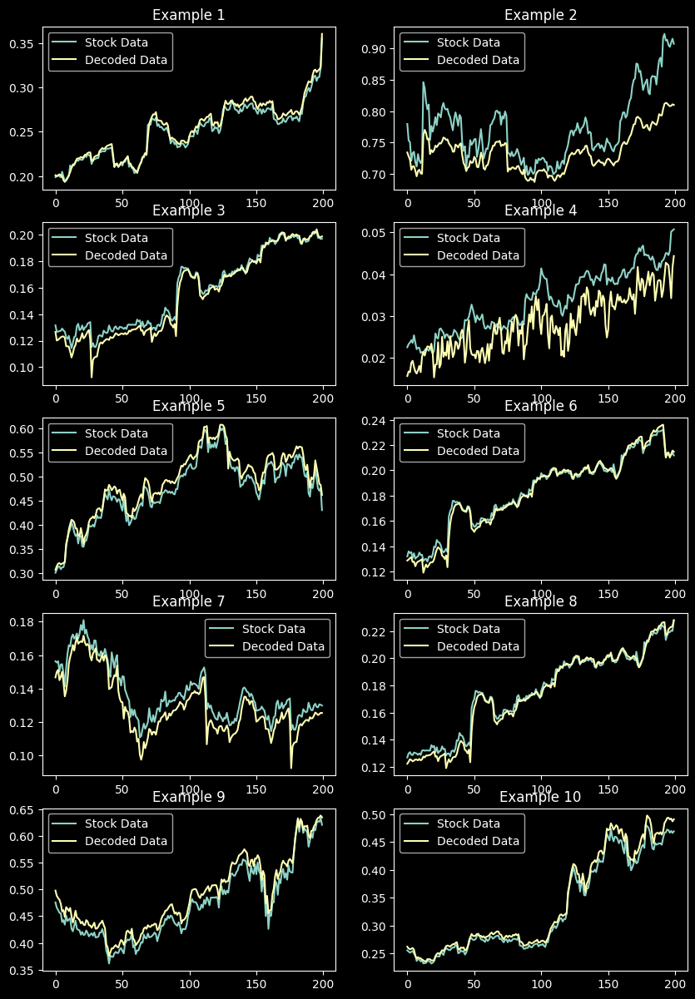

Epochs: 200 Latent Dim: 1 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/200
110/110 [==============================] - 1s 2ms/step - loss: 0.1240
Epoch 2/200
110/110 [==============================] - 0s 2ms/step - loss: 0.1213
Epoch 3/200
110/110 [==============================] - 0s 2ms/step - loss: 0.1186
Epoch 4/200
110/110 [==============================] - 0s 2ms/step - loss: 0.1157
Epoch 5/200
110/110 [==============================] - 0s 1ms/step - loss: 0.1129
Epoch 6/200
110/110 [==============================] - 0s 2ms/step - loss: 0.1100
Epoch 7/200
110/110 [==============================] - 0s 2ms/step - loss: 0.1071
Epoch 8/200
110/110 [==============================] - 0s 2ms/step - loss: 0.1043
Epoch 9/200
110/110 [==============================] - 0s 1ms/step - loss: 0.1015
Epoch 10/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0988
Epoch 11/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0961
Epoch 12/200
110

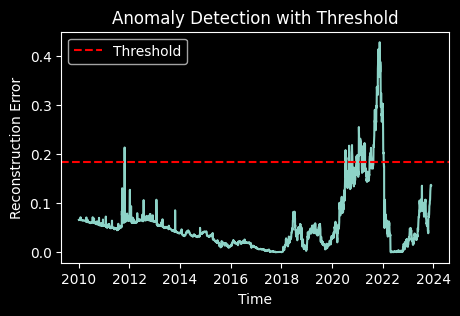

110/110 [==============================] - 0s 2ms/step


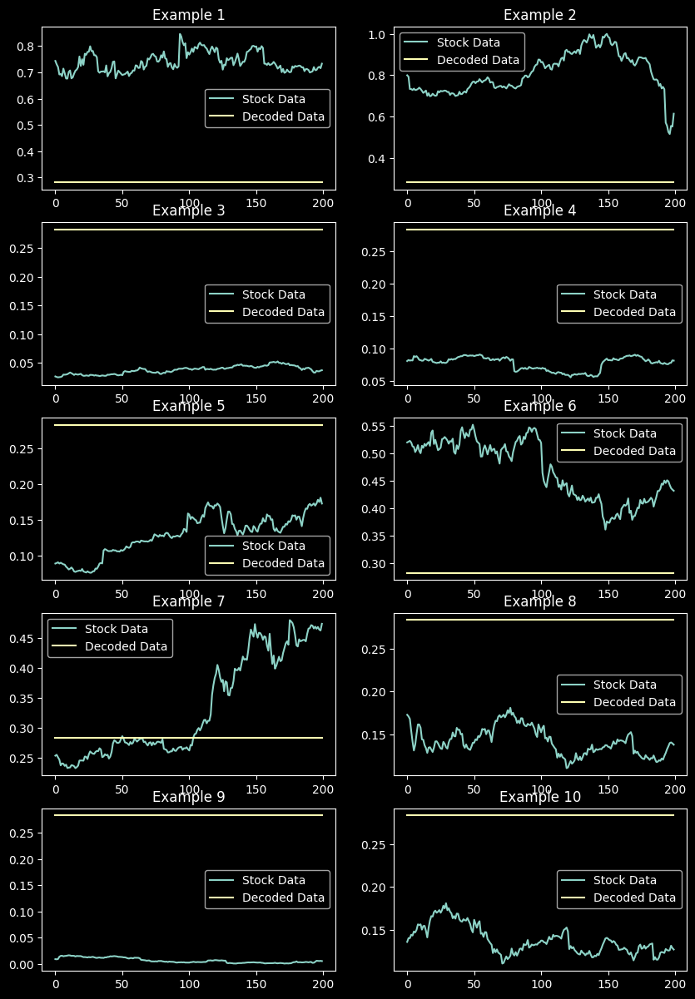

Epochs: 300 Latent Dim: 1 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/300
110/110 [==============================] - 1s 3ms/step - loss: 0.1239
Epoch 2/300
110/110 [==============================] - 0s 2ms/step - loss: 0.1212
Epoch 3/300
110/110 [==============================] - 0s 2ms/step - loss: 0.1183
Epoch 4/300
110/110 [==============================] - 0s 2ms/step - loss: 0.1154
Epoch 5/300
110/110 [==============================] - 0s 2ms/step - loss: 0.1125
Epoch 6/300
110/110 [==============================] - 0s 2ms/step - loss: 0.1097
Epoch 7/300
110/110 [==============================] - 0s 2ms/step - loss: 0.1068
Epoch 8/300
110/110 [==============================] - 0s 2ms/step - loss: 0.1040
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 0.1012
Epoch 10/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0985
Epoch 11/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0959
Epoch 12/300
110

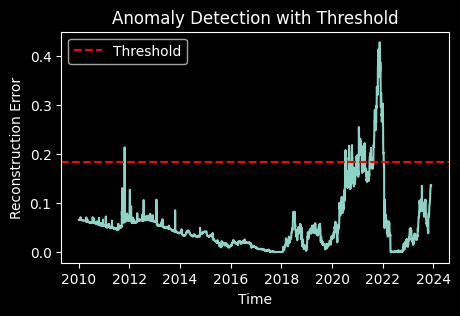

110/110 [==============================] - 0s 2ms/step


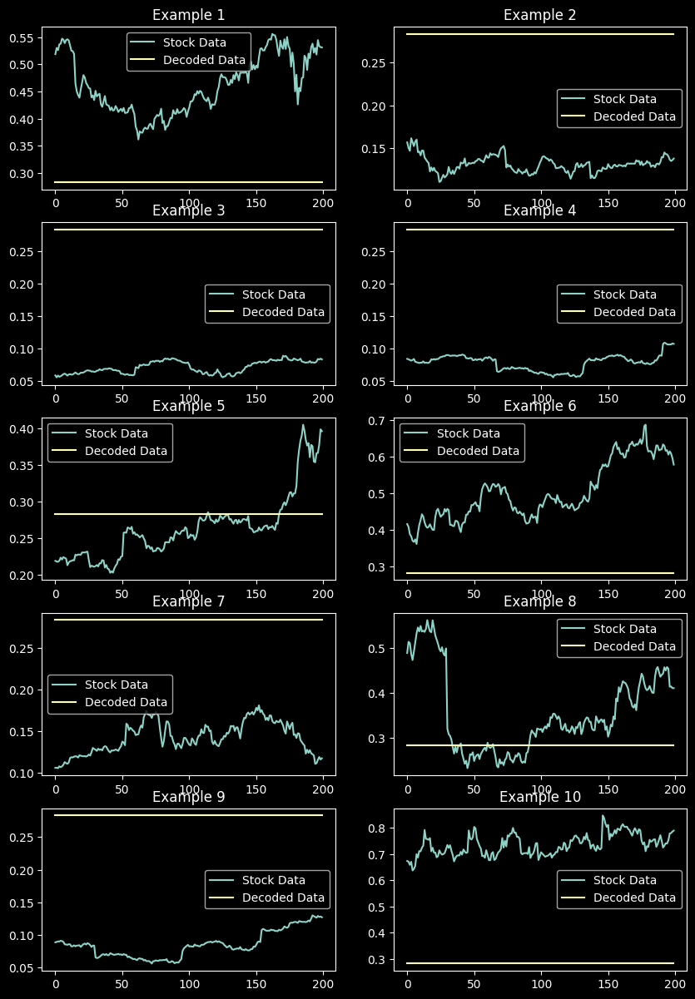

Epochs: 100 Latent Dim: 2 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/100
110/110 [==============================] - 1s 3ms/step - loss: 0.1184
Epoch 2/100
110/110 [==============================] - 0s 2ms/step - loss: 0.1038
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0865
Epoch 4/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0670
Epoch 5/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0480
Epoch 6/100
110/110 [==============================] - 0s 3ms/step - loss: 0.0344
Epoch 7/100
110/110 [==============================] - 0s 3ms/step - loss: 0.0257
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0186
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0123
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0075
Epoch 11/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0048
Epoch 12/100
110

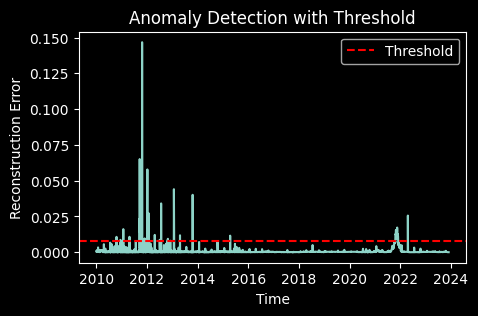

110/110 [==============================] - 0s 1ms/step


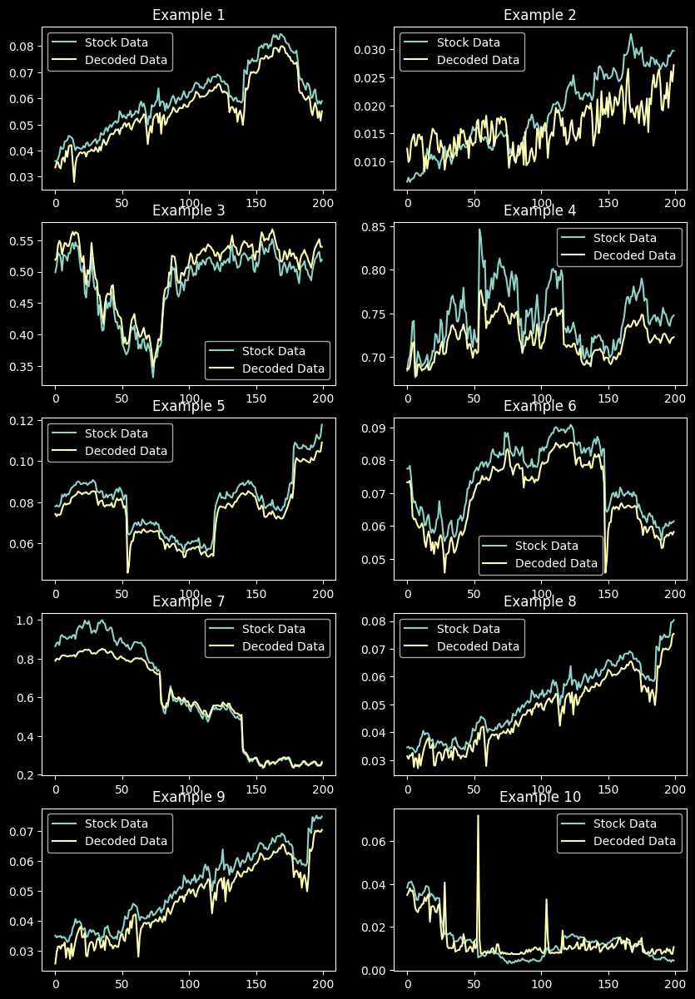

Epochs: 200 Latent Dim: 2 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/200
110/110 [==============================] - 1s 2ms/step - loss: 0.1165
Epoch 2/200
110/110 [==============================] - 0s 3ms/step - loss: 0.1003
Epoch 3/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0828
Epoch 4/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0648
Epoch 5/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0485
Epoch 6/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0369
Epoch 7/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0289
Epoch 8/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0226
Epoch 9/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0167
Epoch 10/200
110/110 [==============================] - 0s 3ms/step - loss: 0.0116
Epoch 11/200
110/110 [==============================] - 0s 4ms/step - loss: 0.0078
Epoch 12/200
110

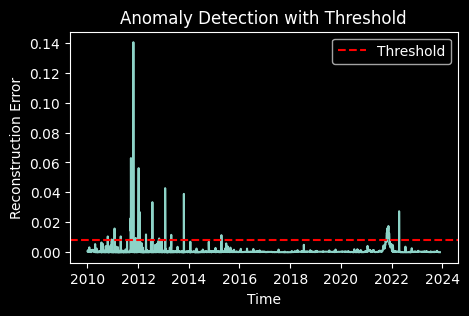

110/110 [==============================] - 0s 2ms/step


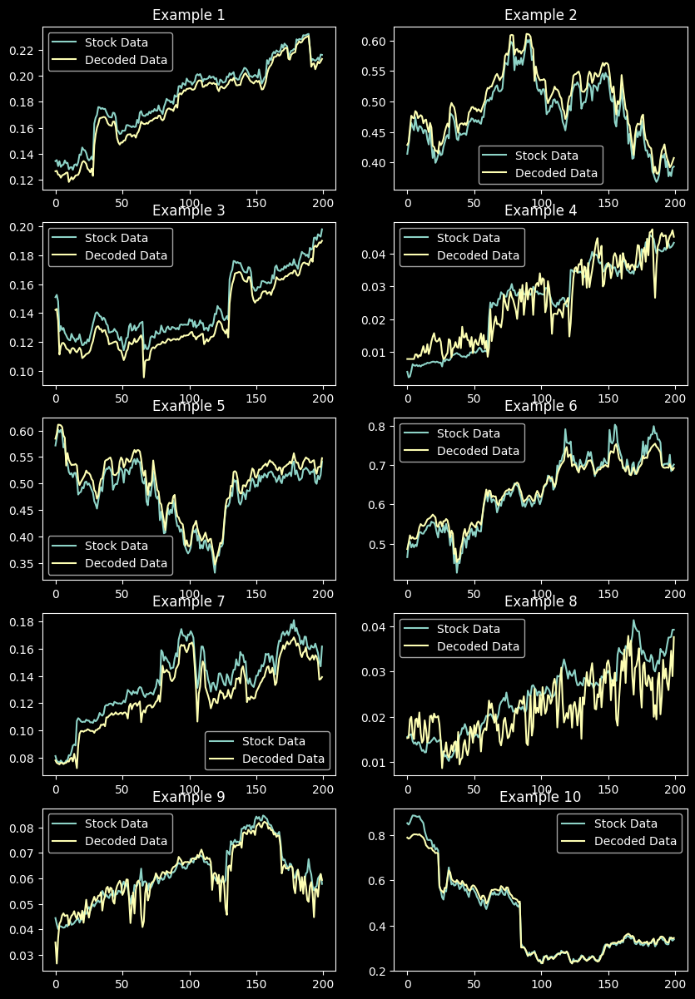

Epochs: 300 Latent Dim: 2 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.1171
Epoch 2/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0988
Epoch 3/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0780
Epoch 4/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0571
Epoch 5/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0407
Epoch 6/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0297
Epoch 7/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0206
Epoch 8/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0127
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0077
Epoch 10/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0049
Epoch 11/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0033
Epoch 12/300
110

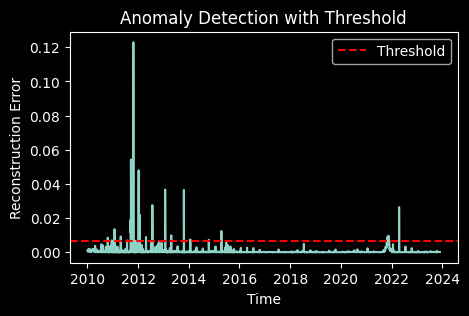

110/110 [==============================] - 0s 3ms/step


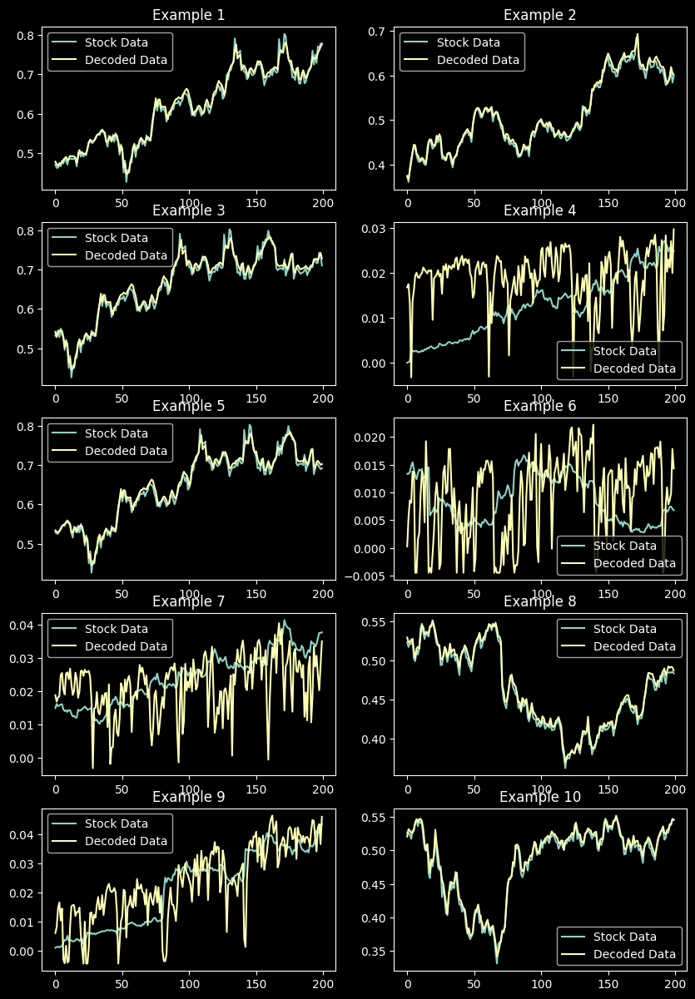

Epochs: 100 Latent Dim: 4 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/100
110/110 [==============================] - 1s 2ms/step - loss: 0.1182
Epoch 2/100
110/110 [==============================] - 0s 2ms/step - loss: 0.1045
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0913
Epoch 4/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0786
Epoch 5/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0674
Epoch 6/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0580
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0506
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0445
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0387
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0326
Epoch 11/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0261
Epoch 12/100
110

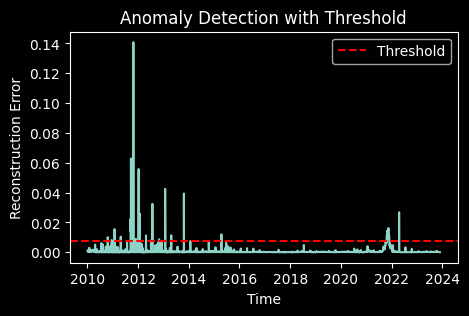

110/110 [==============================] - 0s 2ms/step


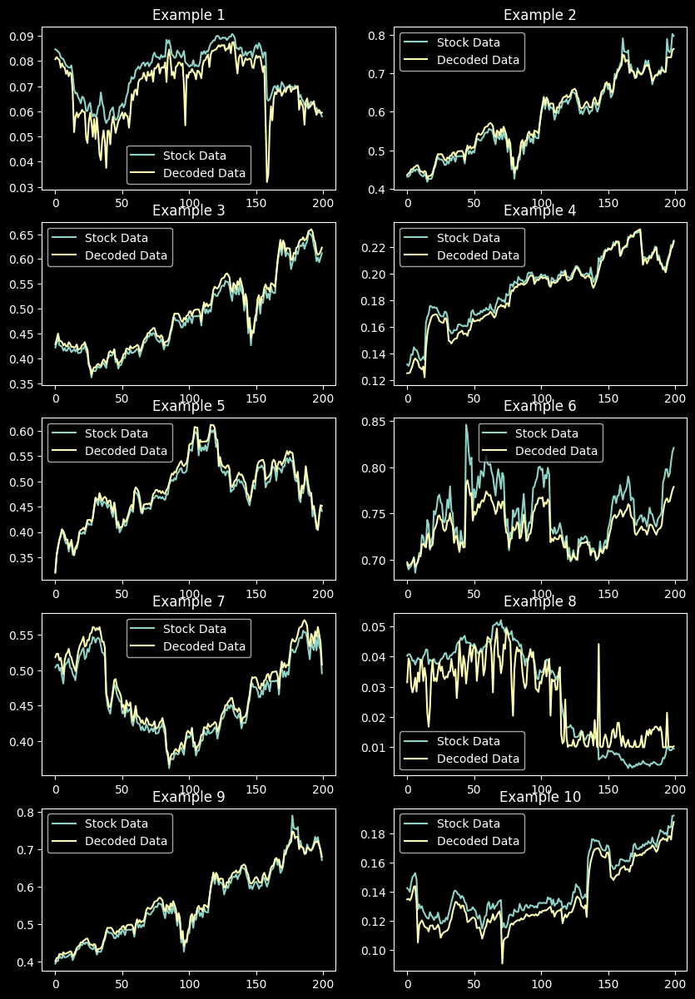

Epochs: 200 Latent Dim: 4 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/200
110/110 [==============================] - 1s 2ms/step - loss: 0.1216
Epoch 2/200
110/110 [==============================] - 0s 2ms/step - loss: 0.1104
Epoch 3/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0982
Epoch 4/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0852
Epoch 5/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0713
Epoch 6/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0572
Epoch 7/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0441
Epoch 8/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0330
Epoch 9/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0240
Epoch 10/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0167
Epoch 11/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0111
Epoch 12/200
110

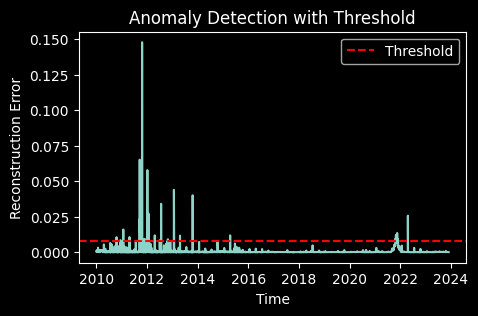

110/110 [==============================] - 0s 1ms/step


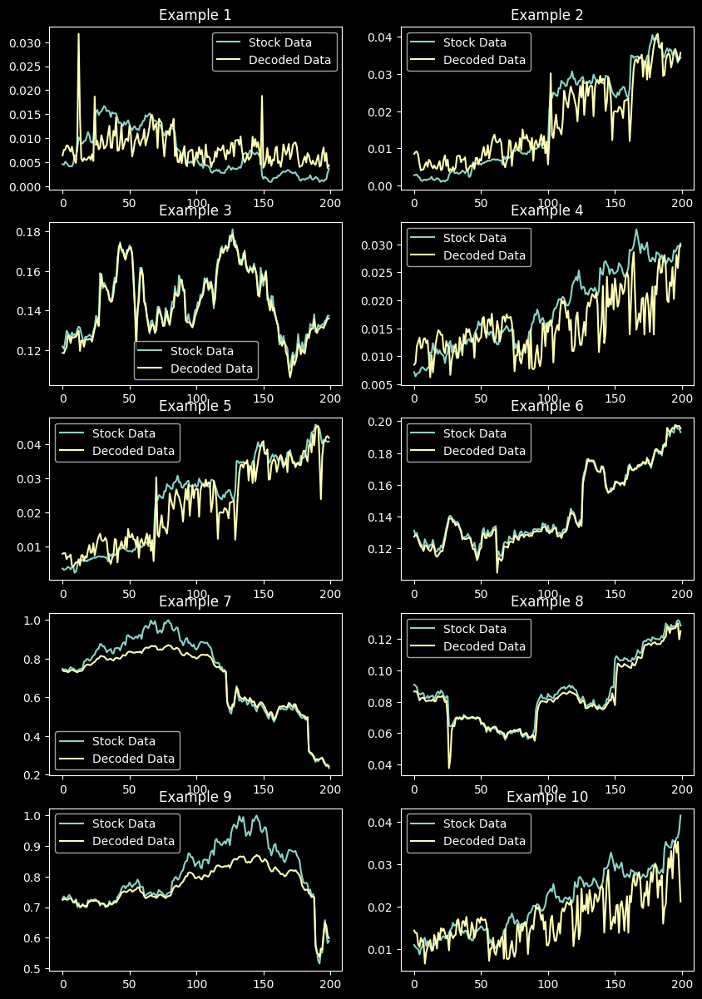

Epochs: 300 Latent Dim: 4 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.1217
Epoch 2/300
110/110 [==============================] - 0s 2ms/step - loss: 0.1079
Epoch 3/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0953
Epoch 4/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0821
Epoch 5/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0689
Epoch 6/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0565
Epoch 7/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0460
Epoch 8/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0375
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0303
Epoch 10/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0239
Epoch 11/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0182
Epoch 12/300
110

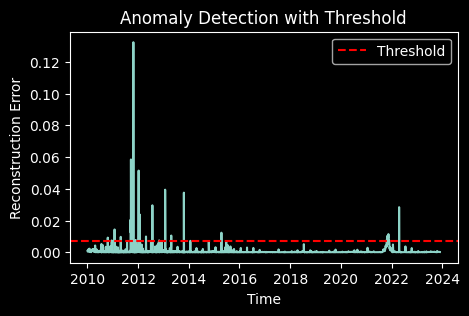

110/110 [==============================] - 0s 2ms/step


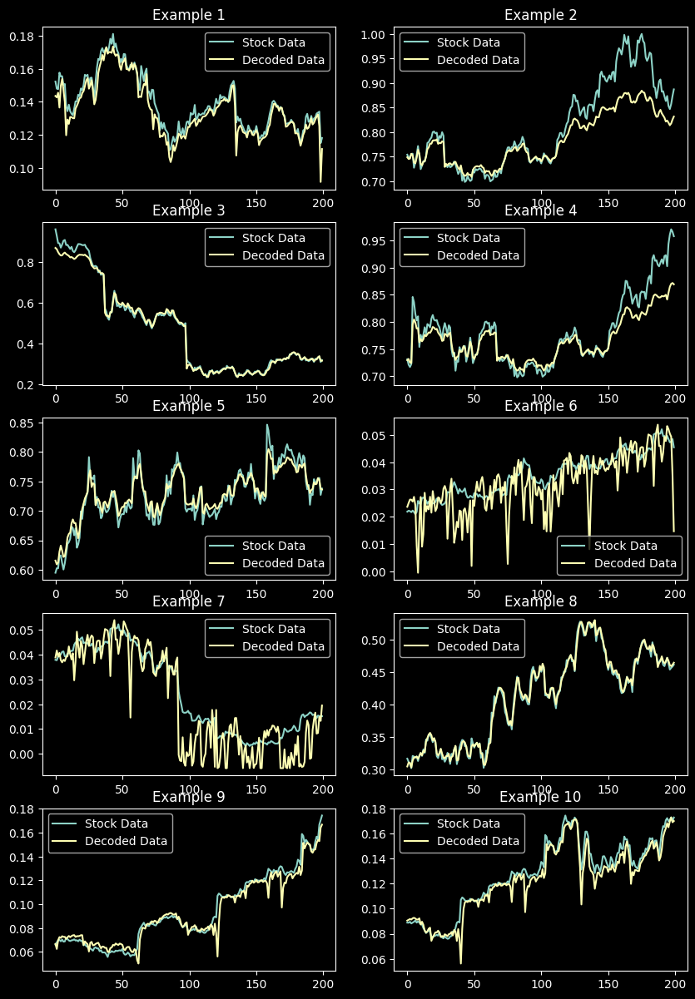

Epochs: 100 Latent Dim: 8 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/100
110/110 [==============================] - 1s 2ms/step - loss: 0.1168
Epoch 2/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0977
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0715
Epoch 4/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0429
Epoch 5/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0260
Epoch 6/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0171
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0107
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0064
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0039
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0025
Epoch 11/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0019
Epoch 12/100
110

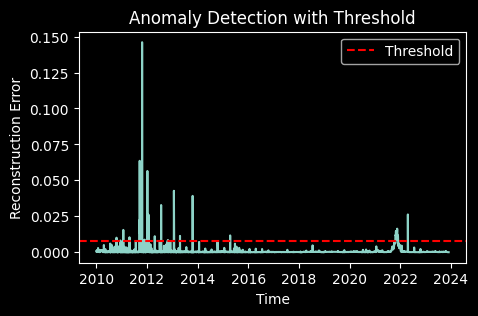

110/110 [==============================] - 0s 2ms/step


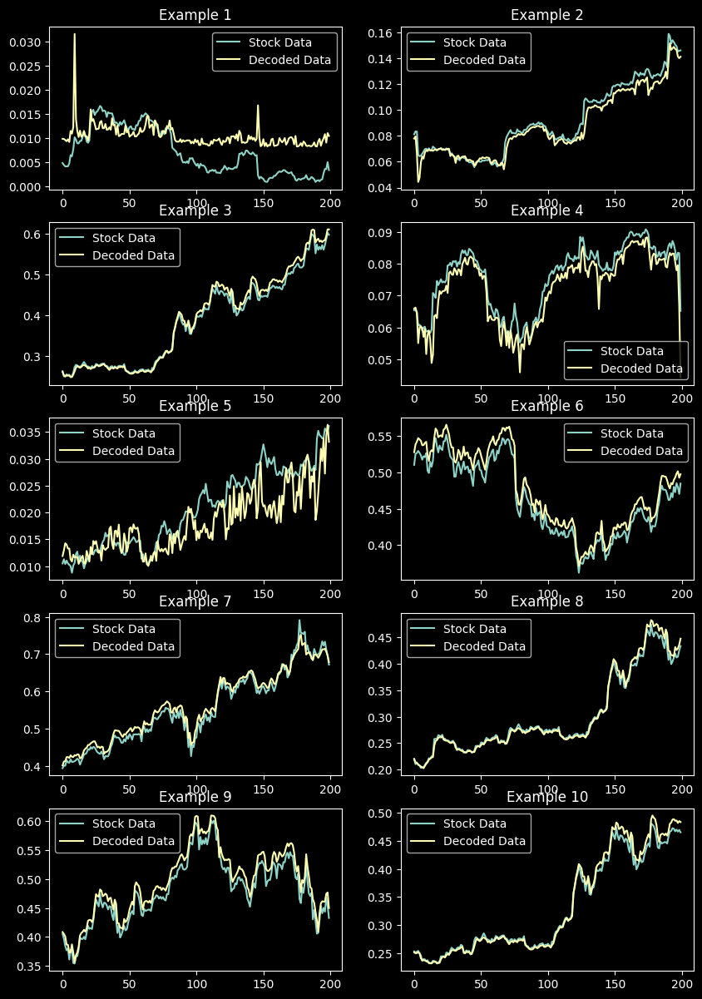

Epochs: 200 Latent Dim: 8 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/200
110/110 [==============================] - 1s 2ms/step - loss: 0.1196
Epoch 2/200
110/110 [==============================] - 0s 2ms/step - loss: 0.1065
Epoch 3/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0929
Epoch 4/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0785
Epoch 5/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0645
Epoch 6/200
110/110 [==============================] - 0s 3ms/step - loss: 0.0524
Epoch 7/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0432
Epoch 8/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0360
Epoch 9/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0296
Epoch 10/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0230
Epoch 11/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0166
Epoch 12/200
110

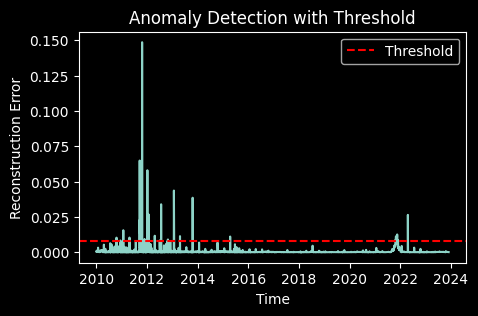

110/110 [==============================] - 0s 1ms/step


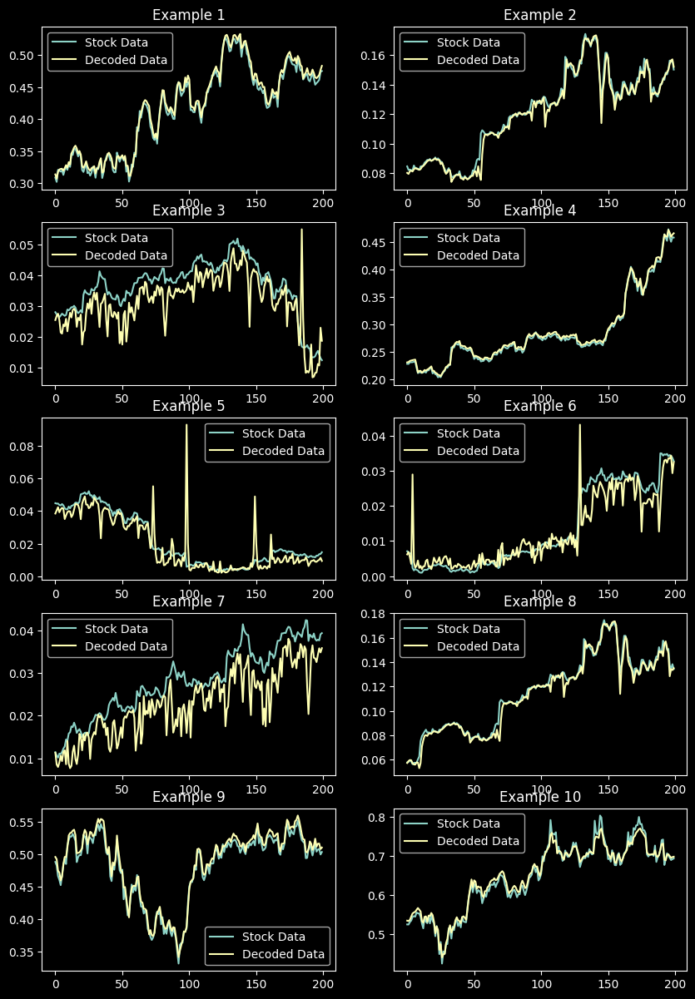

Epochs: 300 Latent Dim: 8 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.1206
Epoch 2/300
110/110 [==============================] - 0s 2ms/step - loss: 0.1074
Epoch 3/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0943
Epoch 4/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0813
Epoch 5/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0690
Epoch 6/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0580
Epoch 7/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0486
Epoch 8/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0408
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0337
Epoch 10/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0270
Epoch 11/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0205
Epoch 12/300
110

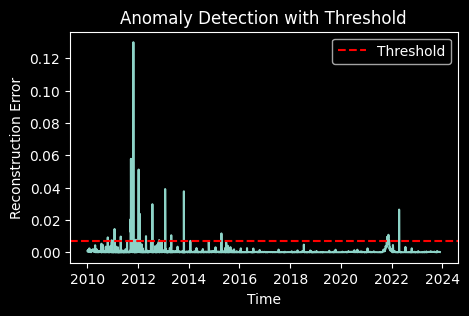

110/110 [==============================] - 0s 2ms/step


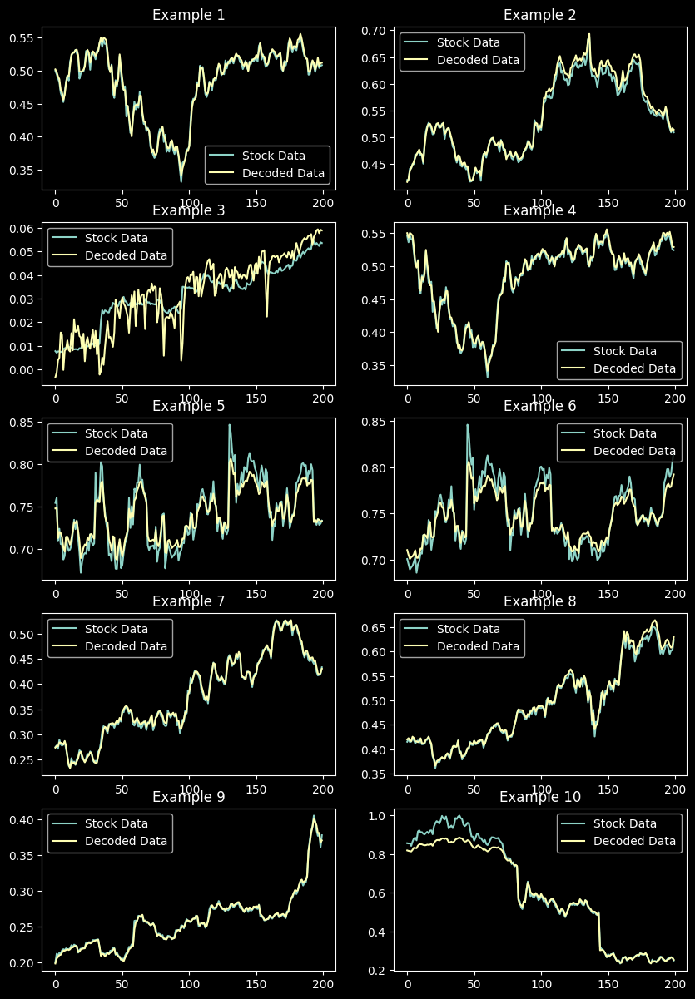

Epochs: 100 Latent Dim: 16 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/100
110/110 [==============================] - 1s 2ms/step - loss: 0.1162
Epoch 2/100
110/110 [==============================] - 0s 2ms/step - loss: 0.1000
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0851
Epoch 4/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0715
Epoch 5/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0598
Epoch 6/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0501
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0425
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0358
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0289
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0218
Epoch 11/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0152
Epoch 12/100
11

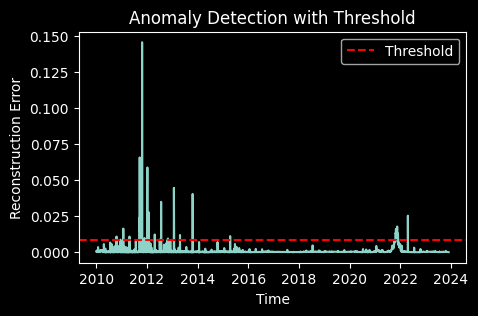

110/110 [==============================] - 0s 2ms/step


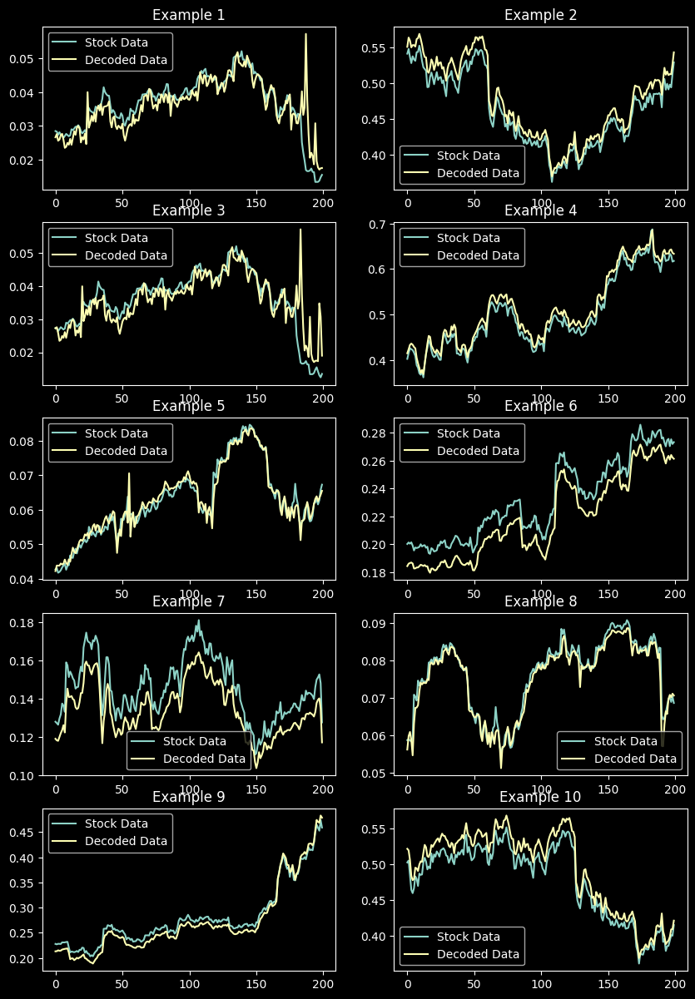

Epochs: 200 Latent Dim: 16 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/200
110/110 [==============================] - 1s 2ms/step - loss: 0.1203
Epoch 2/200
110/110 [==============================] - 0s 2ms/step - loss: 0.1049
Epoch 3/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0909
Epoch 4/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0788
Epoch 5/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0687
Epoch 6/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0604
Epoch 7/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0538
Epoch 8/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0480
Epoch 9/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0422
Epoch 10/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0360
Epoch 11/200
110/110 [==============================] - 0s 3ms/step - loss: 0.0296
Epoch 12/200
11

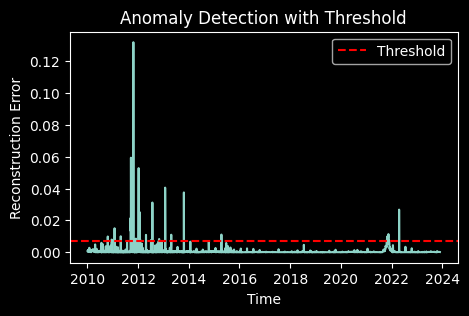

110/110 [==============================] - 0s 2ms/step


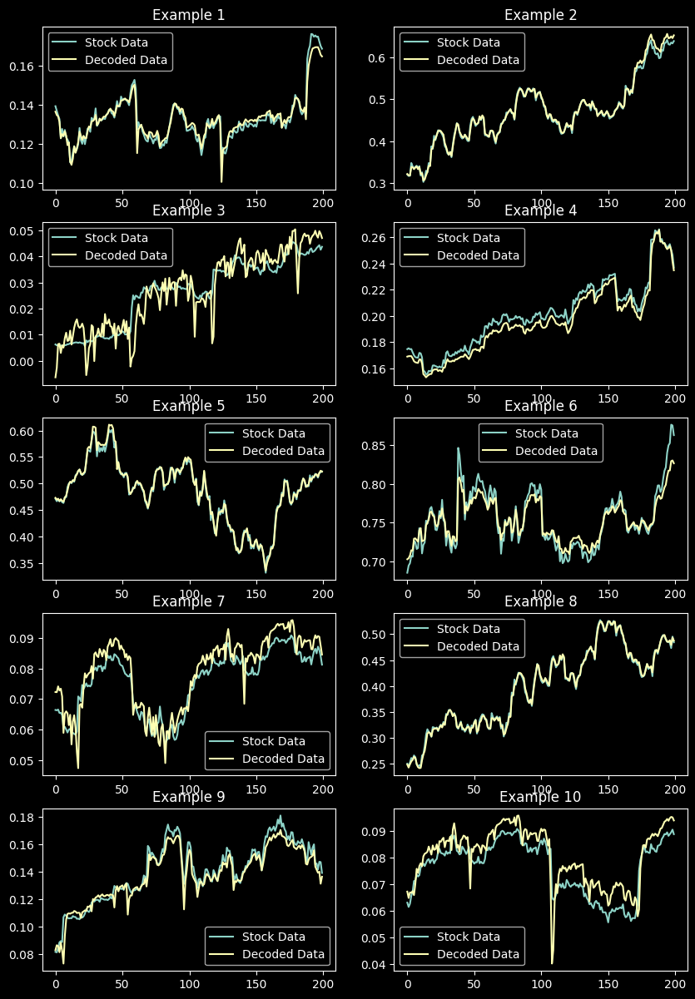

Epochs: 300 Latent Dim: 16 Optimizer: Adadelta, lr=0.01, rho=0.95, epsilon=1e-06
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.1175
Epoch 2/300
110/110 [==============================] - 0s 2ms/step - loss: 0.1030
Epoch 3/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0863
Epoch 4/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0697
Epoch 5/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0548
Epoch 6/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0437
Epoch 7/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0360
Epoch 8/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0293
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0226
Epoch 10/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0164
Epoch 11/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0112
Epoch 12/300
11

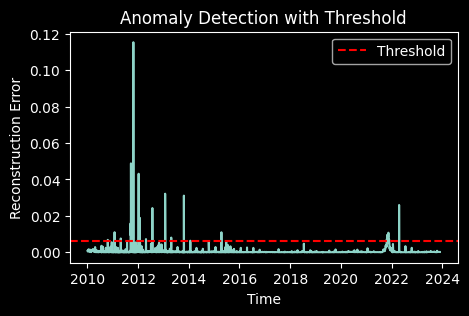

110/110 [==============================] - 0s 2ms/step


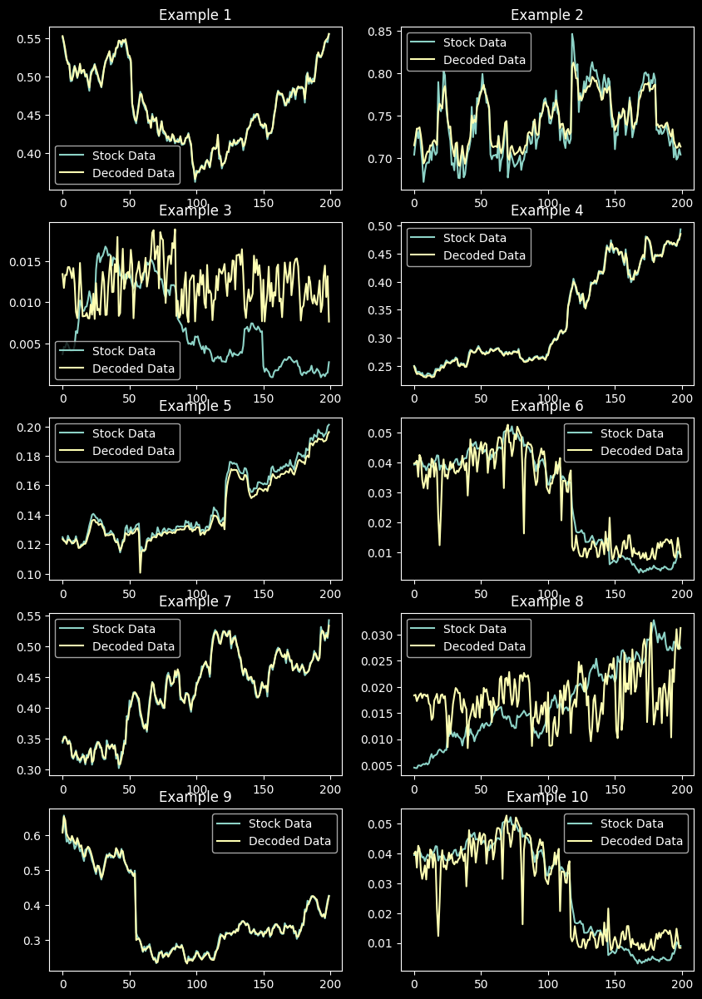

Epochs: 100 Latent Dim: 1 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/100
110/110 [==============================] - 1s 2ms/step - loss: 0.0666
Epoch 2/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0361
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0155
Epoch 4/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0045
Epoch 5/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0022
Epoch 6/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0018
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0016
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0015
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0014
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0013
Epoch 11/100
110/110 [==============================] - 0s 1ms/step - loss: 0.0

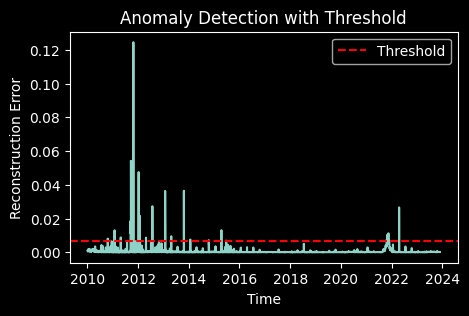

110/110 [==============================] - 0s 2ms/step


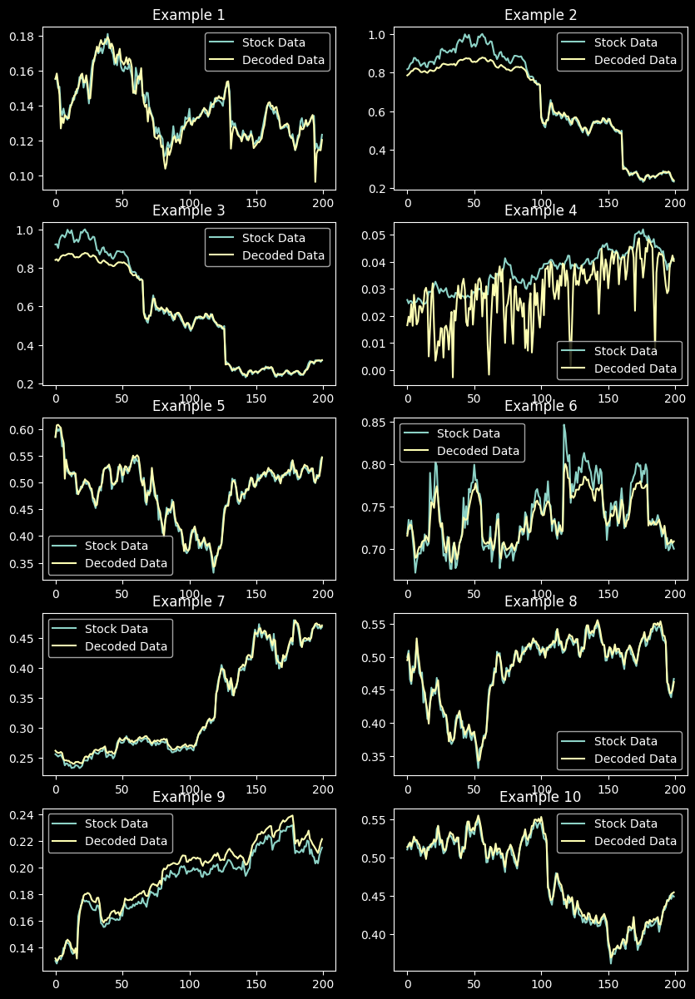

Epochs: 200 Latent Dim: 1 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/200
110/110 [==============================] - 1s 2ms/step - loss: 0.0791
Epoch 2/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0536
Epoch 3/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0424
Epoch 4/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0270
Epoch 5/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0120
Epoch 6/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0047
Epoch 7/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0026
Epoch 8/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0020
Epoch 9/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0017
Epoch 10/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0015
Epoch 11/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0

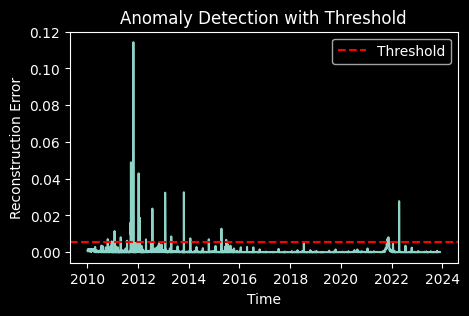

110/110 [==============================] - 0s 2ms/step


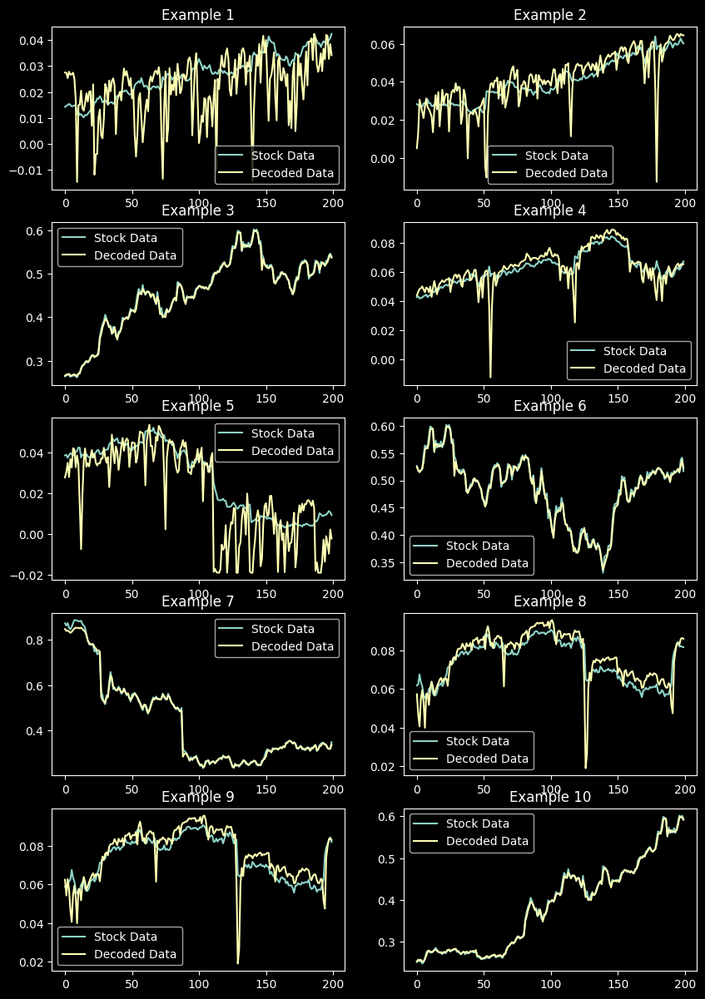

Epochs: 300 Latent Dim: 1 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.0938
Epoch 2/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0715
Epoch 3/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0643
Epoch 4/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0612
Epoch 5/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0597
Epoch 6/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0590
Epoch 7/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0585
Epoch 8/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0583
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 10/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0582
Epoch 11/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0

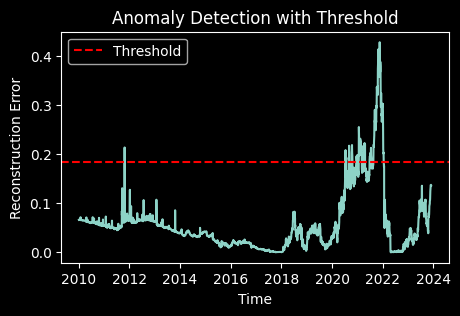

110/110 [==============================] - 0s 2ms/step


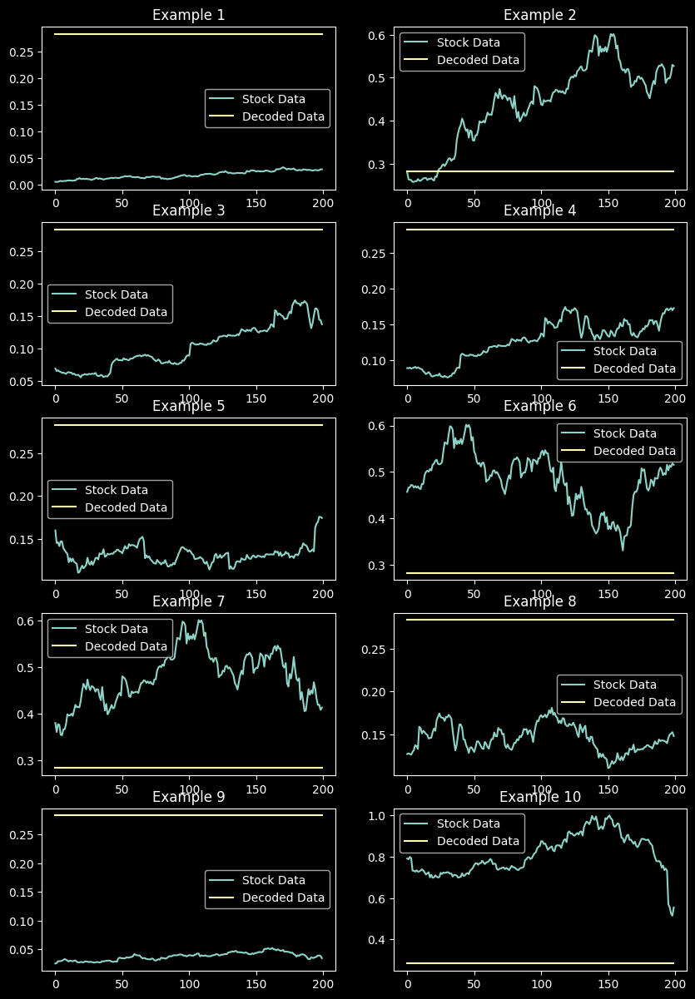

Epochs: 100 Latent Dim: 2 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/100
110/110 [==============================] - 1s 2ms/step - loss: 0.0726
Epoch 2/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0492
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0365
Epoch 4/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0200
Epoch 5/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0079
Epoch 6/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0034
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0023
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0019
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0016
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0015
Epoch 11/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0

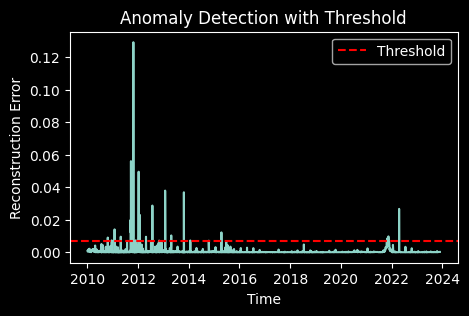

110/110 [==============================] - 0s 2ms/step


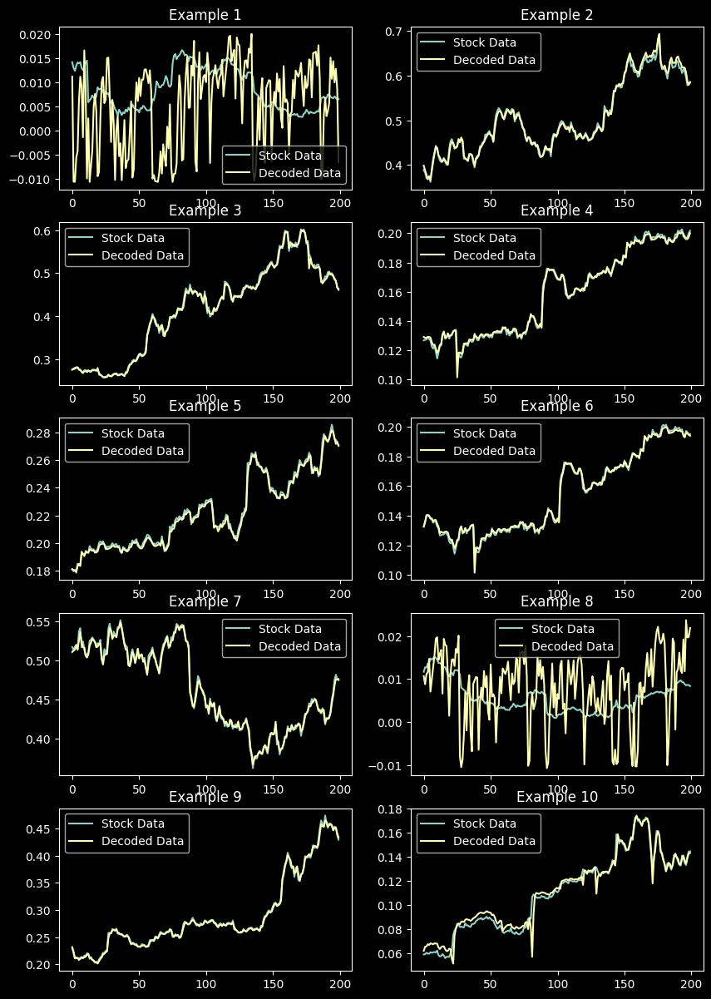

Epochs: 200 Latent Dim: 2 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/200
110/110 [==============================] - 1s 2ms/step - loss: 0.0786
Epoch 2/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0554
Epoch 3/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0480
Epoch 4/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0357
Epoch 5/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0195
Epoch 6/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0076
Epoch 7/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0035
Epoch 8/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0025
Epoch 9/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0020
Epoch 10/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0018
Epoch 11/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0

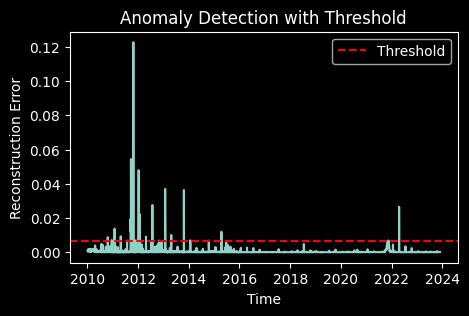

110/110 [==============================] - 0s 2ms/step


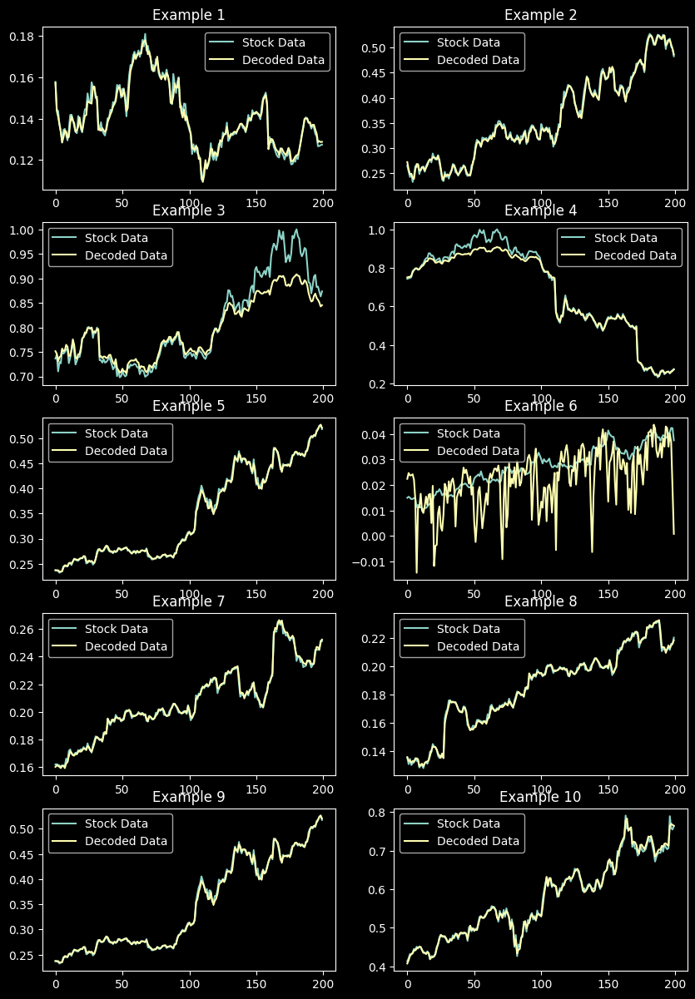

Epochs: 300 Latent Dim: 2 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.0676
Epoch 2/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0358
Epoch 3/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0134
Epoch 4/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0037
Epoch 5/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0019
Epoch 6/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0015
Epoch 7/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0014
Epoch 8/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0013
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0012
Epoch 10/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0012
Epoch 11/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0

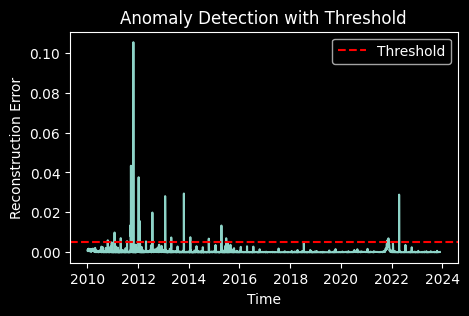

110/110 [==============================] - 0s 2ms/step


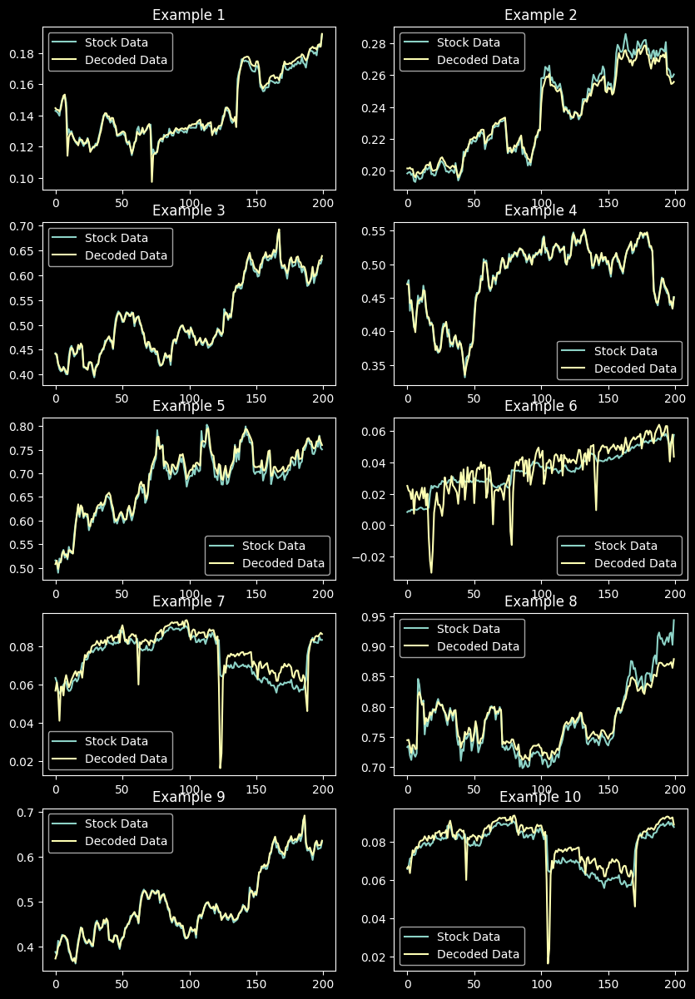

Epochs: 100 Latent Dim: 4 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/100
110/110 [==============================] - 1s 2ms/step - loss: 0.0744
Epoch 2/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0444
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0263
Epoch 4/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0103
Epoch 5/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0038
Epoch 6/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0021
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0016
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0014
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0013
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0012
Epoch 11/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0

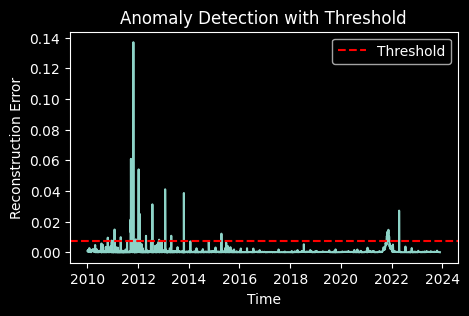

110/110 [==============================] - 0s 2ms/step


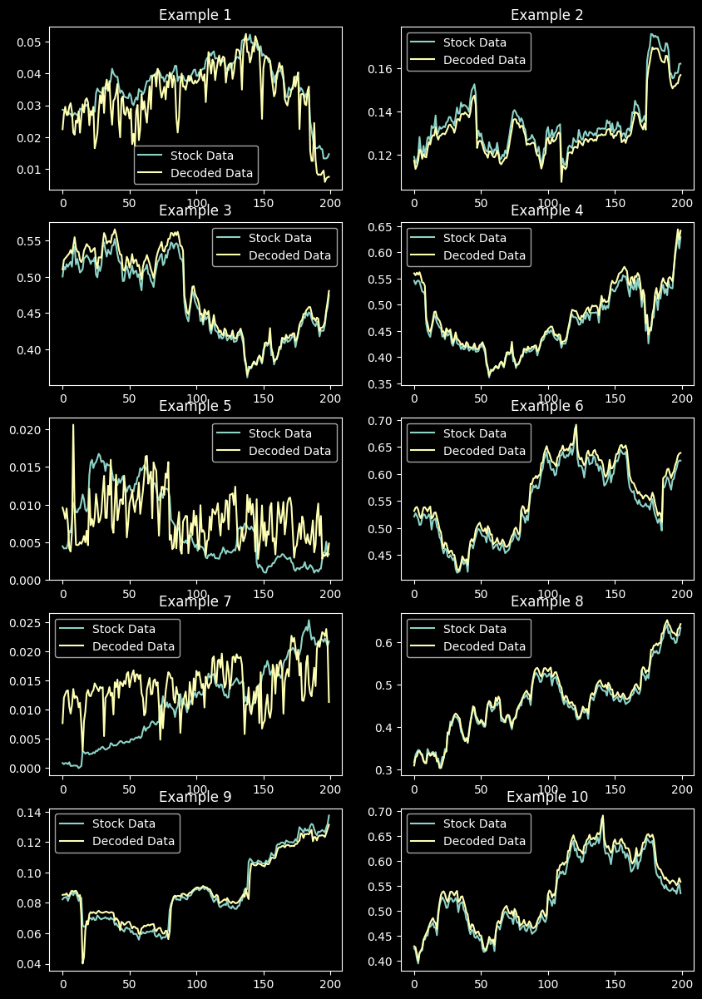

Epochs: 200 Latent Dim: 4 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/200
110/110 [==============================] - 1s 2ms/step - loss: 0.0732
Epoch 2/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0584
Epoch 3/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0581
Epoch 4/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0581
Epoch 5/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0581
Epoch 6/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0581
Epoch 7/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0581
Epoch 8/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0581
Epoch 9/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0581
Epoch 10/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0581
Epoch 11/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0

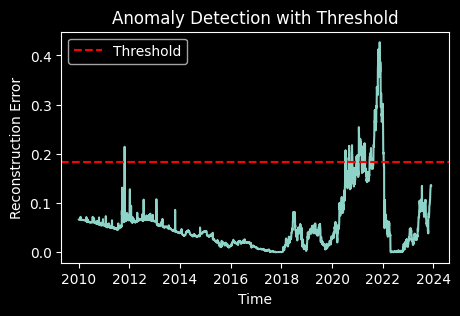

110/110 [==============================] - 0s 2ms/step


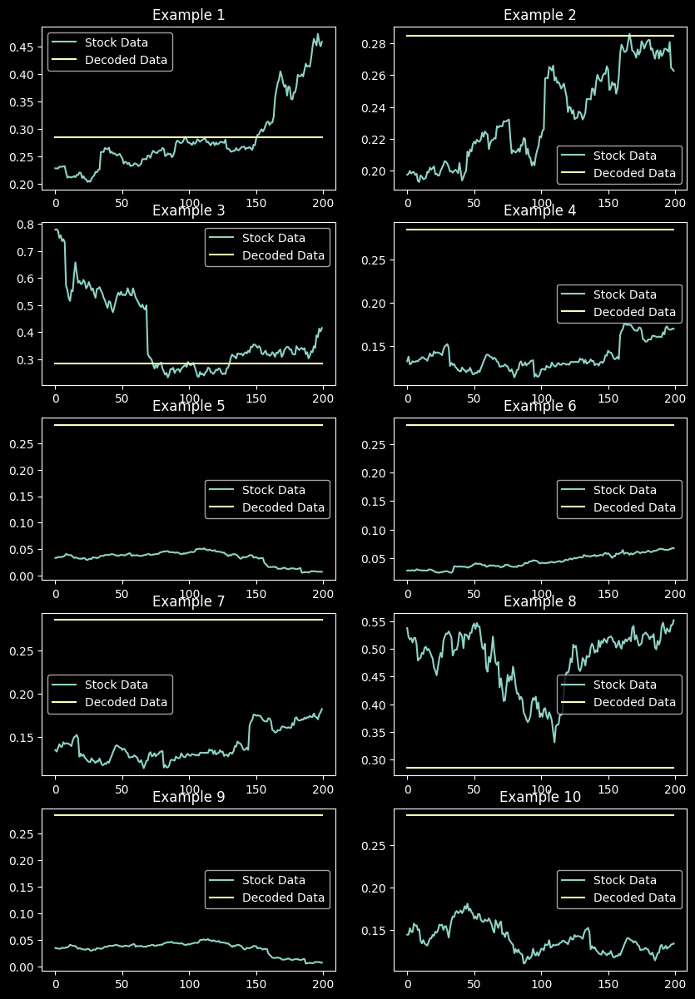

Epochs: 300 Latent Dim: 4 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.0624
Epoch 2/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0267
Epoch 3/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0069
Epoch 4/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0022
Epoch 5/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0015
Epoch 6/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0014
Epoch 7/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0013
Epoch 8/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0012
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0012
Epoch 10/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0011
Epoch 11/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0

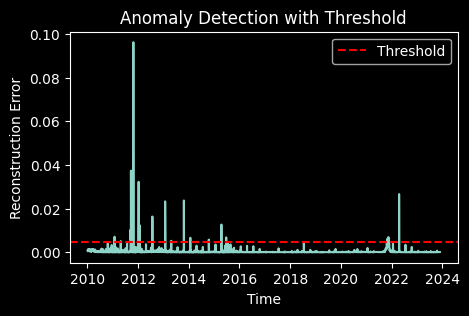

110/110 [==============================] - 0s 2ms/step


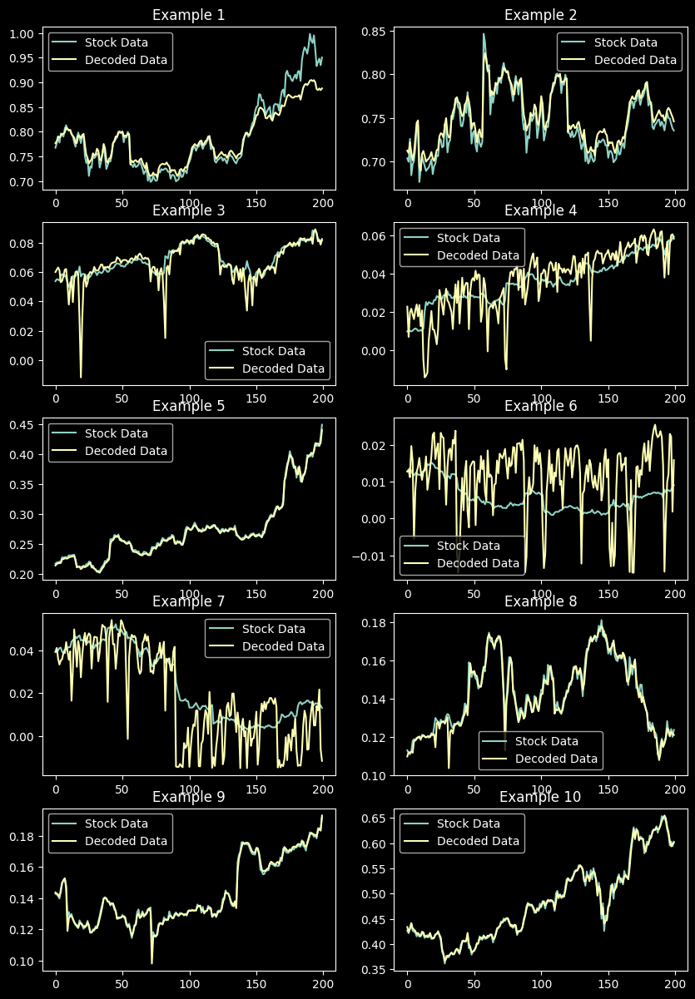

Epochs: 100 Latent Dim: 8 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/100
110/110 [==============================] - 1s 3ms/step - loss: 0.0713
Epoch 2/100
110/110 [==============================] - 0s 3ms/step - loss: 0.0439
Epoch 3/100
110/110 [==============================] - 1s 6ms/step - loss: 0.0246
Epoch 4/100
110/110 [==============================] - 0s 3ms/step - loss: 0.0081
Epoch 5/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0028
Epoch 6/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0019
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0016
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0015
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0014
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0013
Epoch 11/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0

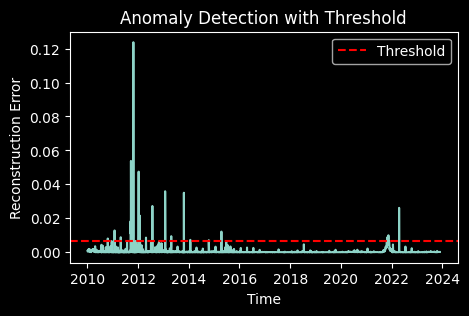

110/110 [==============================] - 0s 1ms/step


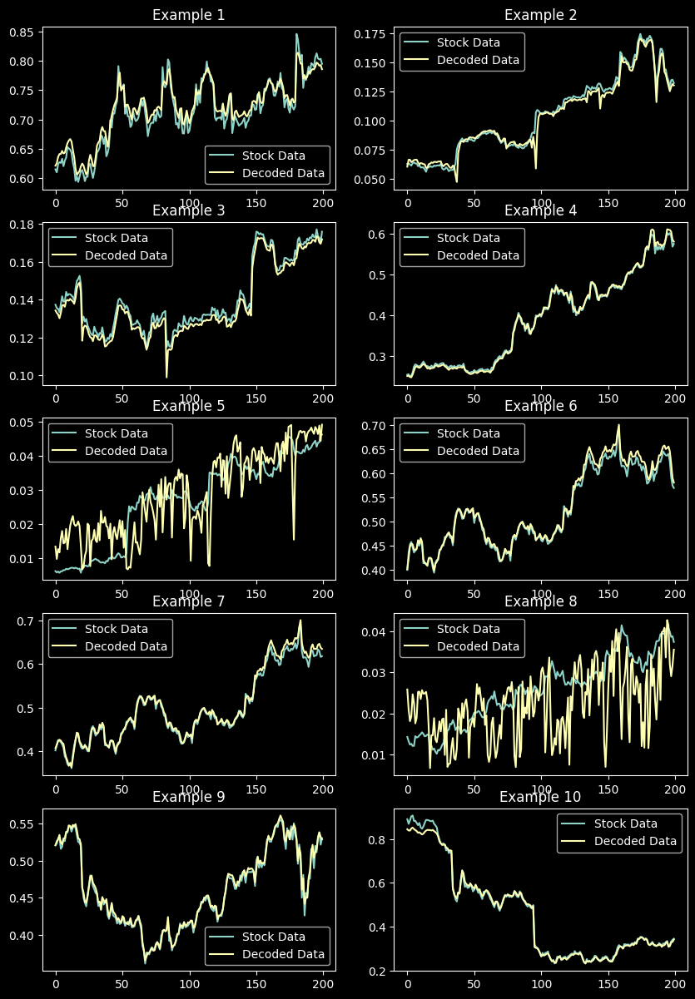

Epochs: 200 Latent Dim: 8 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/200
110/110 [==============================] - 1s 3ms/step - loss: 0.0739
Epoch 2/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0463
Epoch 3/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0295
Epoch 4/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0115
Epoch 5/200
110/110 [==============================] - 0s 3ms/step - loss: 0.0036
Epoch 6/200
110/110 [==============================] - 0s 3ms/step - loss: 0.0020
Epoch 7/200
110/110 [==============================] - 0s 3ms/step - loss: 0.0016
Epoch 8/200
110/110 [==============================] - 0s 3ms/step - loss: 0.0014
Epoch 9/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0013
Epoch 10/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0012
Epoch 11/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0

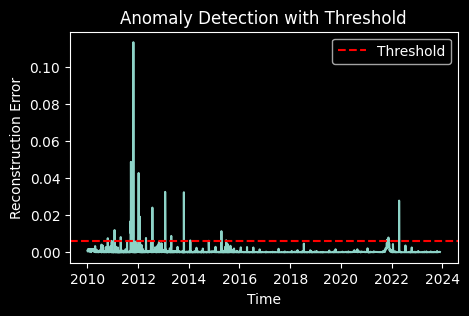

110/110 [==============================] - 0s 2ms/step


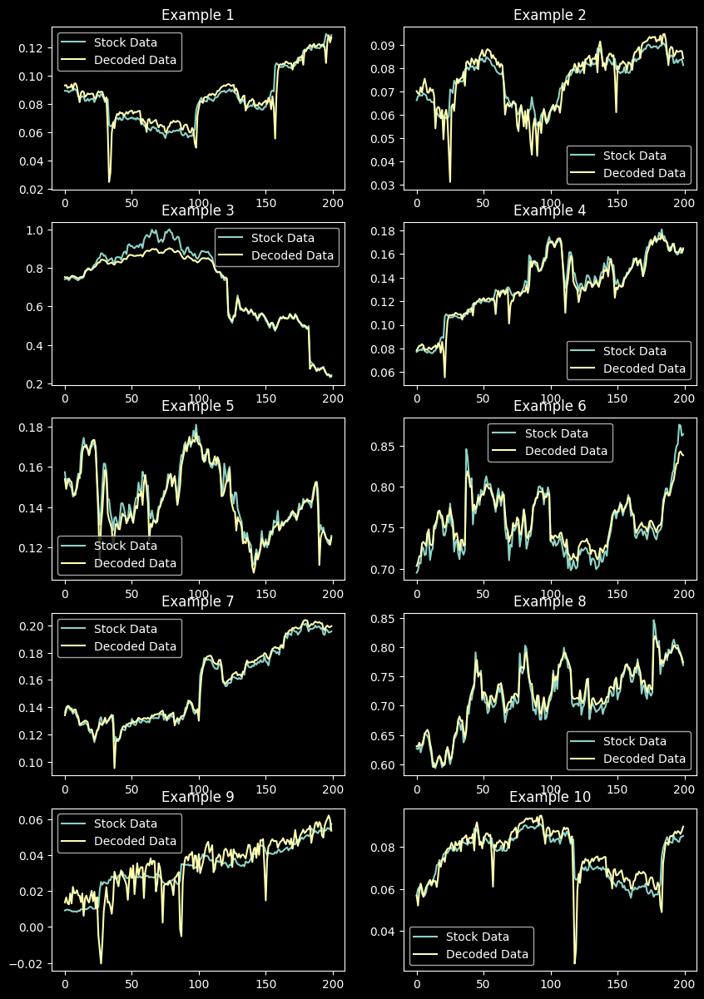

Epochs: 300 Latent Dim: 8 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.0713
Epoch 2/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0467
Epoch 3/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0328
Epoch 4/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0139
Epoch 5/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0041
Epoch 6/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0020
Epoch 7/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0016
Epoch 8/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0014
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0013
Epoch 10/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0012
Epoch 11/300
110/110 [==============================] - 0s 3ms/step - loss: 0.0

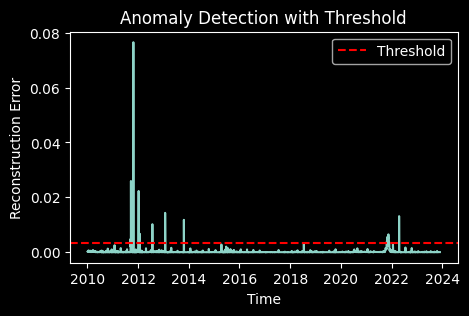

110/110 [==============================] - 0s 2ms/step


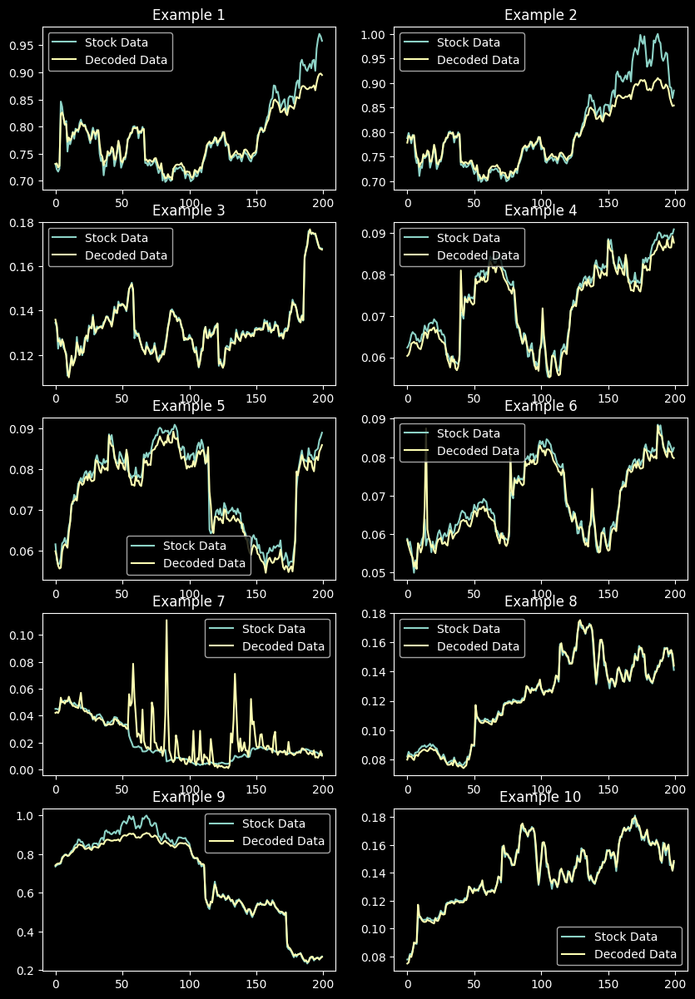

Epochs: 100 Latent Dim: 16 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/100
110/110 [==============================] - 1s 2ms/step - loss: 0.0722
Epoch 2/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0439
Epoch 3/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0270
Epoch 4/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0112
Epoch 5/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0040
Epoch 6/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0022
Epoch 7/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0017
Epoch 8/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0015
Epoch 9/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0014
Epoch 10/100
110/110 [==============================] - 0s 2ms/step - loss: 0.0013
Epoch 11/100
110/110 [==============================] - 0s 2ms/step - loss: 0.

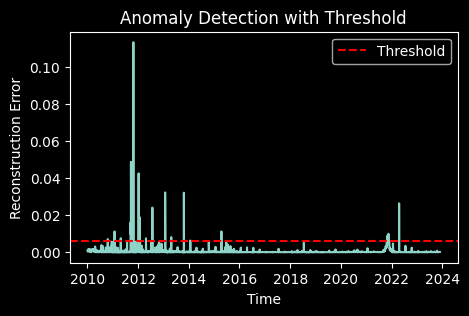

110/110 [==============================] - 0s 3ms/step


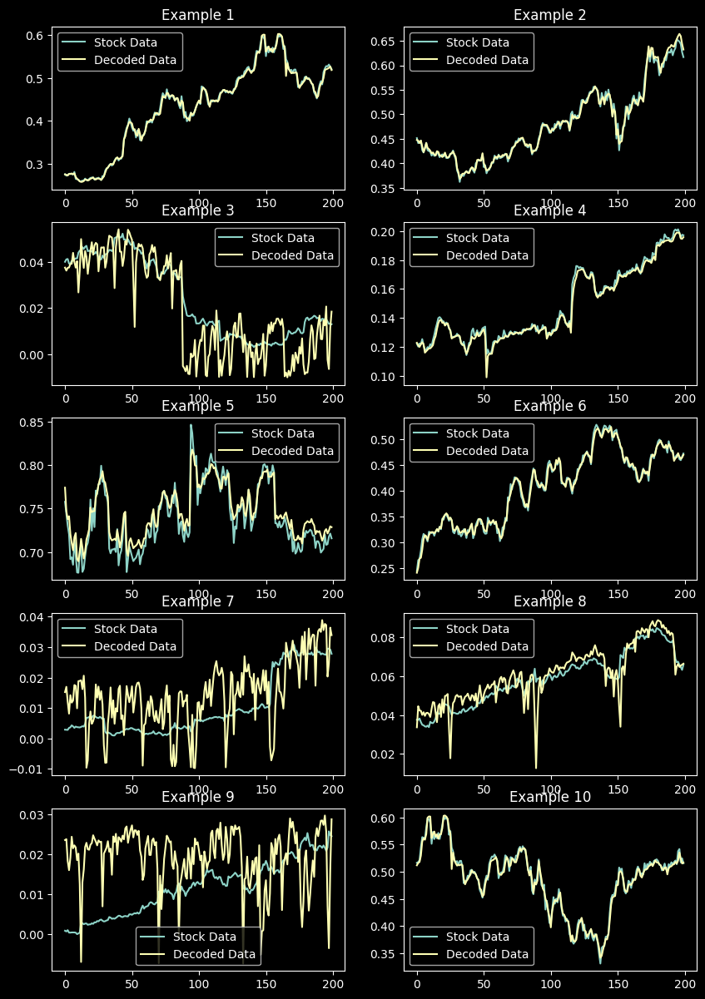

Epochs: 200 Latent Dim: 16 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/200
110/110 [==============================] - 1s 2ms/step - loss: 0.0745
Epoch 2/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0515
Epoch 3/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0388
Epoch 4/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0188
Epoch 5/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0058
Epoch 6/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0027
Epoch 7/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0019
Epoch 8/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0016
Epoch 9/200
110/110 [==============================] - 0s 2ms/step - loss: 0.0015
Epoch 10/200
110/110 [==============================] - 0s 3ms/step - loss: 0.0013
Epoch 11/200
110/110 [==============================] - 0s 2ms/step - loss: 0.

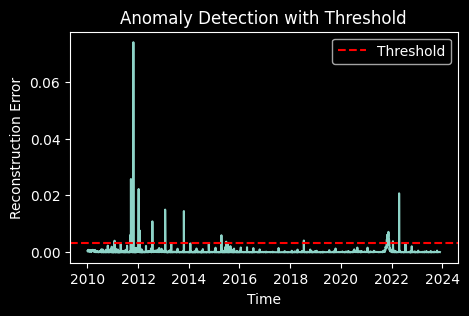

110/110 [==============================] - 0s 2ms/step


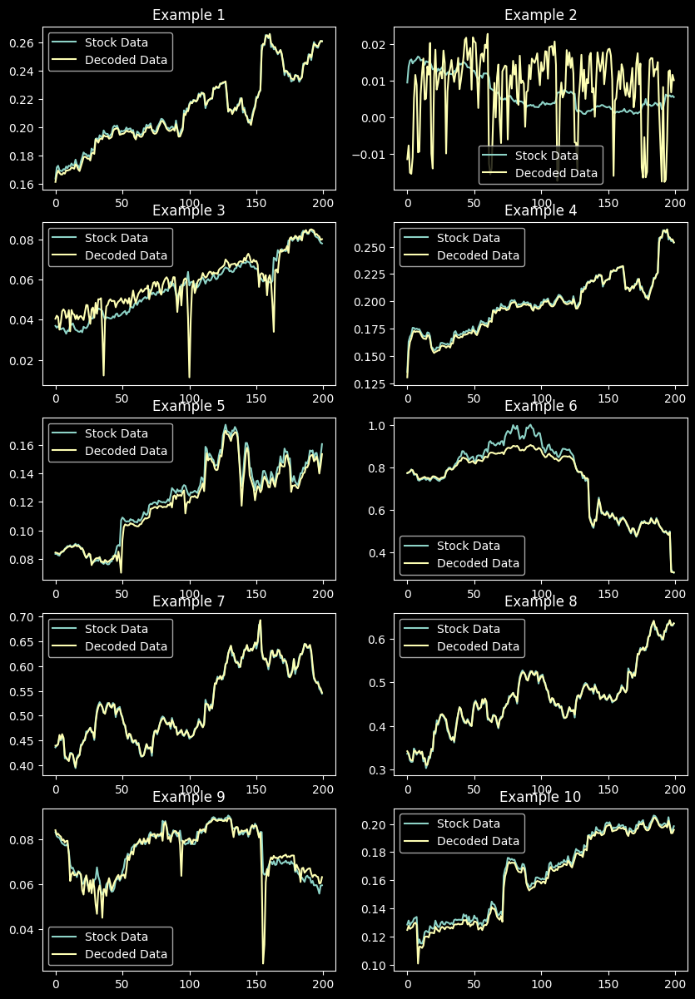

Epochs: 300 Latent Dim: 16 Optimizer: Adagrad, lr=0.01, initial_accumulator_value=0.1, epsilon=1e-07
Epoch 1/300
110/110 [==============================] - 1s 2ms/step - loss: 0.0728
Epoch 2/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0449
Epoch 3/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0272
Epoch 4/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0099
Epoch 5/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0033
Epoch 6/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0019
Epoch 7/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0016
Epoch 8/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0014
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0013
Epoch 10/300
110/110 [==============================] - 0s 2ms/step - loss: 0.0012
Epoch 11/300
110/110 [==============================] - 0s 2ms/step - loss: 0.

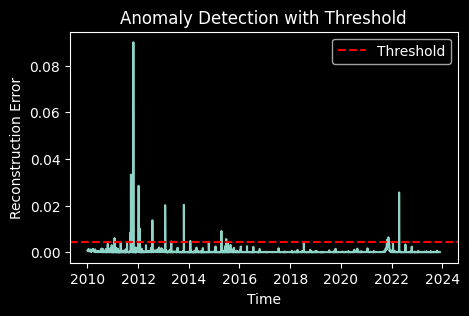

110/110 [==============================] - 0s 2ms/step


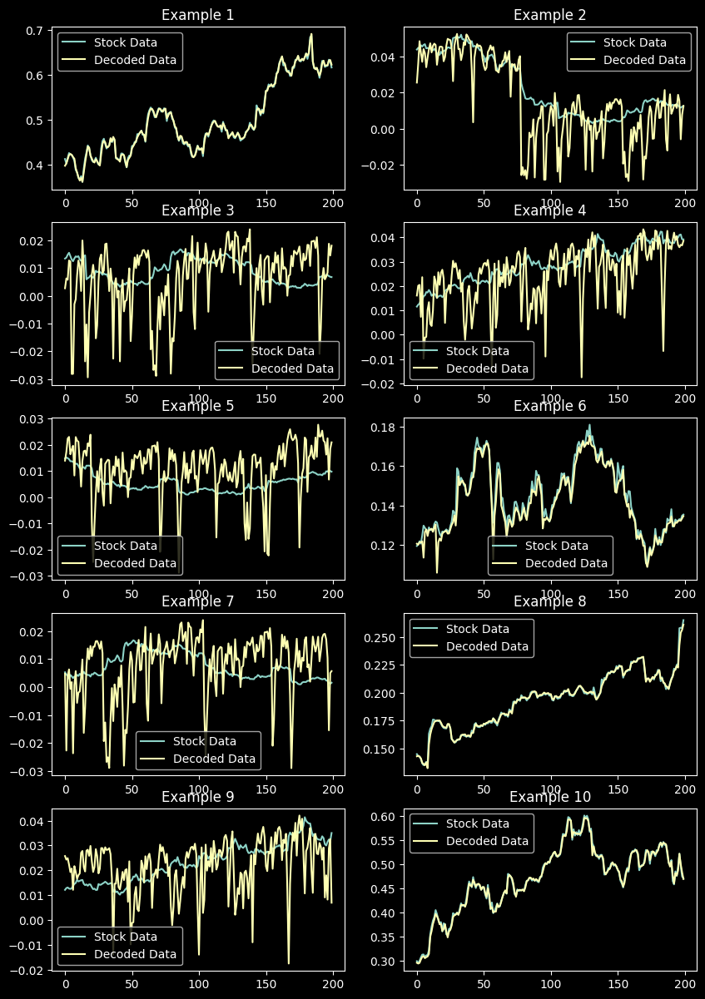

In [40]:
for opt in optimizers:
    for latent_dim in latent_dims:
        for epoch in epochs:
            print(
                "Epochs:",
                epoch,
                "Latent Dim:",
                latent_dim,
                "Optimizer:",
                opt[1],
            )
            model = create_model(
                latent_dims=latent_dim, loss=loss, optimizer=opt[0], input_dim=6
            )
            model.fit(train_data, train_data, epochs=epoch)
            evaluate(model, train_data)
            plt.show()
            reconstructed_data = model.predict(train_data)
            plot_examples(train_data, reconstructed_data)
            plt.show()

In [41]:
model = create_model(latent_dims=16, loss="mean_squared_error", optimizer="adam", input_dim=6)
model.fit(train_data, train_data, epochs=300)


Epoch 1/300
110/110 [==============================] - 2s 5ms/step - loss: 0.0116
Epoch 2/300
110/110 [==============================] - 0s 3ms/step - loss: 2.3572e-04
Epoch 3/300
110/110 [==============================] - 0s 2ms/step - loss: 1.1147e-04
Epoch 4/300
110/110 [==============================] - 0s 2ms/step - loss: 7.2133e-05
Epoch 5/300
110/110 [==============================] - 0s 3ms/step - loss: 5.4958e-05
Epoch 6/300
110/110 [==============================] - 0s 2ms/step - loss: 4.5230e-05
Epoch 7/300
110/110 [==============================] - 0s 2ms/step - loss: 3.7444e-05
Epoch 8/300
110/110 [==============================] - 0s 2ms/step - loss: 3.2757e-05
Epoch 9/300
110/110 [==============================] - 0s 2ms/step - loss: 3.4175e-05
Epoch 10/300
110/110 [==============================] - 0s 3ms/step - loss: 3.6672e-05
Epoch 11/300
110/110 [==============================] - 0s 2ms/step - loss: 2.6500e-05
Epoch 12/300
110/110 [==============================] -

110/110 [==============================] - 0s 1ms/step


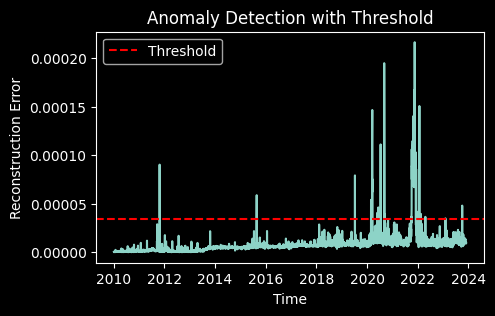

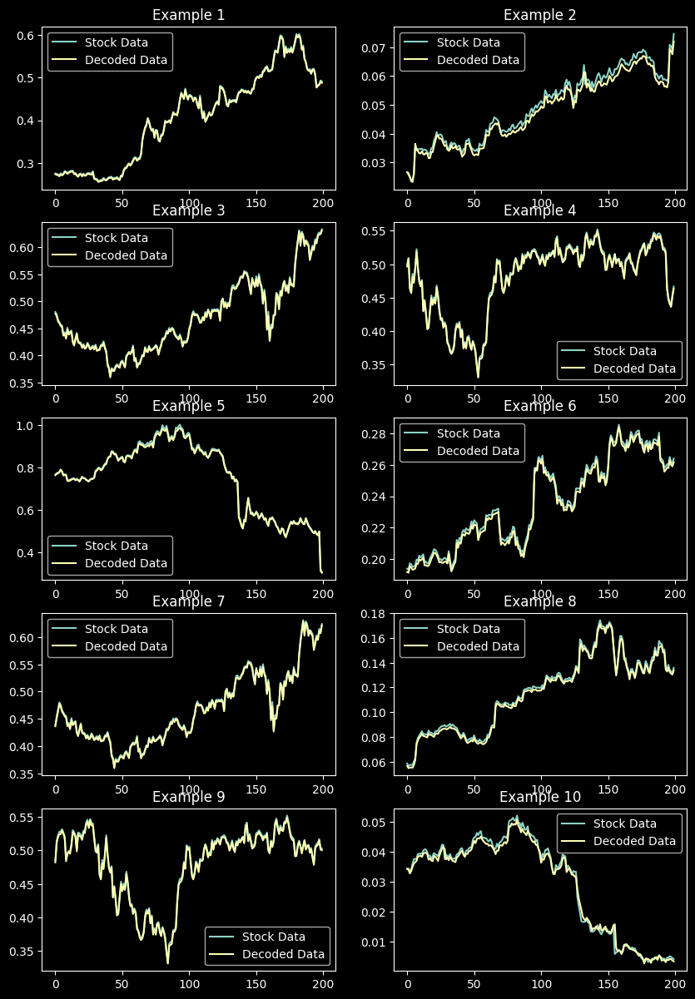

In [43]:
reconstructed_data = model.predict(train_data)

evaluate(model, train_data)
plt.show()

plot_examples(train_data, reconstructed_data)

In [46]:
model.save("Stock_Bottleneck.keras")